# LightGBM SIMPLE MODELS
This notebook presents the code corresponding to the training of the LightGBM model with covariates from Darts. Two models have been trained, one with MinMax scaling and the other with Standard scaling.

After training, both models are evaluated using their respective test sets, and the MinMax model is also evaluated with the specific test set.

In [ ]:
# We install darts
!pip install u8darts[torch] --quiet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.4/57.4 kB 5.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.3/46.3 kB 3.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 200.6/200.6 kB 21.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.1/823.1 kB 58.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 354.4/354.4 kB 31.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.7/101.7 kB 10.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 121.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 93.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 54.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
# Necessary imports to read the datasets
import pandas as pd
import zipfile
import os
import numpy as np
import matplotlib.pyplot as plt
import joblib
from darts import TimeSeries
from darts.models import LightGBMModel
from darts.dataprocessing.transformers import Scaler
from darts.utils.timeseries_generation import datetime_attribute_timeseries
from darts import concatenate

# We can ignore Darts library warnings
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import joblib

# Load the saved data
loaded_data = joblib.load('/content/drive/MyDrive/Colab Notebooks/TFG/data/01_datasets/train_test/scaled_train.pkl')

# Extract the components
scaled_train_series = loaded_data['train']        # dict of TimeSeries objects
scaled_val_series = loaded_data['validation']     # dict of TimeSeries objects
scalers = loaded_data['scalers']                  # dict of Scaler objects

# Get the sorted meter IDs (consistent order)
meter_ids = sorted(scaled_train_series.keys())

# Build aligned lists
train_series_scaled = [scaled_train_series[meter_id] for meter_id in meter_ids]
val_series_scaled = [scaled_val_series[meter_id] for meter_id in meter_ids]

print(f"Loaded {len(train_series_scaled)} time series for training.")
print(f"Loaded {len(val_series_scaled)} time series for validation.")

Loaded 908 time series for training.
Loaded 908 time series for validation.


In [ ]:
from darts import TimeSeries
from darts.utils.timeseries_generation import datetime_attribute_timeseries
from darts import concatenate
import pandas as pd

# We define the list of holidays in Catalonia during 2022 and 2023
holiday_dates = pd.to_datetime([
    # 2022
    "2022-01-01", "2022-01-06", "2022-04-15", "2022-04-18", "2022-05-01", "2022-06-06",
    "2022-06-24", "2022-08-15", "2022-09-11", "2022-09-24", "2022-10-12", "2022-11-01",
    "2022-12-06", "2022-12-08", "2022-12-25", "2022-12-26",
    # 2023
    "2023-01-01", "2023-01-06", "2023-04-07", "2023-04-10", "2023-05-01", "2023-05-29",
    "2023-06-24", "2023-08-15", "2023-09-11", "2023-09-24", "2023-10-12", "2023-11-01",
    "2023-12-06", "2023-12-08", "2023-12-25", "2023-12-26"
])

# We define the complete date range for our dataset
date_range = pd.date_range(start='2022-01-01', end='2023-12-31')

# We create a binary holiday series where 1 indicates a holiday and 0 otherwise
holiday_series = pd.Series(0, index=date_range)
holiday_series.loc[holiday_dates.intersection(date_range)] = 1
holiday_timeseries = TimeSeries.from_series(holiday_series.rename("is_holiday"))

# We create a binary series indicating whether each date is a weekend (Saturday or Sunday)
is_weekend_series = pd.Series((date_range.weekday >= 5).astype(int), index=date_range)
is_weekend_timeseries = TimeSeries.from_series(is_weekend_series.rename("is_weekend"))

# We create a normalized day-of-year series (scaled to [0, 1])
day_of_year_norm = pd.Series(date_range.dayofyear / 365, index=date_range)
day_of_year_timeseries = TimeSeries.from_series(day_of_year_norm.rename("day_of_year_norm"))

# We initialize the lists that will hold the final future covariates for training and validation
future_covariates_train = []
future_covariates_val = []

# For each meter, we create the full set of calendar-based future covariates
for train_ts, val_ts in zip(train_series_scaled, val_series_scaled):
    # We concatenate day of week (one-hot), month (one-hot), is_weekend, is_holiday, and day_of_year_norm for the training period
    train_cov = concatenate([
        datetime_attribute_timeseries(train_ts, "day_of_week", one_hot=True),
        datetime_attribute_timeseries(train_ts, "month", one_hot=True),
        is_weekend_timeseries.slice_intersect(train_ts),
        holiday_timeseries.slice_intersect(train_ts),
        day_of_year_timeseries.slice_intersect(train_ts)
    ], axis=1)

    # We do the same for the validation period
    val_cov = concatenate([
        datetime_attribute_timeseries(val_ts, "day_of_week", one_hot=True),
        datetime_attribute_timeseries(val_ts, "month", one_hot=True),
        is_weekend_timeseries.slice_intersect(val_ts),
        holiday_timeseries.slice_intersect(val_ts),
        day_of_year_timeseries.slice_intersect(val_ts)
    ], axis=1)

    # We add the constructed covariate series to their respective lists
    future_covariates_train.append(train_cov)
    future_covariates_val.append(val_cov)


In [ ]:
# Initialize the model
from darts.models import LightGBMModel

model = LightGBMModel(
    lags=list(range(-1, -61, -1)),    # Uses the last 60 days
    lags_future_covariates=(60, 7),    # We use the same lags for covariates
    output_chunk_length=7,            # Forecast the next 7 days
    likelihood="quantile",            # Quantile regression
    quantiles=[0.05, 0.5, 0.95],
    random_state=42,
    n_estimators=300,
    num_leaves=31,
    max_depth=7,
    force_col_wise=True,
    verbosity=1,
    n_jobs=-1,
    early_stopping_round=30

)

In [ ]:
model.fit(
    series=train_series_scaled,
    future_covariates=future_covariates_train,
    val_series=val_series_scaled,
    val_future_covariates=future_covariates_val
)


[LightGBM] [Info] Total Bins 34558
[LightGBM] [Info] Number of data points in the train set: 271492, number of used features: 1448
[LightGBM] [Info] Start training from score 0.113387
Training until validation scores don't improve for 30 rounds
Early stopping, best iteration is:
[104]	valid_0's quantile: 0.00928184
[LightGBM] [Info] Total Bins 34558
[LightGBM] [Info] Number of data points in the train set: 271492, number of used features: 1448
[LightGBM] [Info] Start training from score 0.113051
Training until validation scores don't improve for 30 rounds
Early stopping, best iteration is:
[106]	valid_0's quantile: 0.0107072
[LightGBM] [Info] Total Bins 34558
[LightGBM] [Info] Number of data points in the train set: 271492, number of used features: 1448
[LightGBM] [Info] Start training from score 0.112670
Training until validation scores don't improve for 30 rounds
Early stopping, best iteration is:
[61]	valid_0's quantile: 0.0121261
[LightGBM] [Info] Total Bins 34558
[LightGBM] [Info]

LightGBMModel(lags=[-1, -2, -3, -4, -5, -6, -7, -8, -9, -10, -11, -12, -13, -14, -15, -16, -17, -18, -19, -20, -21, -22, -23, -24, -25, -26, -27, -28, -29, -30, -31, -32, -33, -34, -35, -36, -37, -38, -39, -40, -41, -42, -43, -44, -45, -46, -47, -48, -49, -50, -51, -52, -53, -54, -55, -56, -57, -58, -59, -60], lags_past_covariates=None, lags_future_covariates=(60, 7), output_chunk_length=7, output_chunk_shift=0, add_encoders=None, likelihood=quantile, quantiles=[0.05, 0.5, 0.95], random_state=42, multi_models=True, use_static_covariates=True, categorical_past_covariates=None, categorical_future_covariates=None, categorical_static_covariates=None, n_estimators=300, num_leaves=31, max_depth=7, force_col_wise=True, verbosity=1, n_jobs=-1, early_stopping_round=30)

In [ ]:
# --- Save model and scalers ---
model.save("/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/lightGBM/covariates/lightgbm_model_covariates.pkl")

In [ ]:
###################################### TRAINING DONE, NOW WE WILL TEST THE MODELS #################################




In [ ]:
from darts import concatenate, metrics
from darts.models import LightGBMModel
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)


In [ ]:
# Load model
model = LightGBMModel.load("/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/lightGBM/covariates/lightgbm_model_covariates.pkl")


In [ ]:
# We load the test data
test_data = joblib.load('/content/drive/MyDrive/Colab Notebooks/TFG/data/01_datasets/train_test/scaled_test.pkl')
print(test_data.keys())

dict_keys(['train', 'validation', 'calib_test', 'scalers'])


In [ ]:
# Extract components
scaled_calib_test_series = test_data['calib_test']
scalers_test = test_data['scalers']           # the scalers to reescale the series later

# Reuse the same sorted meter IDs to align
meter_ids_test = sorted(scaled_calib_test_series.keys())

# Build aligned lists
test_series_scaled = [scaled_calib_test_series[meter_id] for meter_id in meter_ids_test]

print(f"Loaded {len(test_series_scaled)} time series for testing.")

Loaded 60 time series for testing.


In [ ]:
# We build the future covariates for the test set
future_covariates_test = []

for test_ts in test_series_scaled:
    test_cov = concatenate([
        datetime_attribute_timeseries(test_ts, "day_of_week", one_hot=True),
        datetime_attribute_timeseries(test_ts, "month", one_hot=True),
        is_weekend_timeseries.slice_intersect(test_ts),
        holiday_timeseries.slice_intersect(test_ts),
        day_of_year_timeseries.slice_intersect(test_ts)
    ], axis=1)

    future_covariates_test.append(test_cov)


In [ ]:
import pandas as pd

# Constants
start_date = pd.Timestamp("2023-11-6")
quantiles = [0.05, 0.5, 0.95]
pred_kwargs={"predict_likelihood_parameters": True, "verbose": True}
q_interval = [(0.05, 0.95)]
q_range = [0.9]

# Prepare to collect results
all_hfcs = {}
all_bt_results = {}

# We loop over each time series (one per meter)
for meter_id, ts, fcov in zip(meter_ids_test, test_series_scaled, future_covariates_test):

    # Historical forecasts
    hfcs = model.historical_forecasts(
        series=ts,
        future_covariates=fcov,
        forecast_horizon=7,
        start=start_date,
        last_points_only=False,
        stride=7,
        retrain=False,
        **pred_kwargs,
    )

    scaler = scalers_test[meter_id]
    widths = []

    for forecast in hfcs:
        q05 = forecast["Consumption per meter_q0.05"]
        q95 = forecast["Consumption per meter_q0.95"]
        q05_orig = scaler.inverse_transform(q05)
        q95_orig = scaler.inverse_transform(q95)
        width = (q95_orig - q05_orig).values()
        widths.append(width)

    mean_width = np.mean([np.mean(w) for w in widths])


    # We backtest (evaluate) the generated predictions
    bt = model.backtest(
        series=ts,
        future_covariates=fcov,
        historical_forecasts=hfcs,
        last_points_only=False,
        metric=[metrics.mic, metrics.miw],
        metric_kwargs={"q_interval": q_interval},
        retrain=False,
    )
    df_results = pd.DataFrame({"Interval": q_range, "Coverage": bt[0], "Width": mean_width})

    # Store results
    all_hfcs[meter_id] = hfcs
    all_bt_results[meter_id] = df_results

# We combine results across meters
combined_results = pd.concat(all_bt_results.values(), keys=all_bt_results.keys())
combined_results.reset_index(level=1, drop=True, inplace=True)


historical forecasts: 100%|██████████| 1/1 [00:00<00:00, 22.88it/s]


In [ ]:
mean_coverage = combined_results["Coverage"].mean()
mean_width = combined_results["Width"].mean()

print(f"Mean Coverage: {mean_coverage:.4f}")
print(f"Mean Width: {mean_width:.4f}")


Mean Coverage: 0.8512
Mean Width: 6.1320


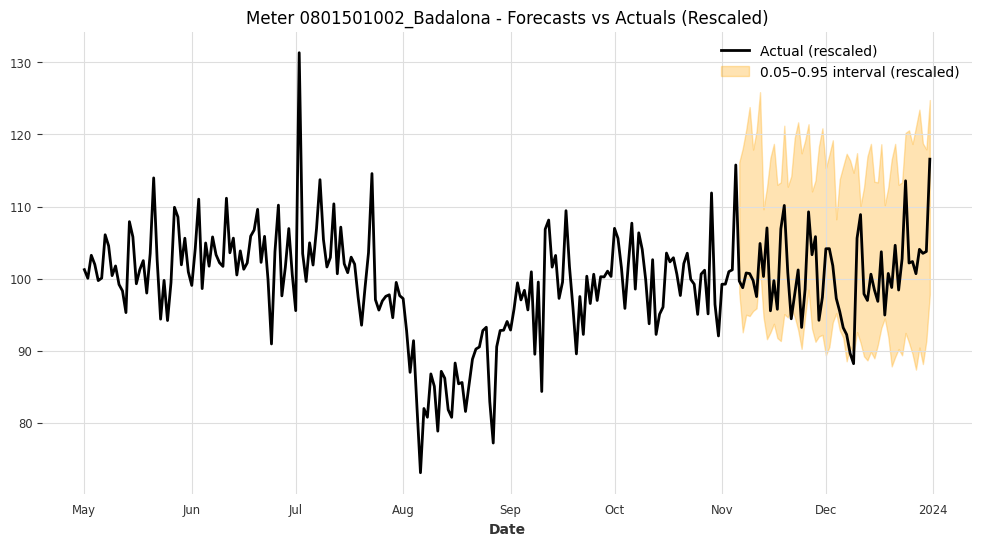

Meter 0801501002_Badalona - Coverage: 0.9464, Mean Interval Width (rescaled): 24.5731



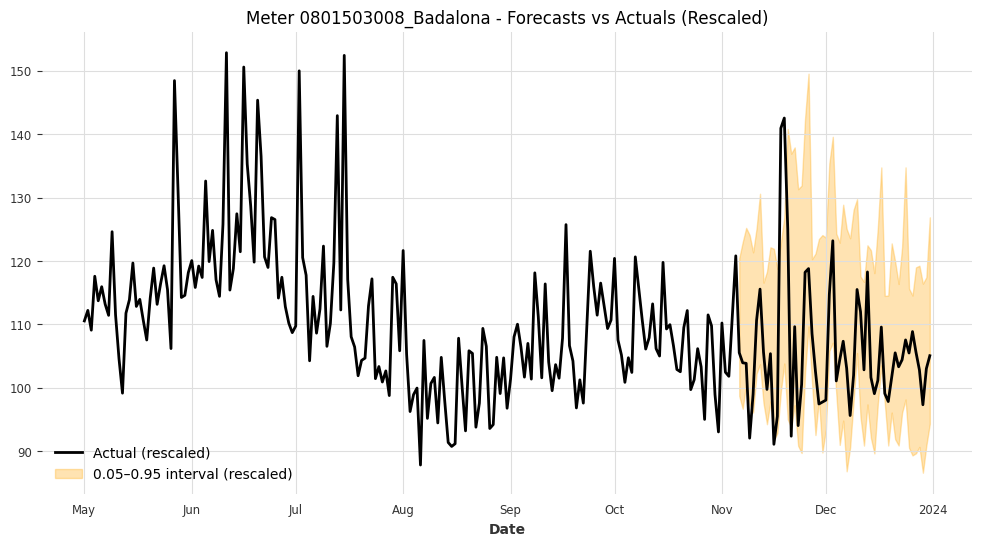

Meter 0801503008_Badalona - Coverage: 0.8929, Mean Interval Width (rescaled): 29.0190



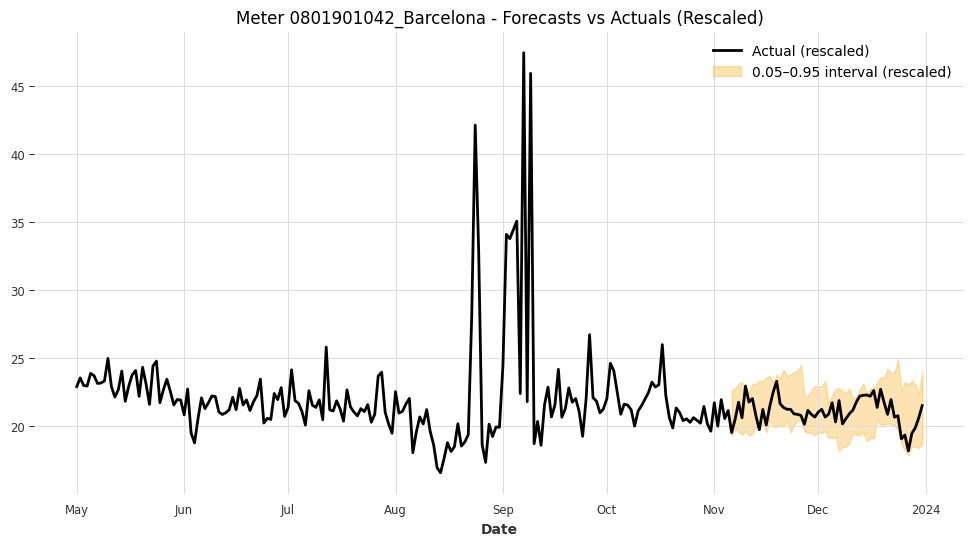

Meter 0801901042_Barcelona - Coverage: 0.9821, Mean Interval Width (rescaled): 3.6690



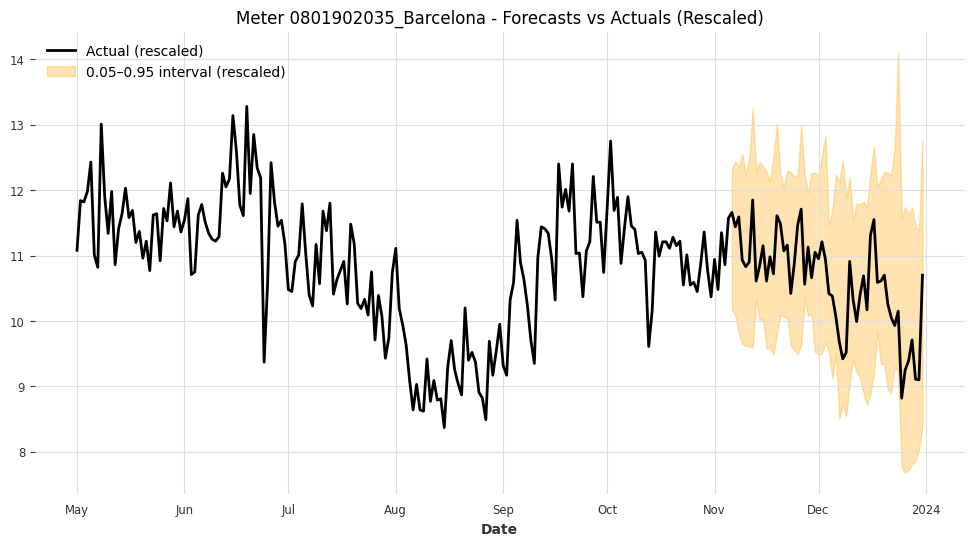

Meter 0801902035_Barcelona - Coverage: 1.0000, Mean Interval Width (rescaled): 2.9254



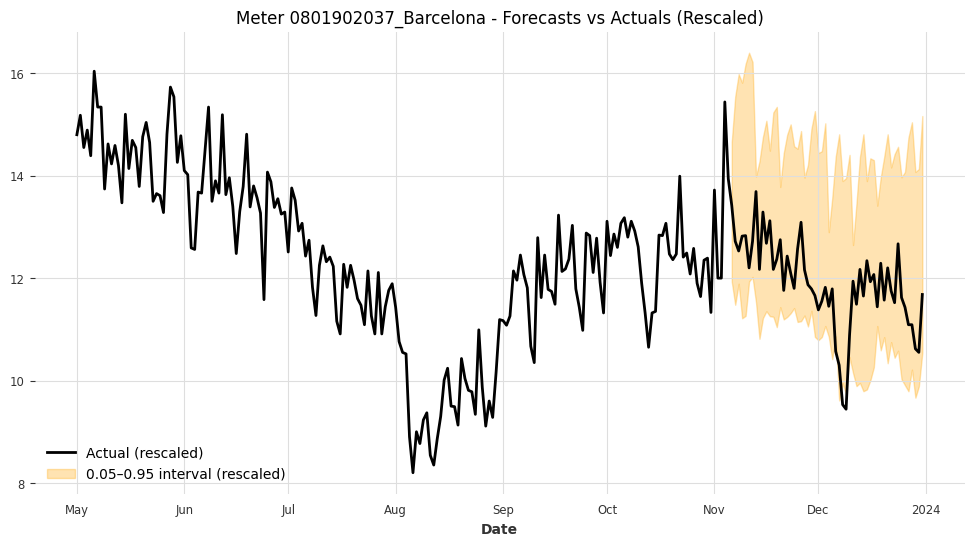

Meter 0801902037_Barcelona - Coverage: 0.9464, Mean Interval Width (rescaled): 3.7878



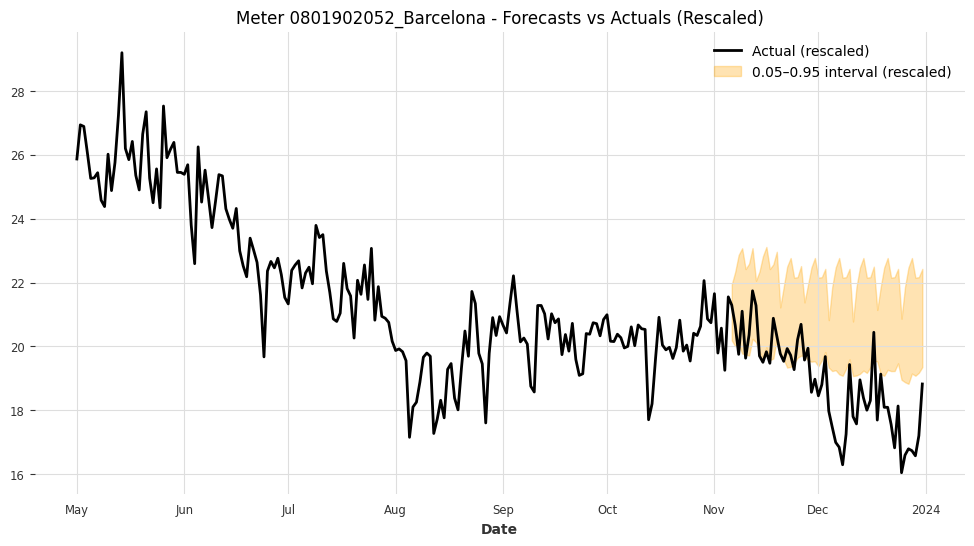

Meter 0801902052_Barcelona - Coverage: 0.2500, Mean Interval Width (rescaled): 2.7791



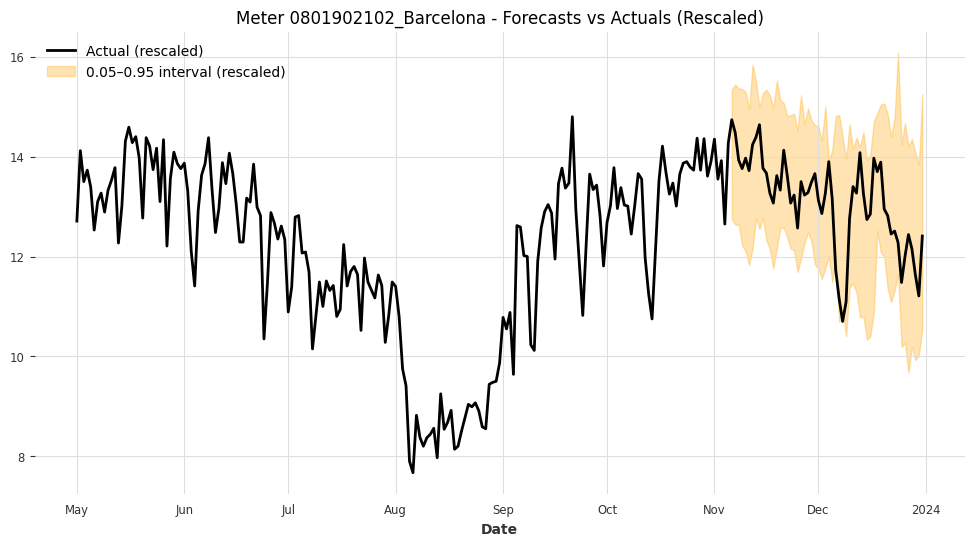

Meter 0801902102_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 3.1838



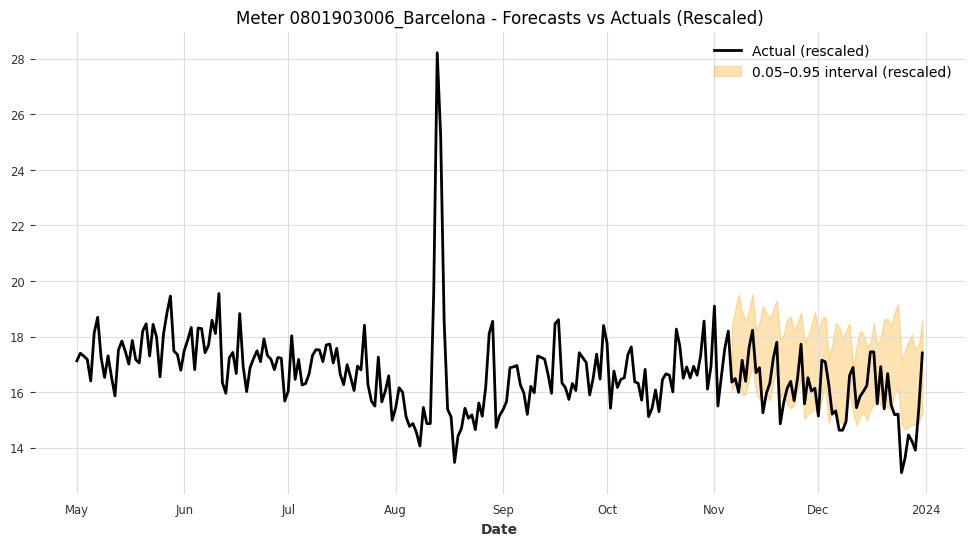

Meter 0801903006_Barcelona - Coverage: 0.6429, Mean Interval Width (rescaled): 2.7422



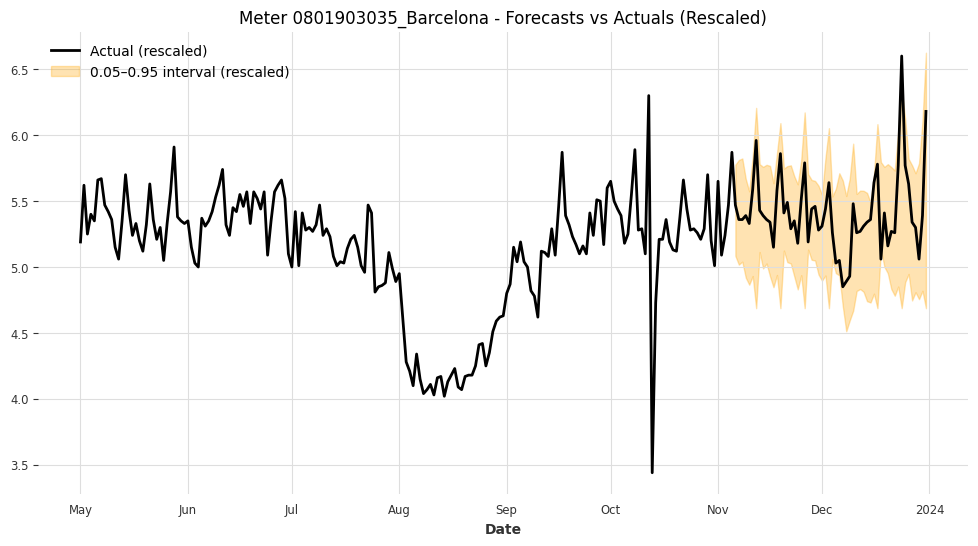

Meter 0801903035_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 0.9149



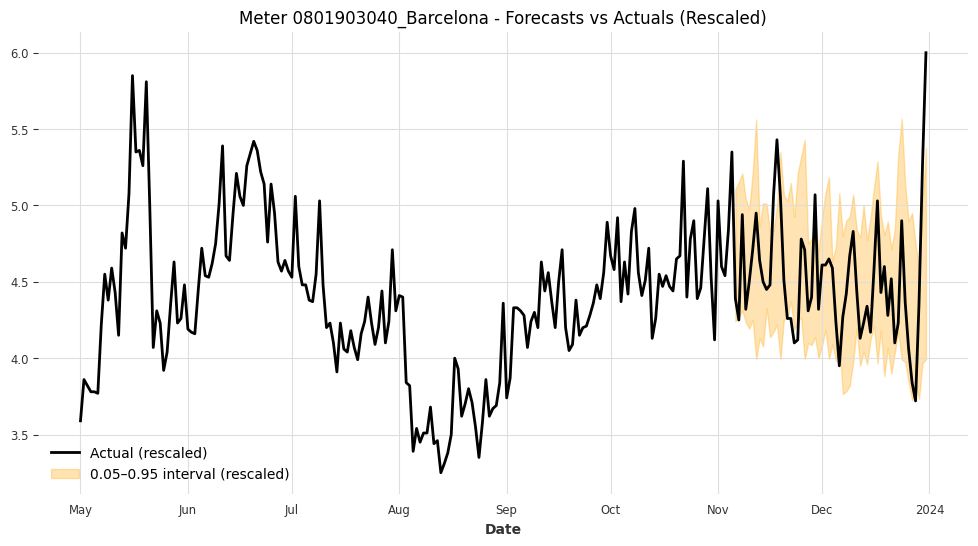

Meter 0801903040_Barcelona - Coverage: 0.7857, Mean Interval Width (rescaled): 0.9332



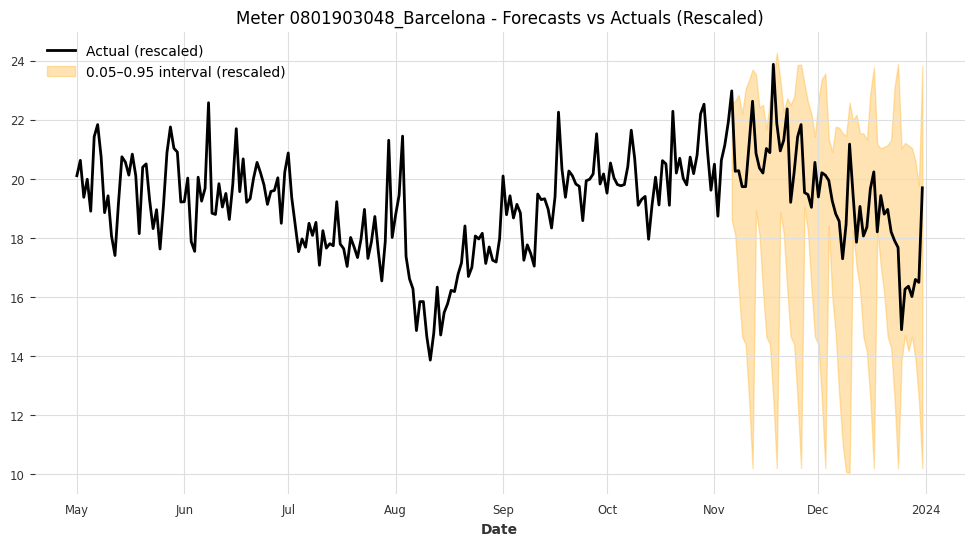

Meter 0801903048_Barcelona - Coverage: 0.9464, Mean Interval Width (rescaled): 7.7692



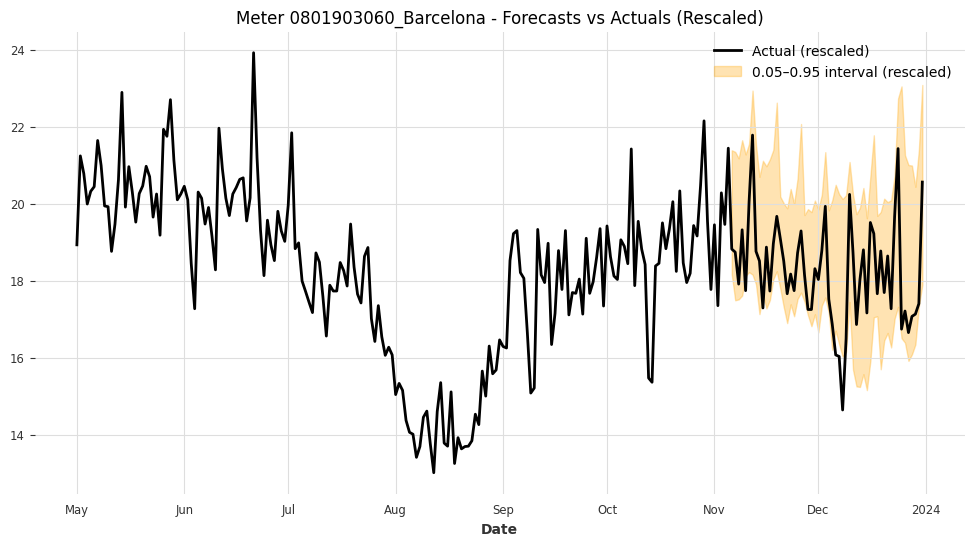

Meter 0801903060_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 3.8221



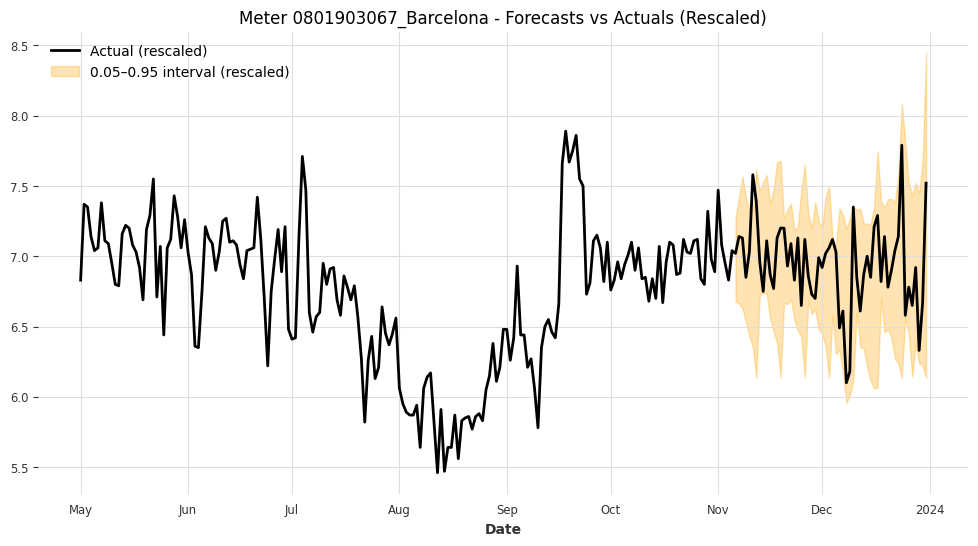

Meter 0801903067_Barcelona - Coverage: 0.9821, Mean Interval Width (rescaled): 1.0329



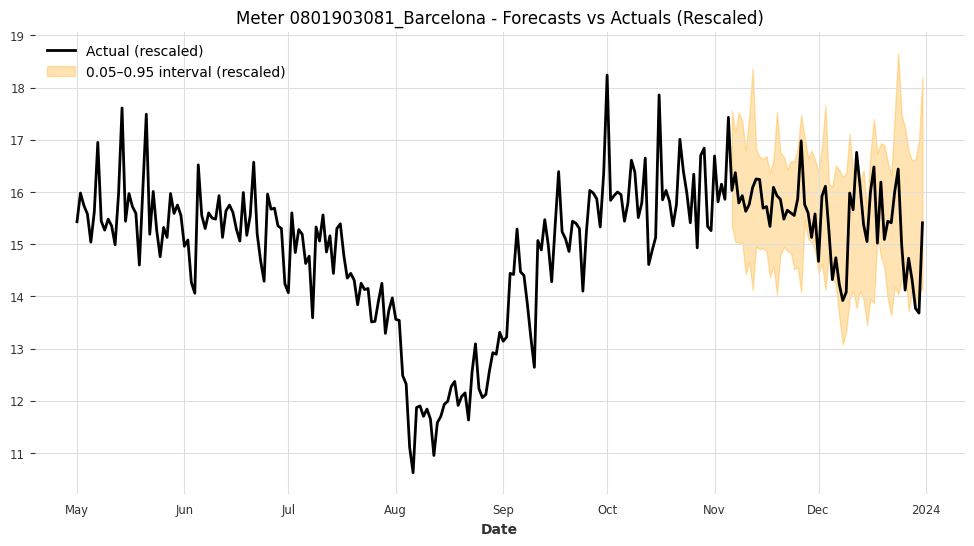

Meter 0801903081_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 2.4741



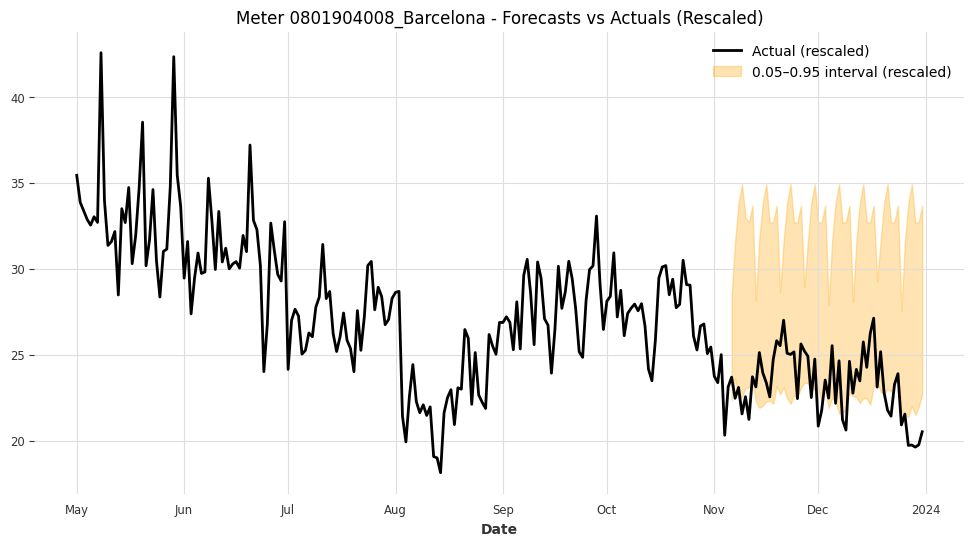

Meter 0801904008_Barcelona - Coverage: 0.6250, Mean Interval Width (rescaled): 9.9994



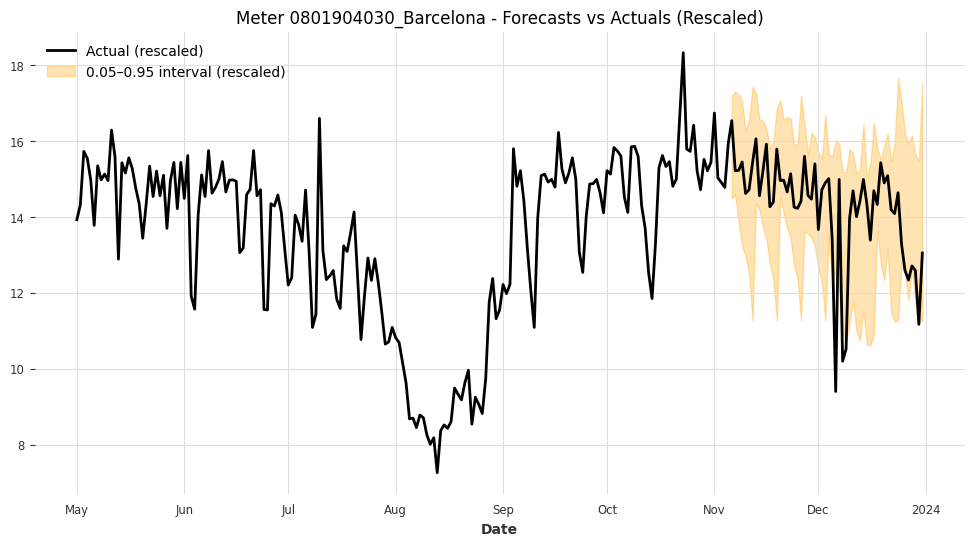

Meter 0801904030_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 3.7615



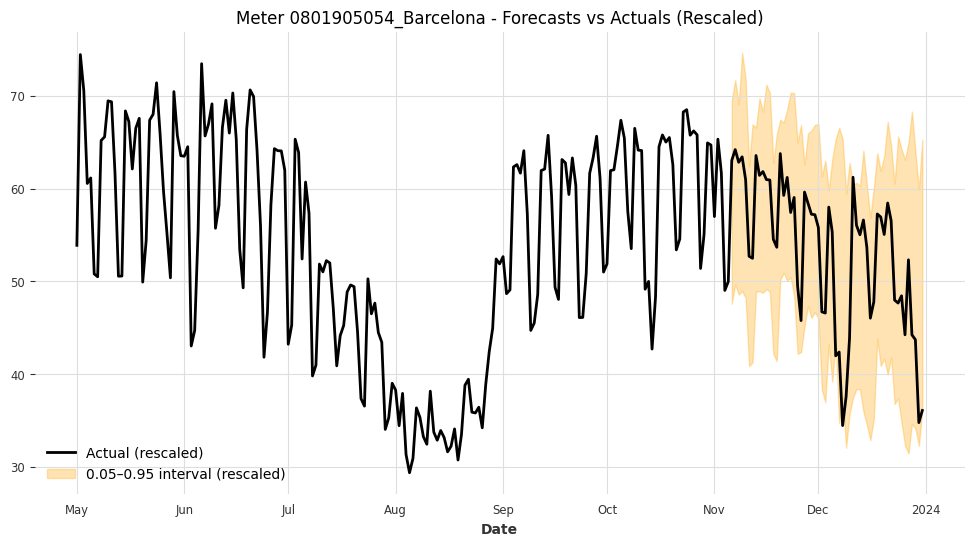

Meter 0801905054_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 23.5707



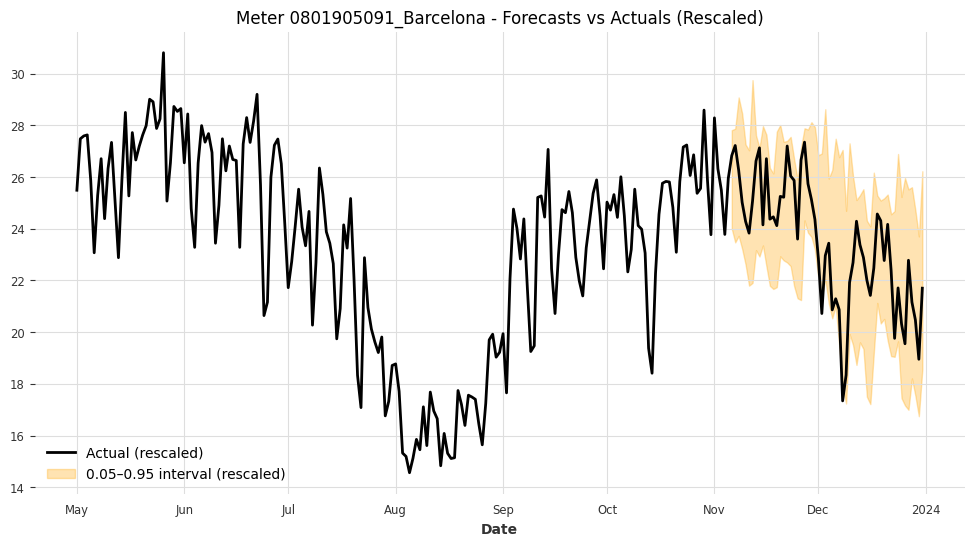

Meter 0801905091_Barcelona - Coverage: 0.9464, Mean Interval Width (rescaled): 5.7838



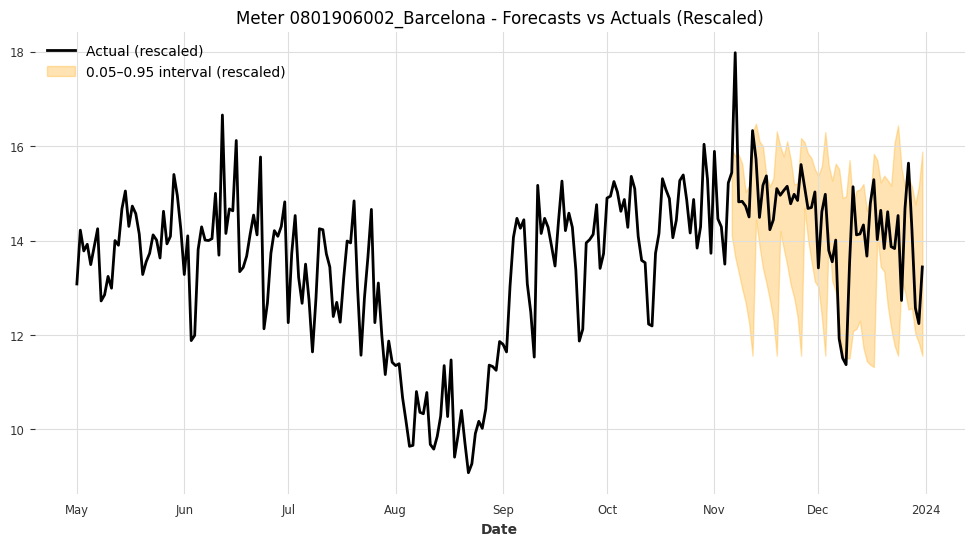

Meter 0801906002_Barcelona - Coverage: 0.8036, Mean Interval Width (rescaled): 2.8505



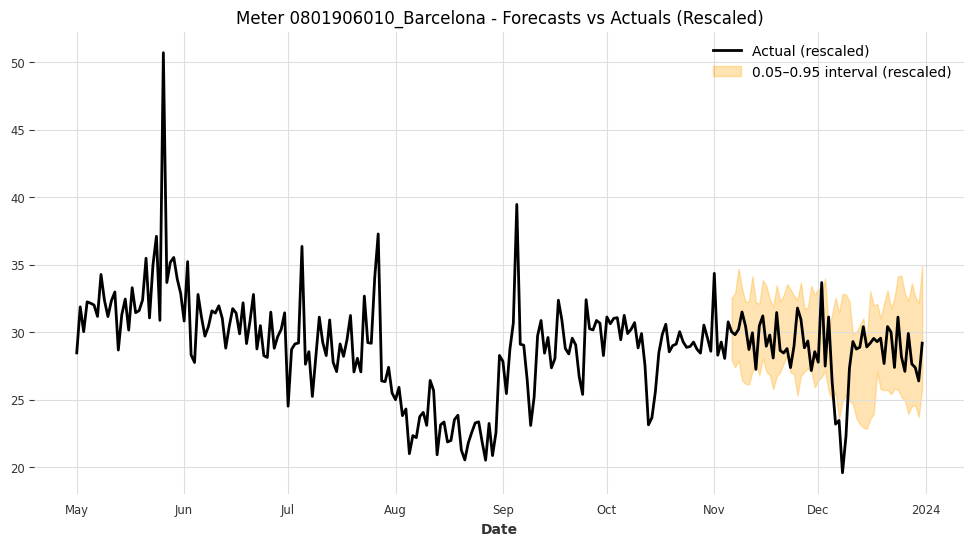

Meter 0801906010_Barcelona - Coverage: 0.8750, Mean Interval Width (rescaled): 6.6499



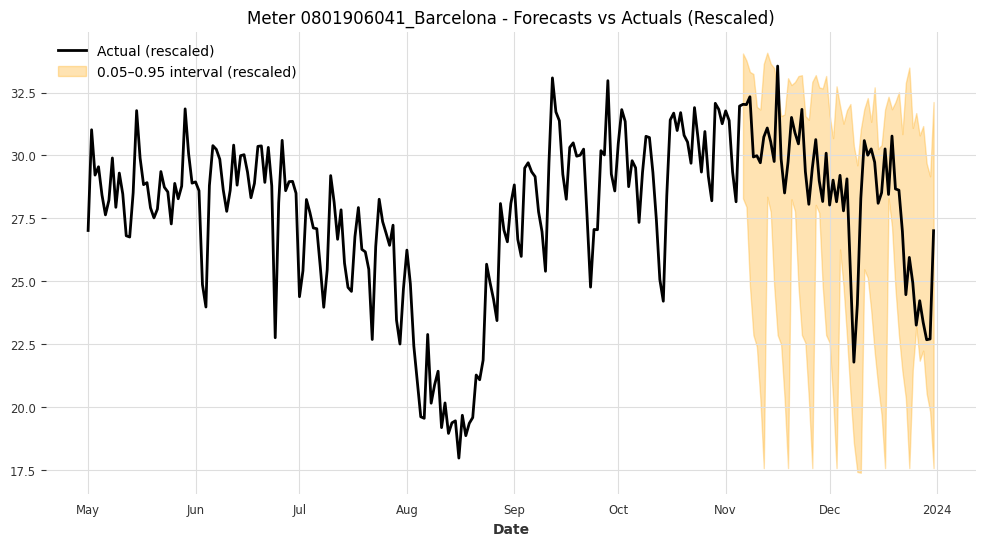

Meter 0801906041_Barcelona - Coverage: 0.9821, Mean Interval Width (rescaled): 9.4398



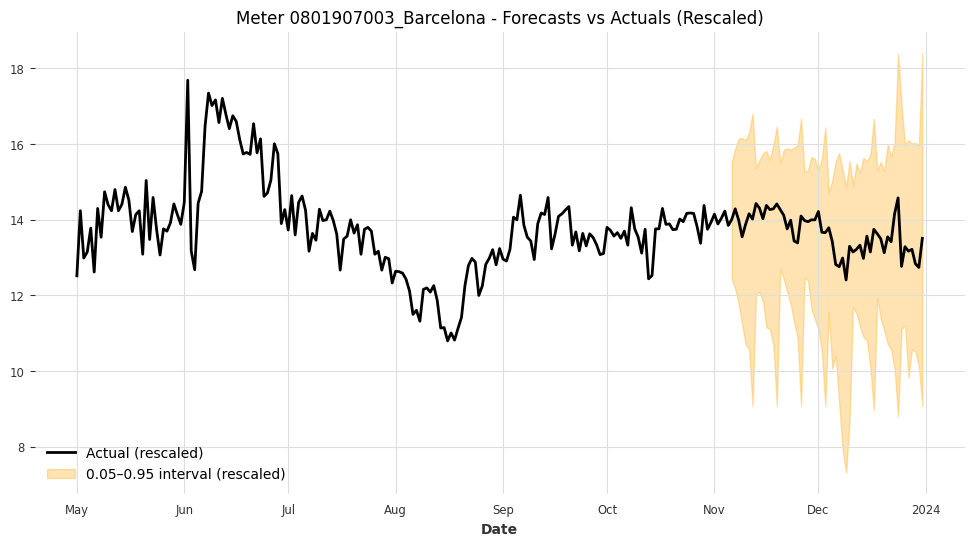

Meter 0801907003_Barcelona - Coverage: 1.0000, Mean Interval Width (rescaled): 5.1098



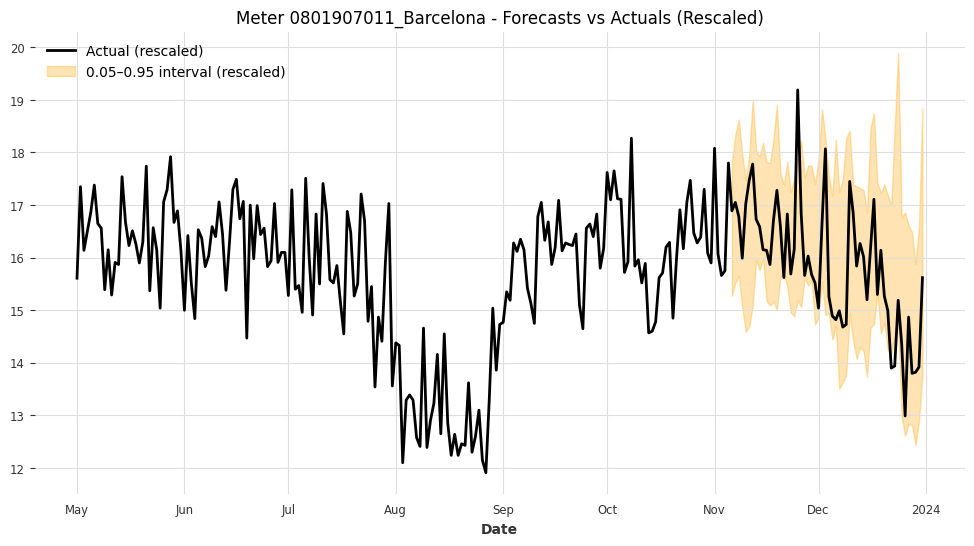

Meter 0801907011_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 3.0981



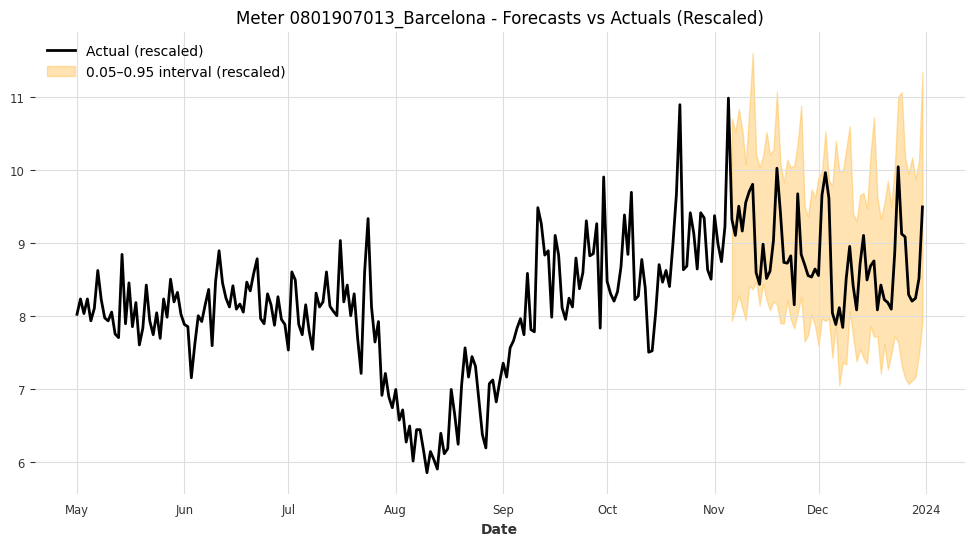

Meter 0801907013_Barcelona - Coverage: 1.0000, Mean Interval Width (rescaled): 2.3727



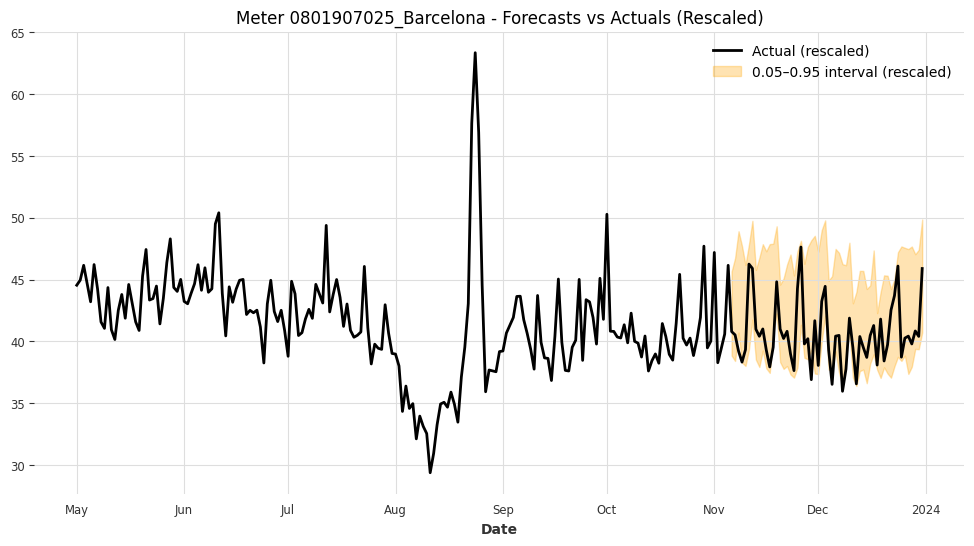

Meter 0801907025_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 8.1661



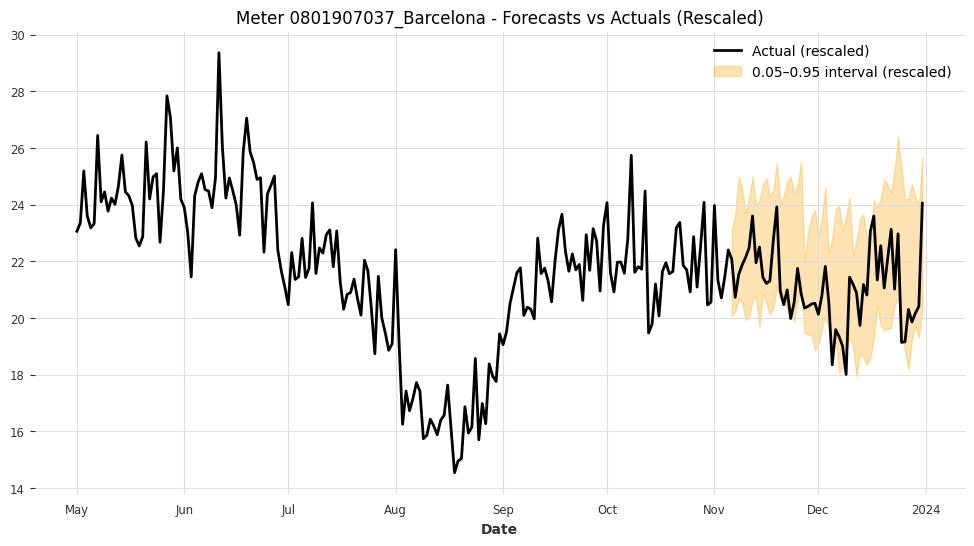

Meter 0801907037_Barcelona - Coverage: 0.8750, Mean Interval Width (rescaled): 4.4025



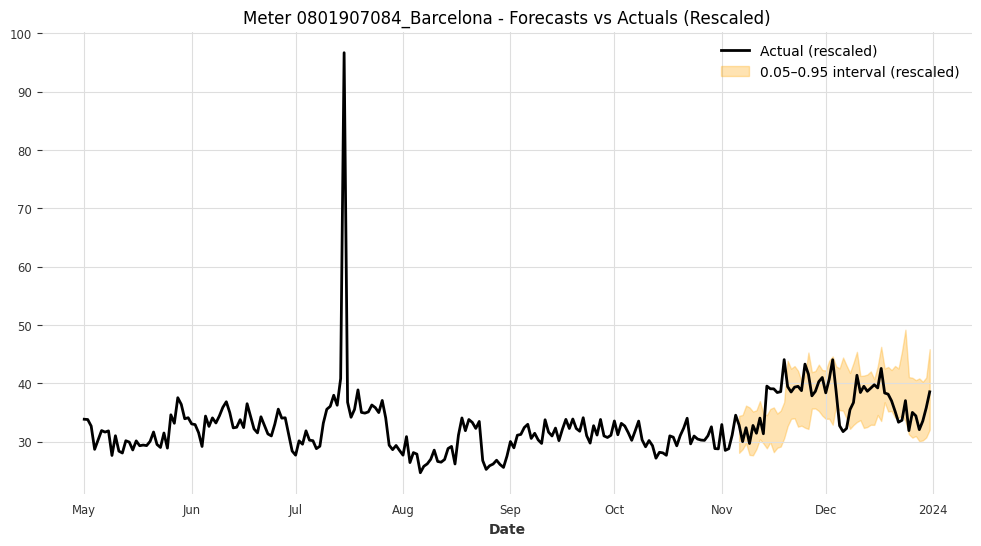

Meter 0801907084_Barcelona - Coverage: 0.7857, Mean Interval Width (rescaled): 8.6231



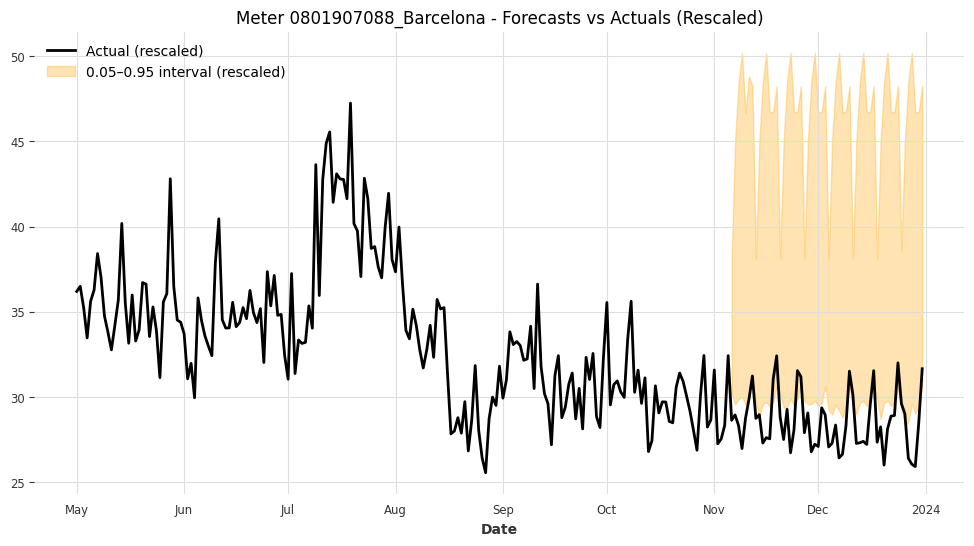

Meter 0801907088_Barcelona - Coverage: 0.2321, Mean Interval Width (rescaled): 16.5936



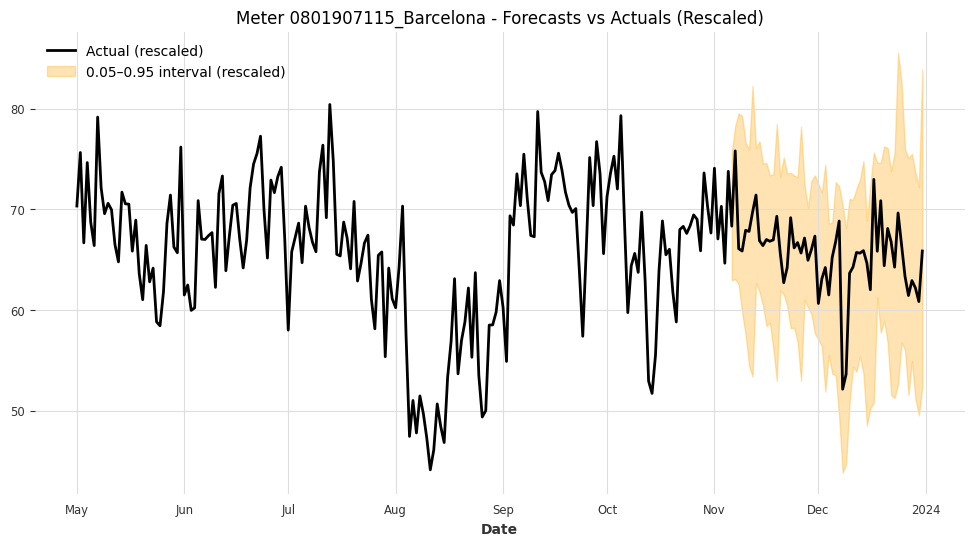

Meter 0801907115_Barcelona - Coverage: 1.0000, Mean Interval Width (rescaled): 18.9047



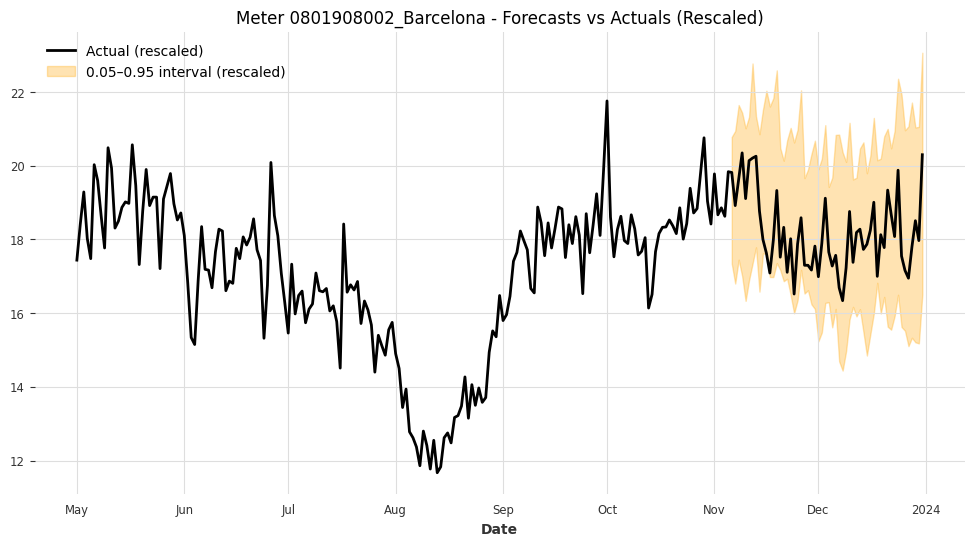

Meter 0801908002_Barcelona - Coverage: 1.0000, Mean Interval Width (rescaled): 4.6717



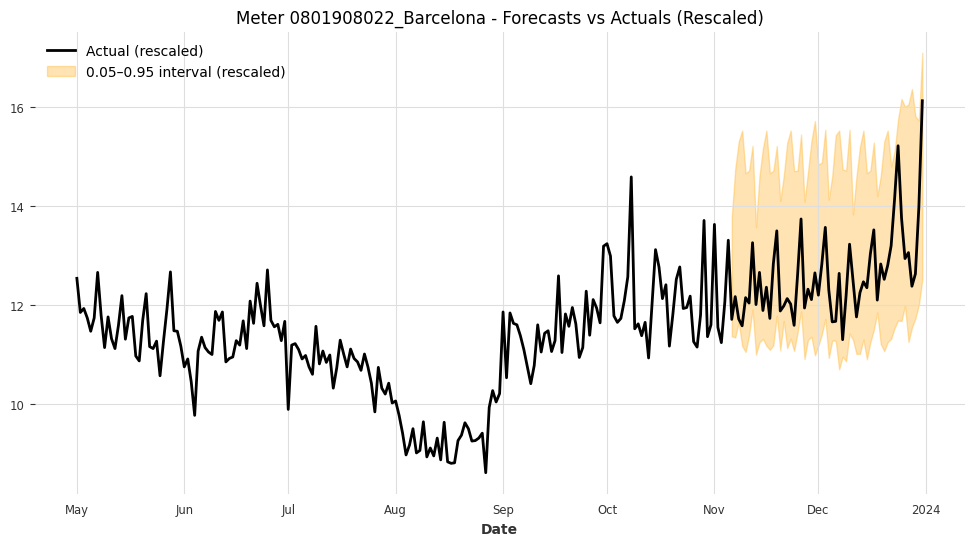

Meter 0801908022_Barcelona - Coverage: 1.0000, Mean Interval Width (rescaled): 3.7231



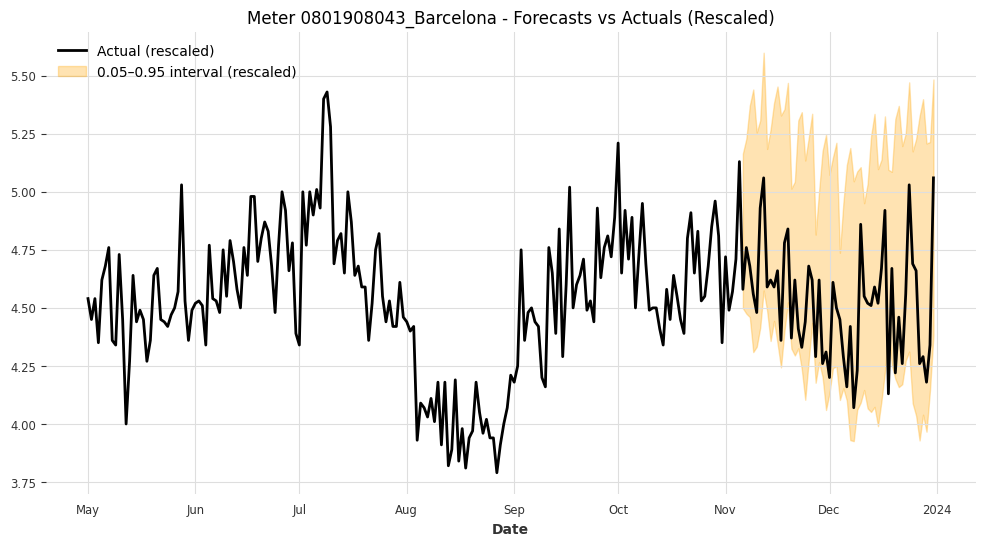

Meter 0801908043_Barcelona - Coverage: 0.9821, Mean Interval Width (rescaled): 0.9907



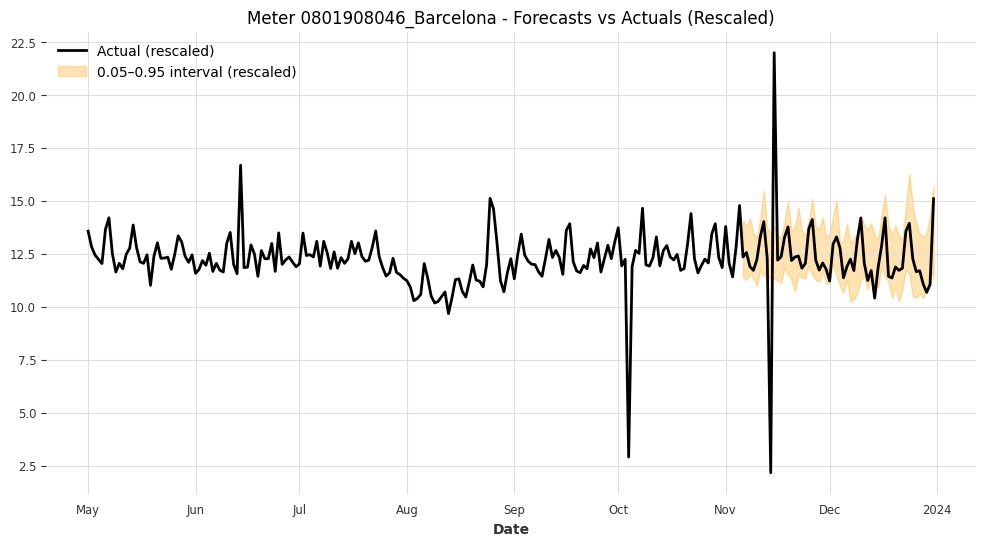

Meter 0801908046_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 2.7455



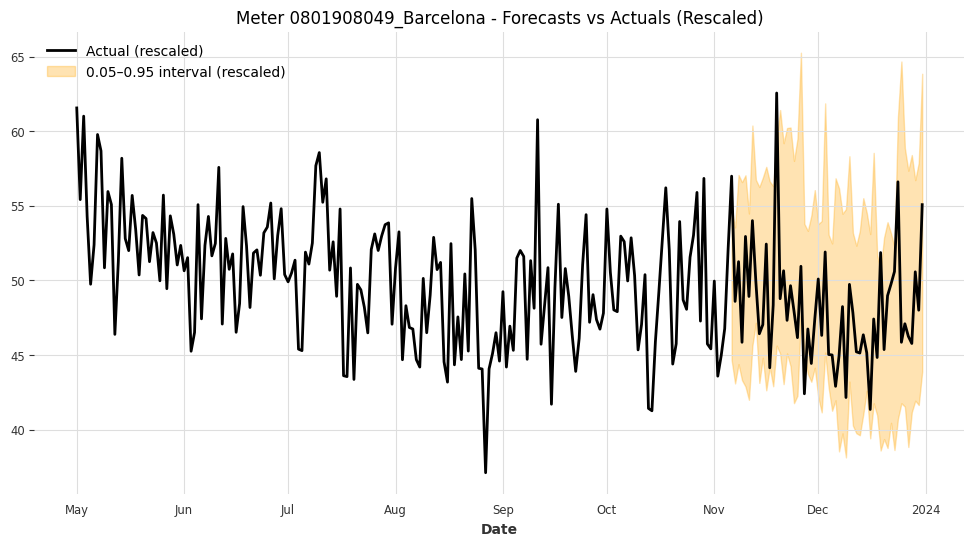

Meter 0801908049_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 14.2124



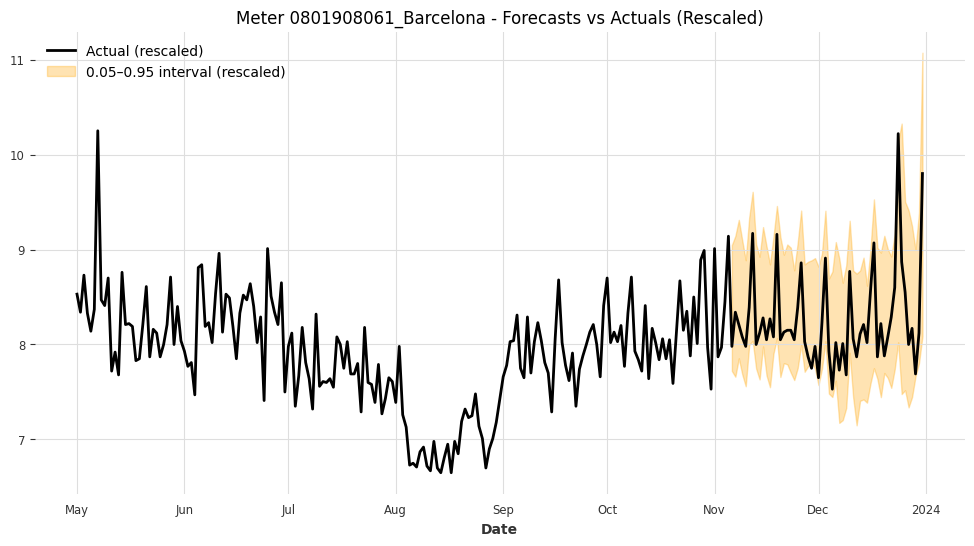

Meter 0801908061_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 1.4629



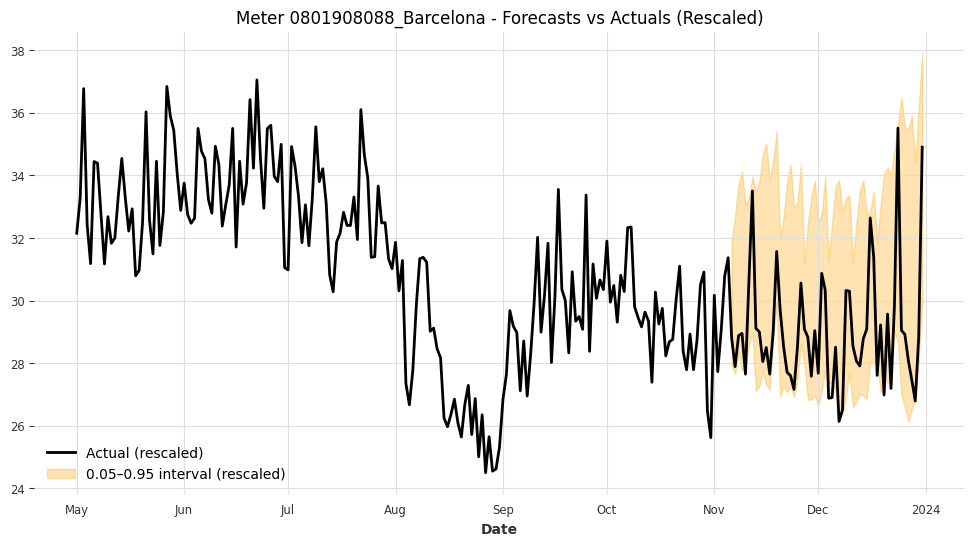

Meter 0801908088_Barcelona - Coverage: 0.8571, Mean Interval Width (rescaled): 6.2034



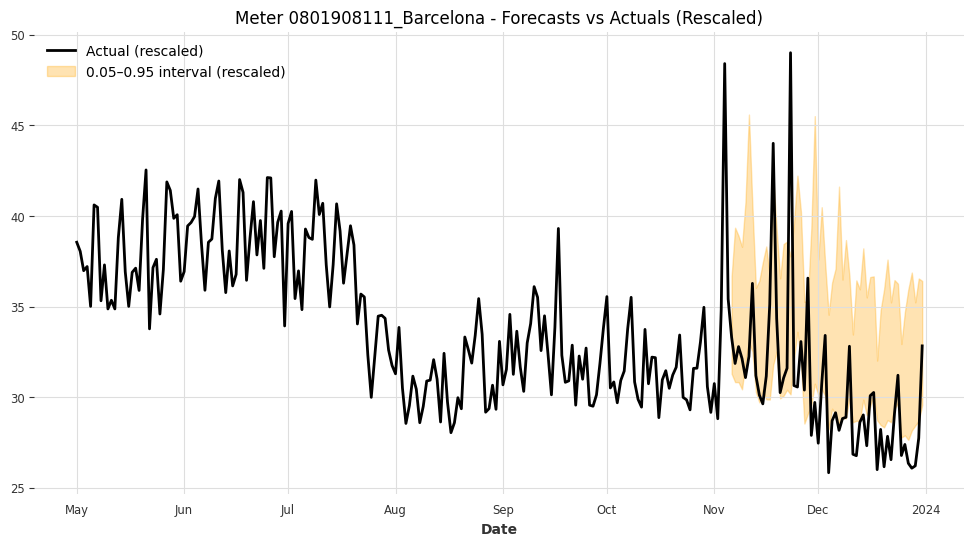

Meter 0801908111_Barcelona - Coverage: 0.4286, Mean Interval Width (rescaled): 7.7221



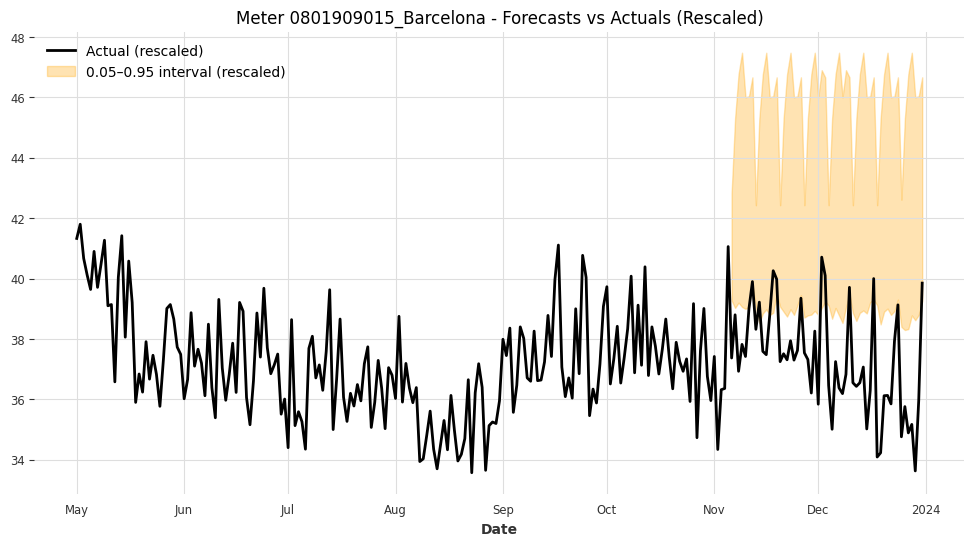

Meter 0801909015_Barcelona - Coverage: 0.1607, Mean Interval Width (rescaled): 6.9154



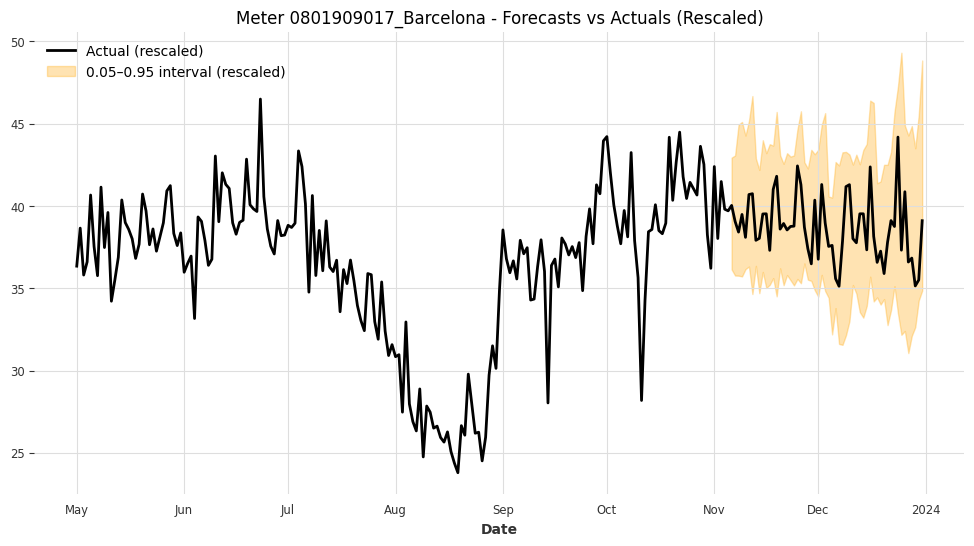

Meter 0801909017_Barcelona - Coverage: 1.0000, Mean Interval Width (rescaled): 9.4067



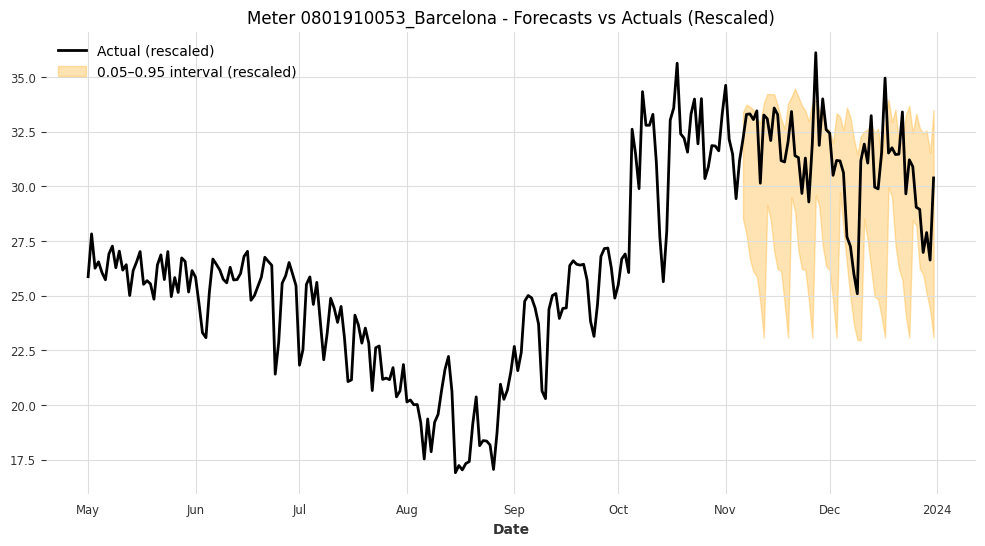

Meter 0801910053_Barcelona - Coverage: 0.8750, Mean Interval Width (rescaled): 6.9378



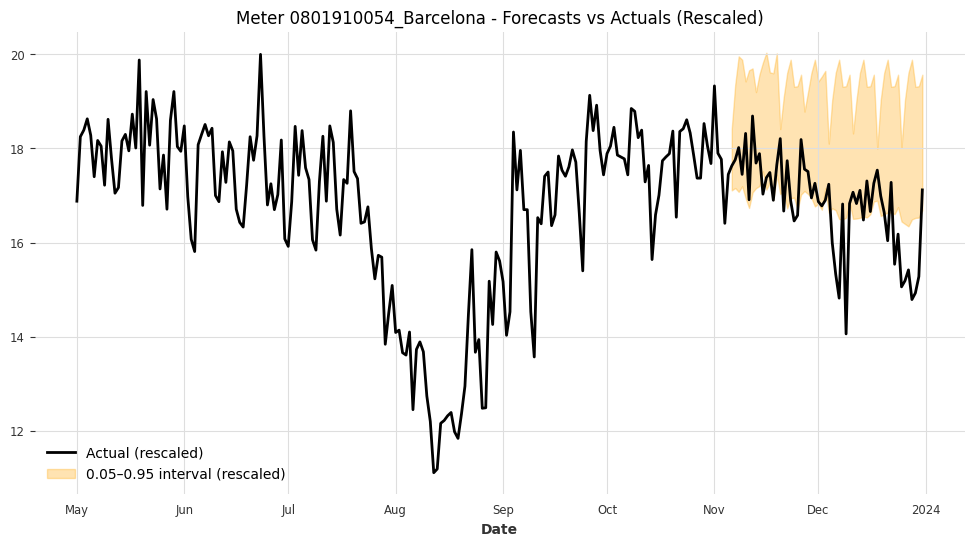

Meter 0801910054_Barcelona - Coverage: 0.6071, Mean Interval Width (rescaled): 2.5599



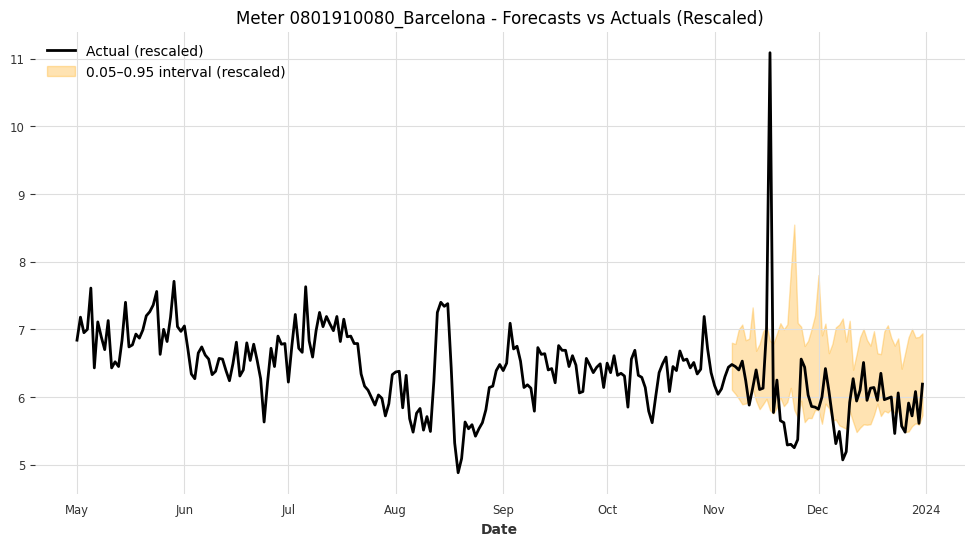

Meter 0801910080_Barcelona - Coverage: 0.7321, Mean Interval Width (rescaled): 1.1909



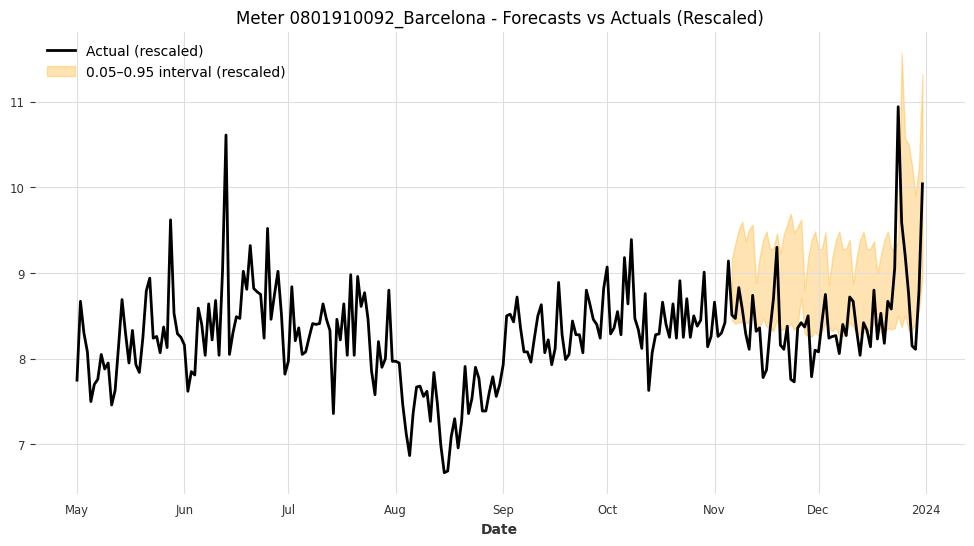

Meter 0801910092_Barcelona - Coverage: 0.5000, Mean Interval Width (rescaled): 1.1044



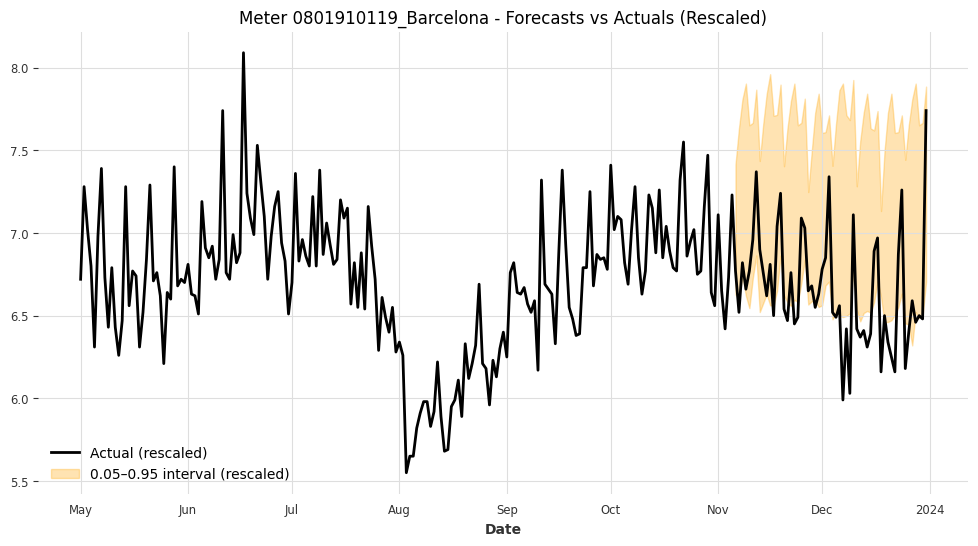

Meter 0801910119_Barcelona - Coverage: 0.5536, Mean Interval Width (rescaled): 1.0960



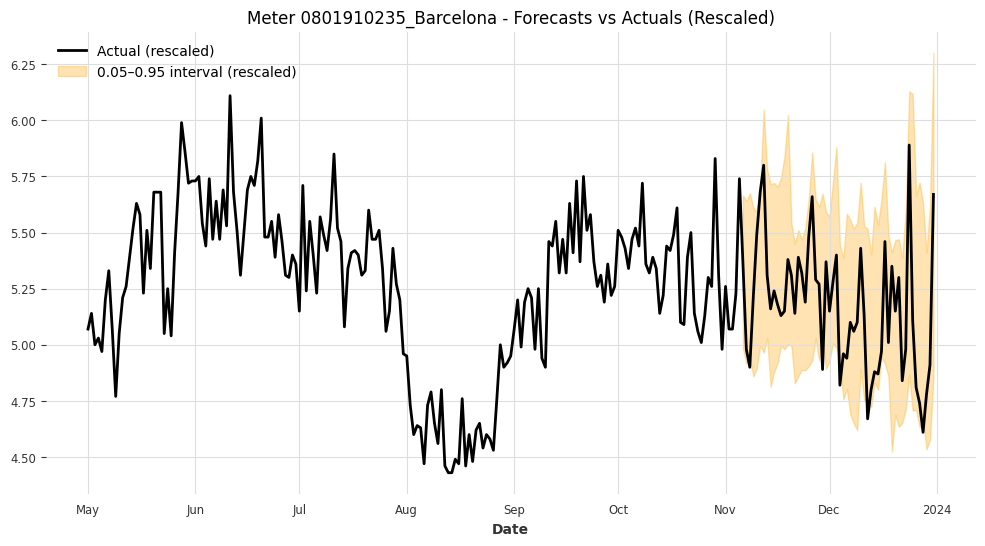

Meter 0801910235_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 0.8117



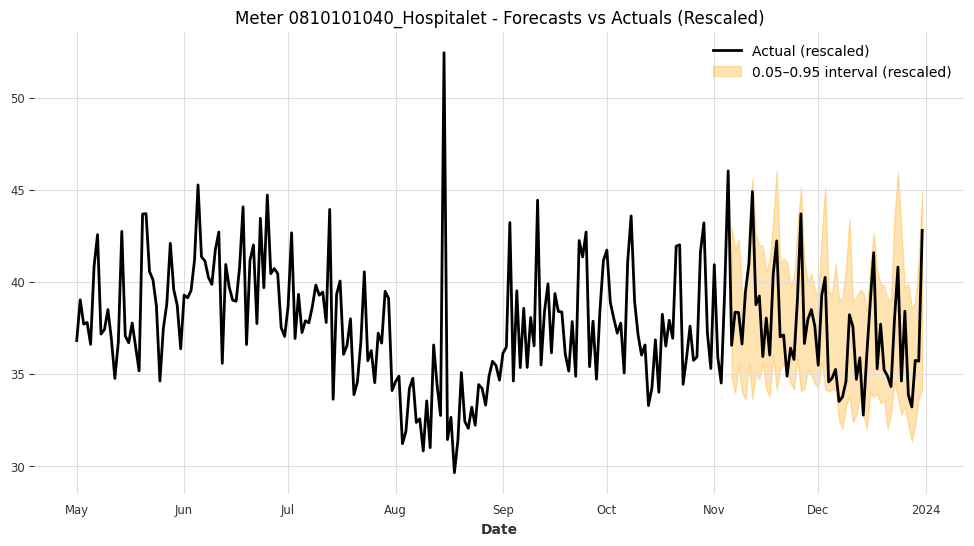

Meter 0810101040_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 7.2479



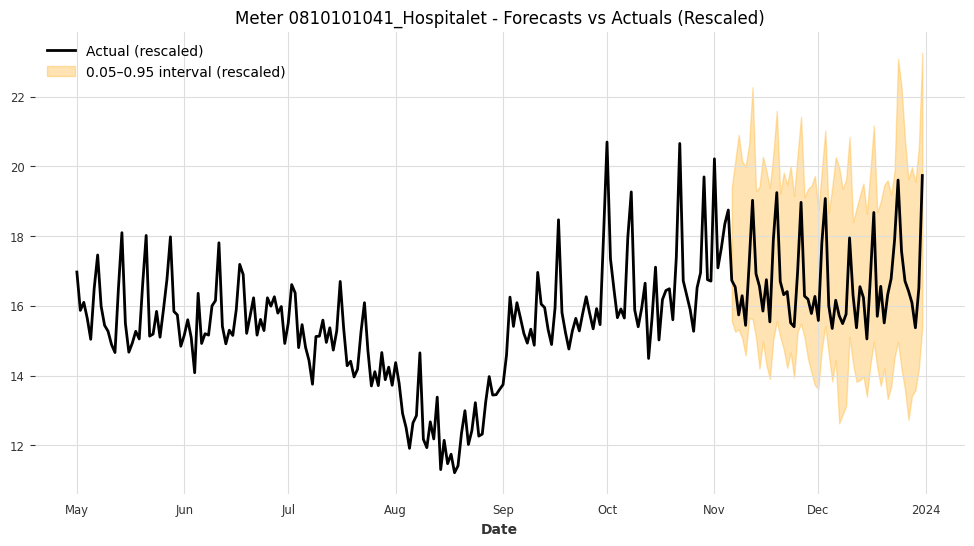

Meter 0810101041_Hospitalet - Coverage: 1.0000, Mean Interval Width (rescaled): 5.5966



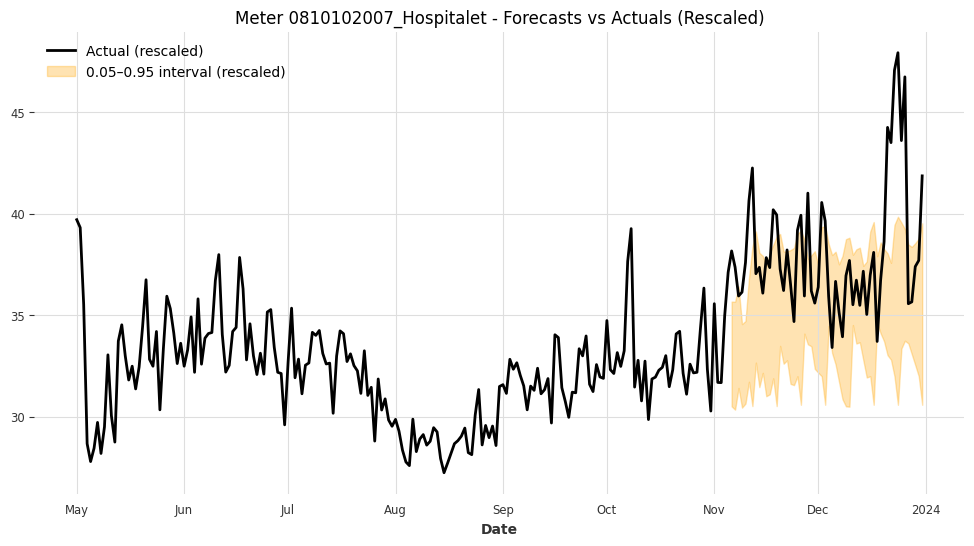

Meter 0810102007_Hospitalet - Coverage: 0.5714, Mean Interval Width (rescaled): 5.9860



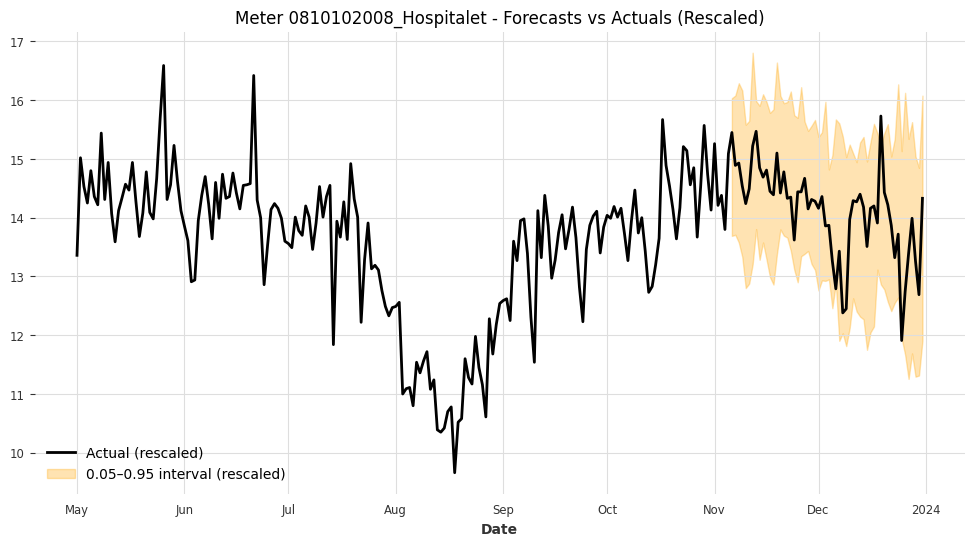

Meter 0810102008_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 2.8891



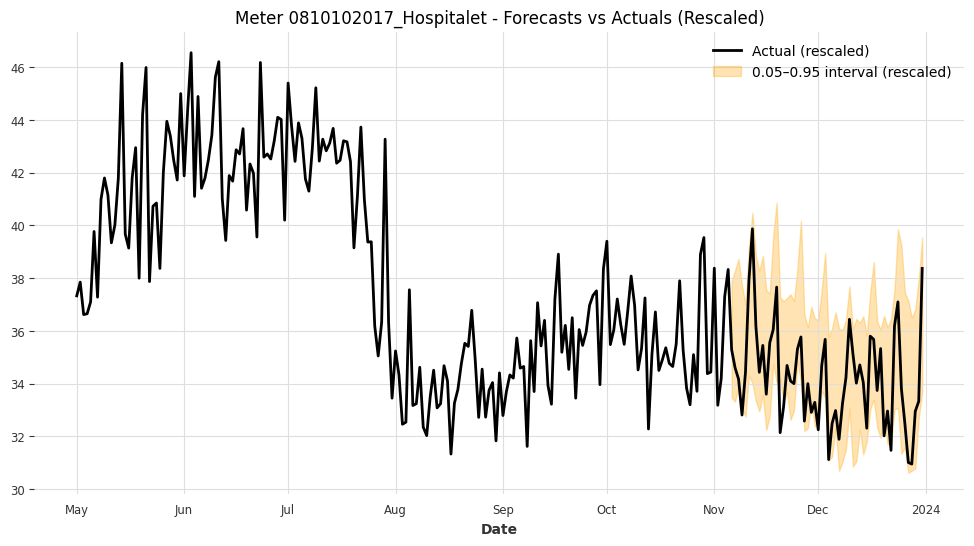

Meter 0810102017_Hospitalet - Coverage: 0.8750, Mean Interval Width (rescaled): 4.8875



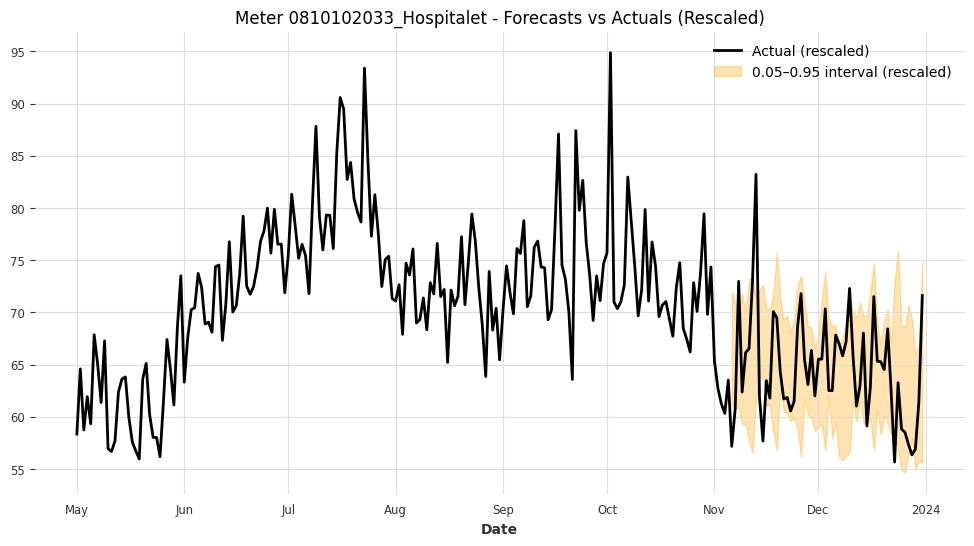

Meter 0810102033_Hospitalet - Coverage: 0.8393, Mean Interval Width (rescaled): 11.5164



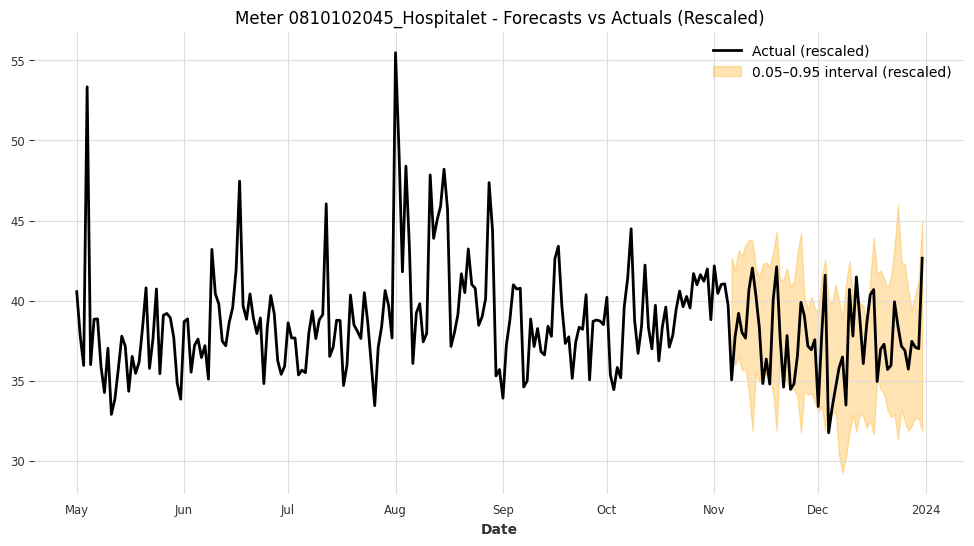

Meter 0810102045_Hospitalet - Coverage: 0.8393, Mean Interval Width (rescaled): 8.0884



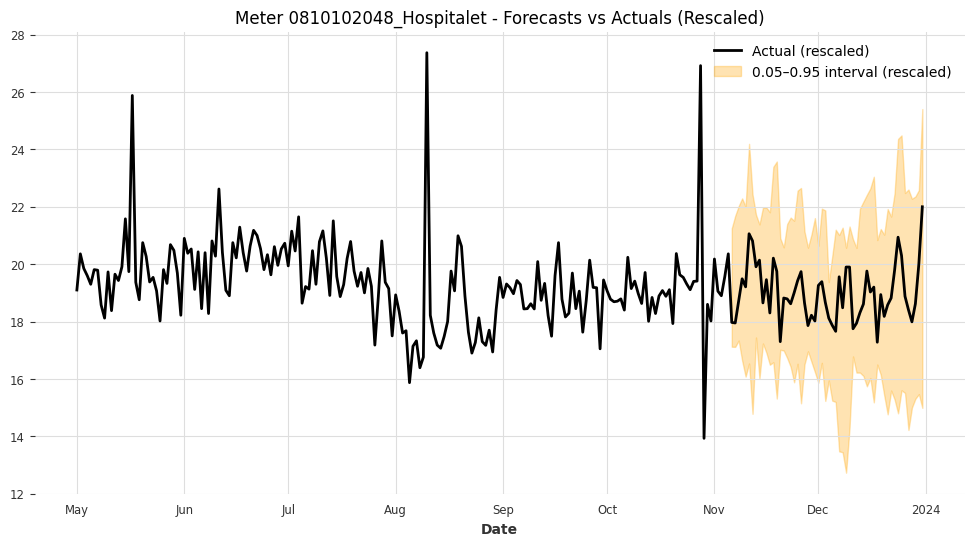

Meter 0810102048_Hospitalet - Coverage: 1.0000, Mean Interval Width (rescaled): 6.0457



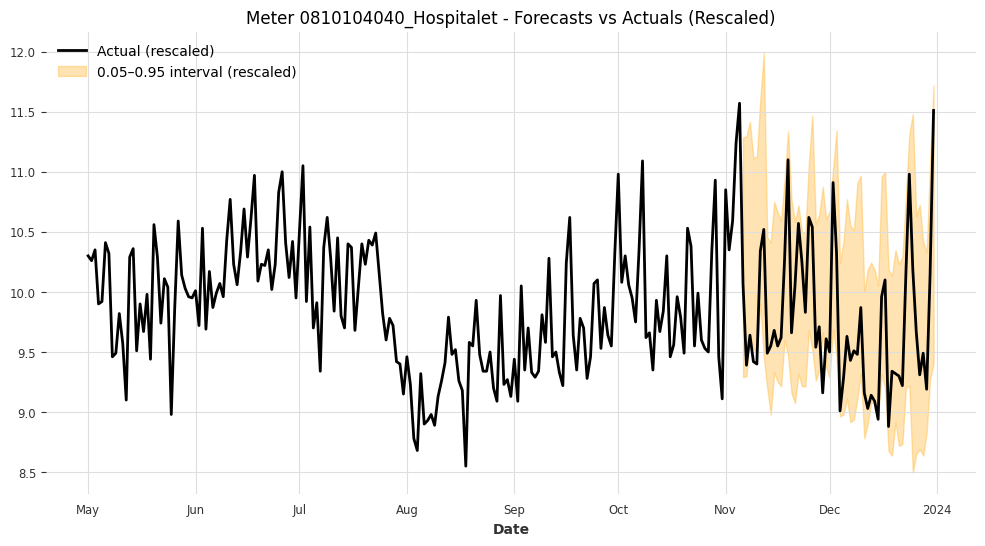

Meter 0810104040_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 1.5955



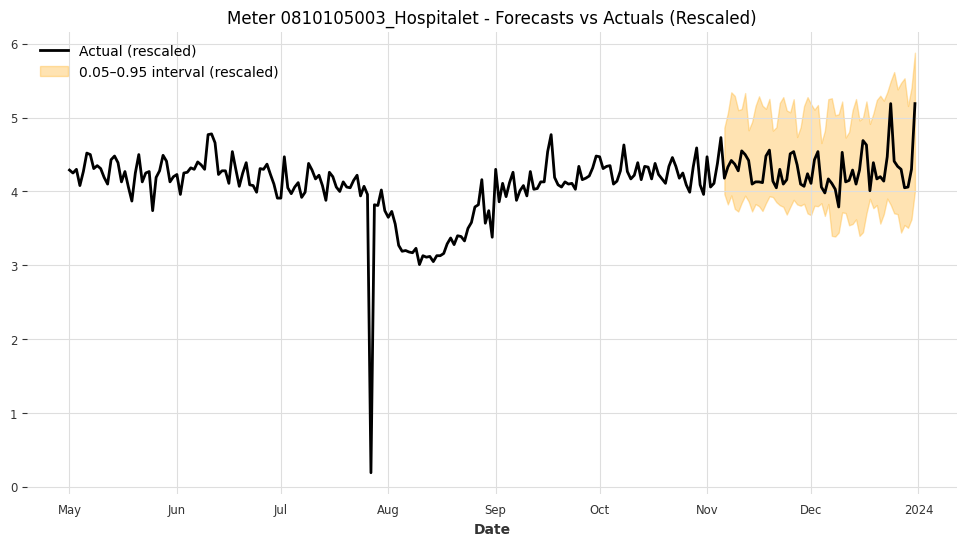

Meter 0810105003_Hospitalet - Coverage: 1.0000, Mean Interval Width (rescaled): 1.4130



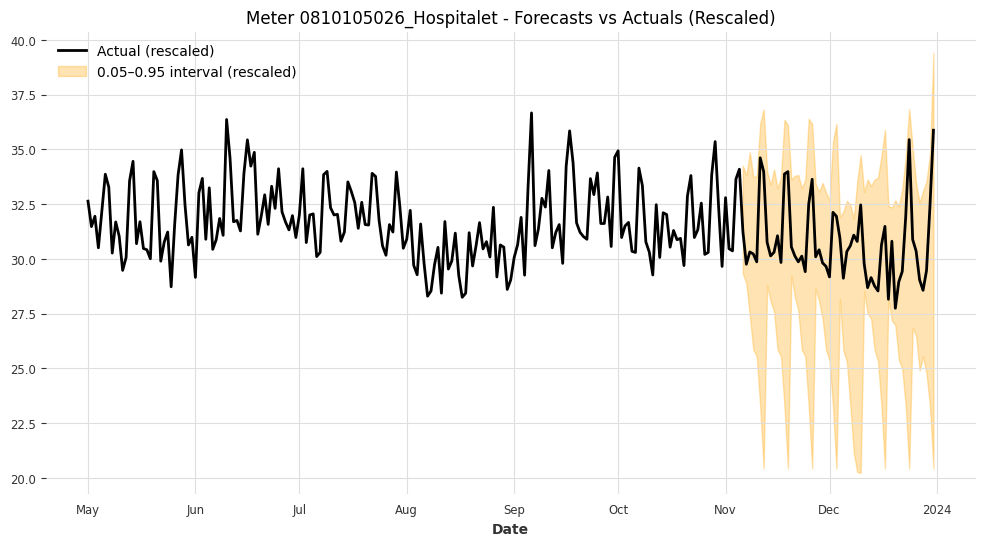

Meter 0810105026_Hospitalet - Coverage: 0.9821, Mean Interval Width (rescaled): 8.8444



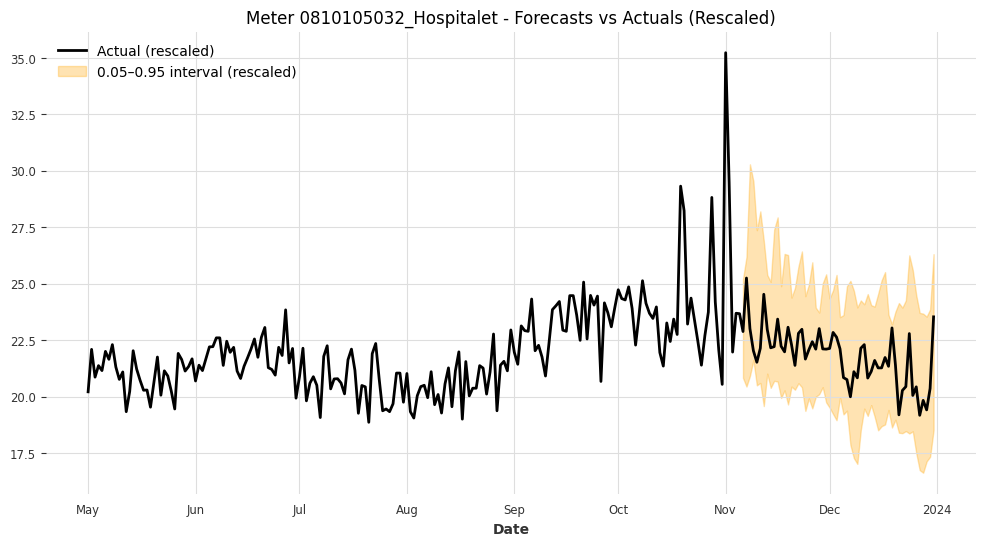

Meter 0810105032_Hospitalet - Coverage: 1.0000, Mean Interval Width (rescaled): 5.8481



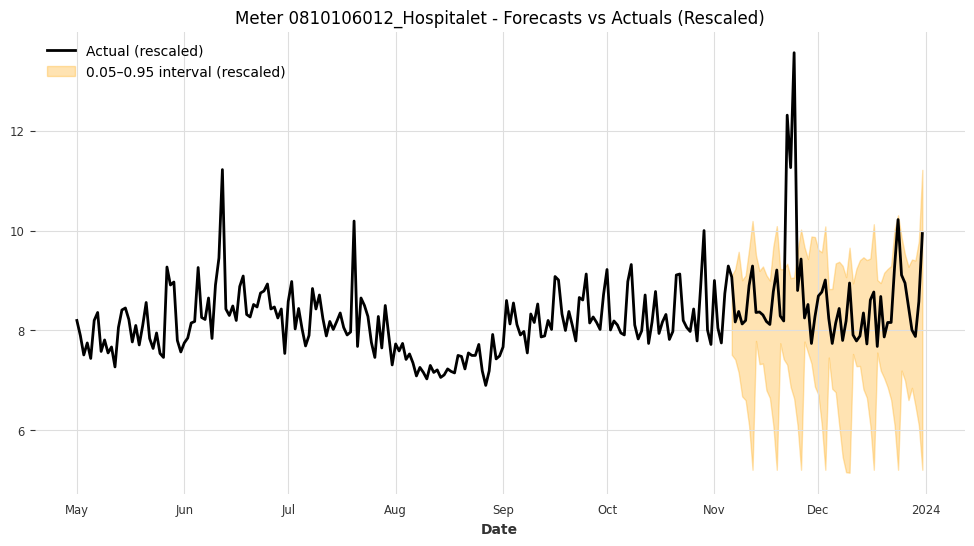

Meter 0810106012_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 2.8482



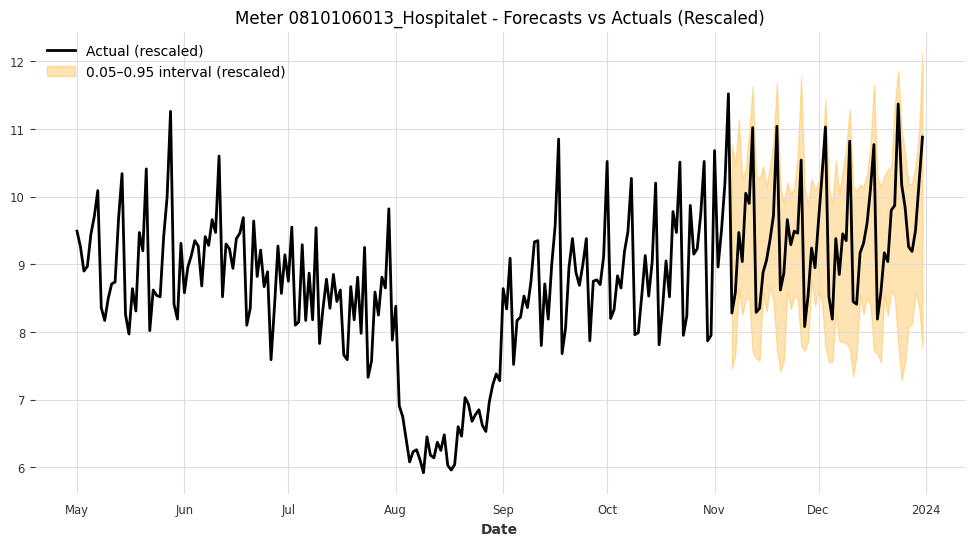

Meter 0810106013_Hospitalet - Coverage: 1.0000, Mean Interval Width (rescaled): 2.4994



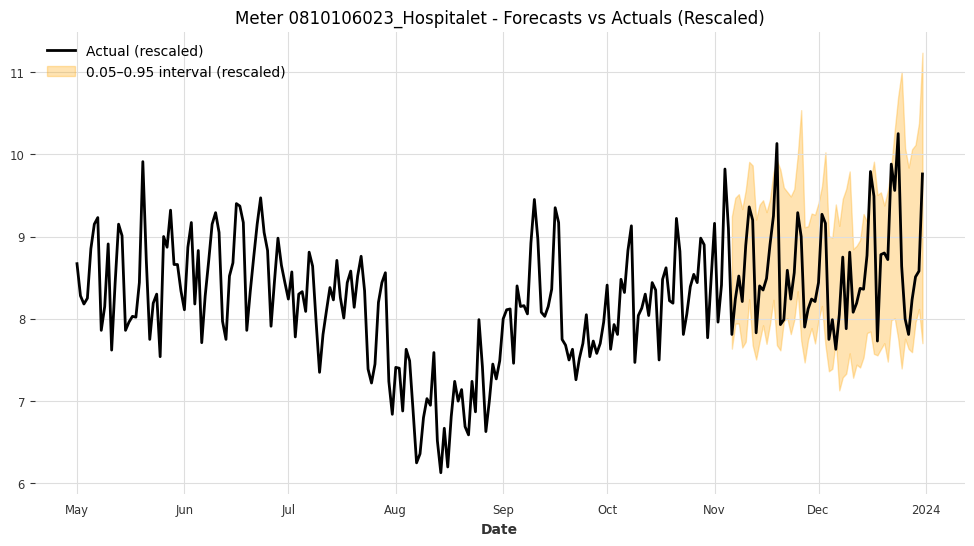

Meter 0810106023_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 1.9050



In [ ]:
import matplotlib.pyplot as plt
from darts import concatenate  # We use this to merge forecast segments

for meter_id, hfcs in all_hfcs.items():
    # Get actual series (scaled)
    ts = scaled_calib_test_series[meter_id]

    # Get scaler and results
    scaler = scalers_test[meter_id]
    df_result = all_bt_results[meter_id]
    coverage = df_result["Coverage"].iloc[0]
    width_orig = df_result["Width"].iloc[0]

    # Start plot
    fig, ax = plt.subplots(figsize=(12, 6))

    # Plot actuals (rescaled)
    ts_orig = scaler.inverse_transform(ts)
    ts_orig.plot(ax=ax, label='Actual (rescaled)', lw=2)

    # Collect rescaled quantiles
    full_lower = []
    full_upper = []

    for forecast in hfcs:
        if ('Consumption per meter_q0.05' in forecast.components and
            'Consumption per meter_q0.95' in forecast.components):

            lower = forecast['Consumption per meter_q0.05']
            upper = forecast['Consumption per meter_q0.95']
            lower_orig = scaler.inverse_transform(lower)
            upper_orig = scaler.inverse_transform(upper)
            full_lower.append(lower_orig)
            full_upper.append(upper_orig)

    # Plot interval if available
    if full_lower and full_upper:
        combined_lower = concatenate(full_lower)
        combined_upper = concatenate(full_upper)

        ax.fill_between(
            combined_lower.time_index,
            combined_lower.values().flatten(),
            combined_upper.values().flatten(),
            color='orange',
            alpha=0.3,
            label='0.05–0.95 interval (rescaled)'
        )

    # Finalize plot
    ax.set_title(f"Meter {meter_id} - Forecasts vs Actuals (Rescaled)")
    ax.legend()
    plt.show()

    # Show metrics
    print(f"Meter {meter_id} - Coverage: {coverage:.4f}, Mean Interval Width (rescaled): {width_orig:.4f}\n")


In [ ]:
# Let's check the standard scaling

In [ ]:
# Load model
model = LightGBMModel.load("/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/lightGBM/covariates/lightgbm_model_standard_covariates.pkl")
# We load the test data
test_data = joblib.load('/content/drive/MyDrive/Colab Notebooks/TFG/data/01_datasets/train_test/scaled_test_standard.pkl')
print(test_data.keys())

# Extract components
scaled_calib_test_series = test_data['calib_test']
scalers_test = test_data['scalers']           # the scalers to reescale the series later

# Reuse the same sorted meter IDs to align
meter_ids_test = sorted(scaled_calib_test_series.keys())

# Build aligned lists
test_series_scaled = [scaled_calib_test_series[meter_id] for meter_id in meter_ids_test]

print(f"Loaded {len(test_series_scaled)} time series for testing.")

dict_keys(['train', 'validation', 'calib_test', 'scalers'])
Loaded 60 time series for testing.


In [ ]:
# We build the future covariates for the test set
future_covariates_test = []

for test_ts in test_series_scaled:
    test_cov = concatenate([
        datetime_attribute_timeseries(test_ts, "day_of_week", one_hot=True),
        datetime_attribute_timeseries(test_ts, "month", one_hot=True),
        is_weekend_timeseries.slice_intersect(test_ts),
        holiday_timeseries.slice_intersect(test_ts),
        day_of_year_timeseries.slice_intersect(test_ts)
    ], axis=1)

    future_covariates_test.append(test_cov)


In [ ]:
import pandas as pd

# Constants
start_date = pd.Timestamp("2023-11-6")
quantiles = [0.05, 0.5, 0.95]
pred_kwargs={"predict_likelihood_parameters": True, "verbose": True}
q_interval = [(0.05, 0.95)]
q_range = [0.9]

# Prepare to collect results
all_hfcs = {}
all_bt_results = {}

# We loop over each time series (one per meter)
for meter_id, ts, fcov in zip(meter_ids_test, test_series_scaled, future_covariates_test):

    # Historical forecasts
    hfcs = model.historical_forecasts(
        series=ts,
        future_covariates=fcov,
        forecast_horizon=7,
        start=start_date,
        last_points_only=False,
        stride=7,
        retrain=False,
        **pred_kwargs,
    )

    scaler = scalers_test[meter_id]
    widths = []

    for forecast in hfcs:
        q05 = forecast["Consumption per meter_q0.05"]
        q95 = forecast["Consumption per meter_q0.95"]
        q05_orig = scaler.inverse_transform(q05)
        q95_orig = scaler.inverse_transform(q95)
        width = (q95_orig - q05_orig).values()
        widths.append(width)

    mean_width = np.mean([np.mean(w) for w in widths])


    # We backtest (evaluate) the generated predictions
    bt = model.backtest(
        series=ts,
        future_covariates=fcov,
        historical_forecasts=hfcs,
        last_points_only=False,
        metric=[metrics.mic, metrics.miw],
        metric_kwargs={"q_interval": q_interval},
        retrain=False,
    )
    df_results = pd.DataFrame({"Interval": q_range, "Coverage": bt[0], "Width": mean_width})

    # Store results
    all_hfcs[meter_id] = hfcs
    all_bt_results[meter_id] = df_results

# We combine results across meters
combined_results = pd.concat(all_bt_results.values(), keys=all_bt_results.keys())
combined_results.reset_index(level=1, drop=True, inplace=True)


historical forecasts: 100%|██████████| 1/1 [00:00<00:00, 25.14it/s]


In [ ]:
mean_coverage = combined_results["Coverage"].mean()
mean_width = combined_results["Width"].mean()

print(f"Mean Coverage: {mean_coverage:.4f}")
print(f"Mean Width: {mean_width:.4f}")


Mean Coverage: 0.8265
Mean Width: 6.1311


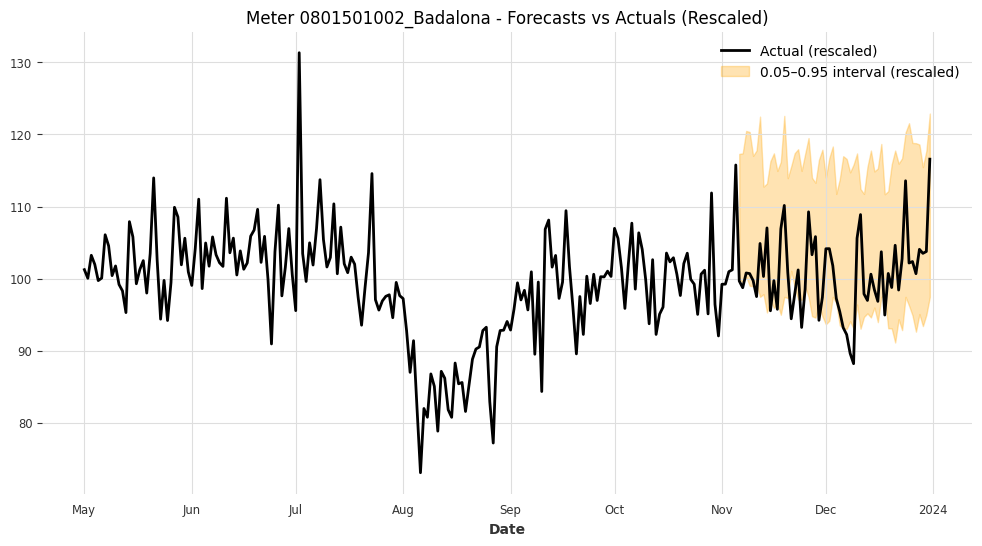

Meter 0801501002_Badalona - Coverage: 0.7500, Mean Interval Width (rescaled): 20.6943



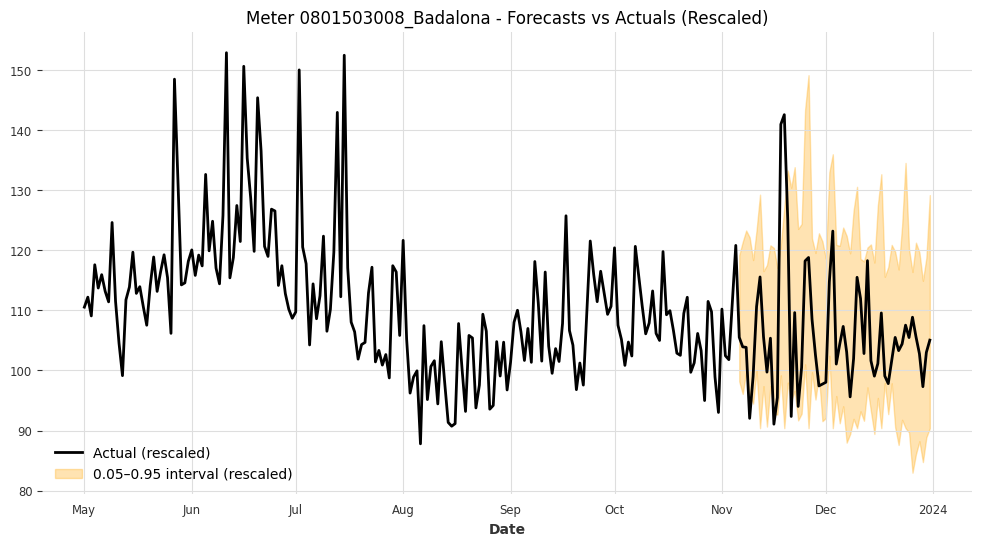

Meter 0801503008_Badalona - Coverage: 0.8929, Mean Interval Width (rescaled): 30.2857



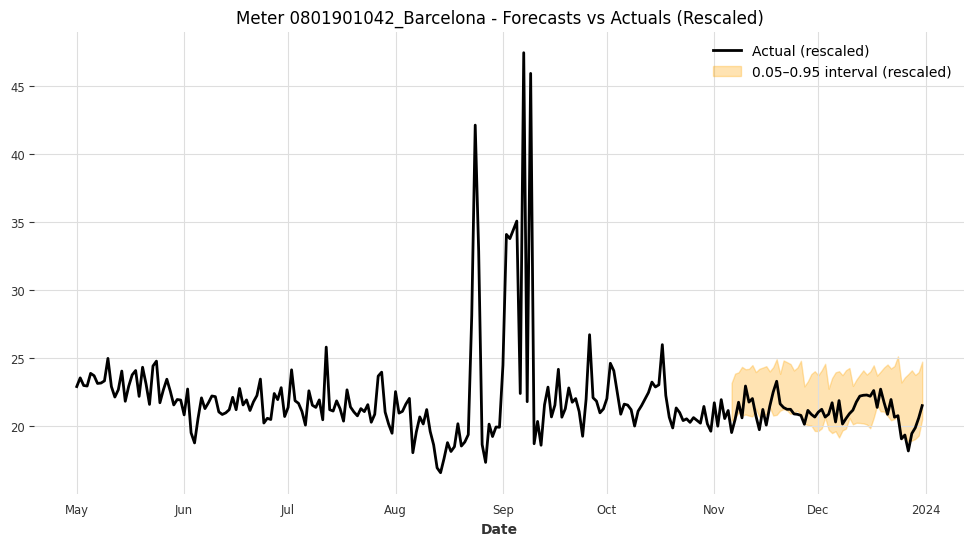

Meter 0801901042_Barcelona - Coverage: 0.7500, Mean Interval Width (rescaled): 3.6824



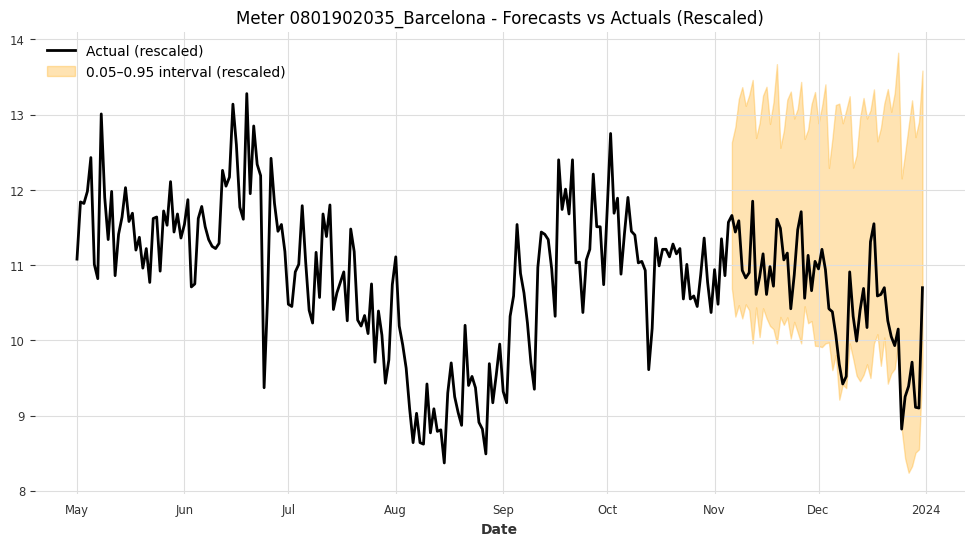

Meter 0801902035_Barcelona - Coverage: 0.9821, Mean Interval Width (rescaled): 3.2069



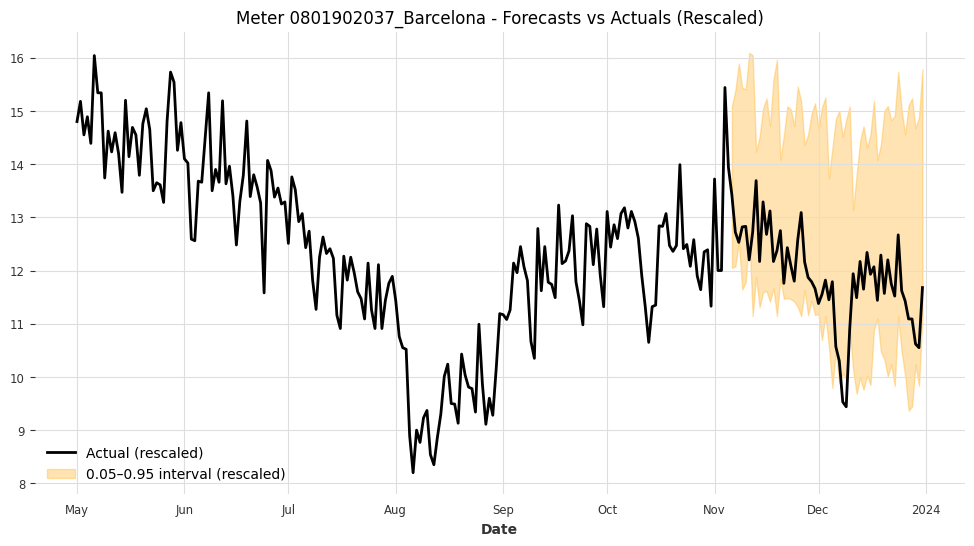

Meter 0801902037_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 4.0305



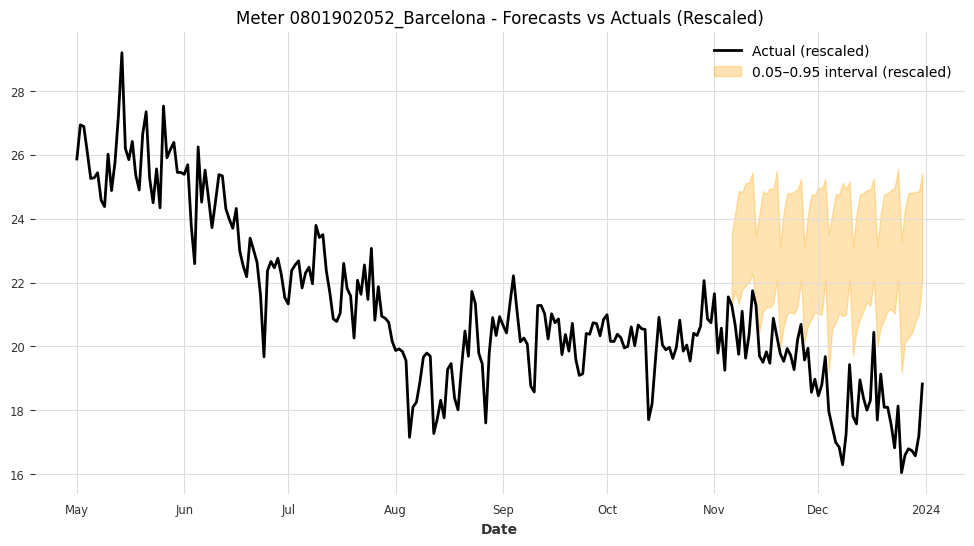

Meter 0801902052_Barcelona - Coverage: 0.0179, Mean Interval Width (rescaled): 3.5813



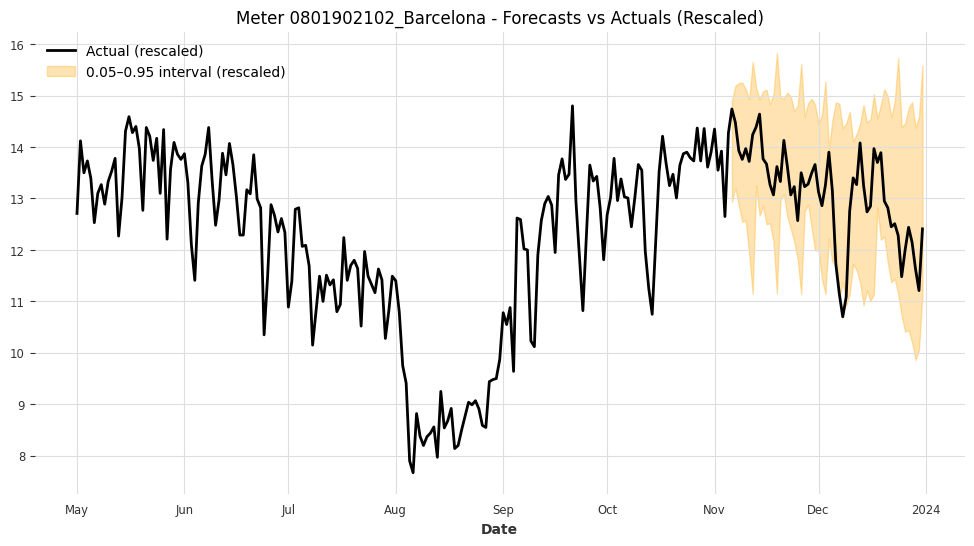

Meter 0801902102_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 3.0616



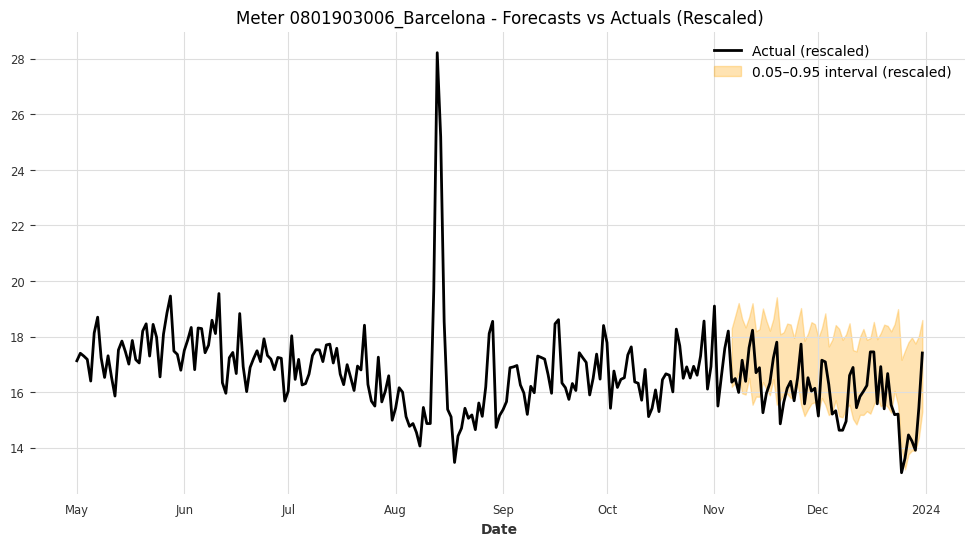

Meter 0801903006_Barcelona - Coverage: 0.6964, Mean Interval Width (rescaled): 2.8148



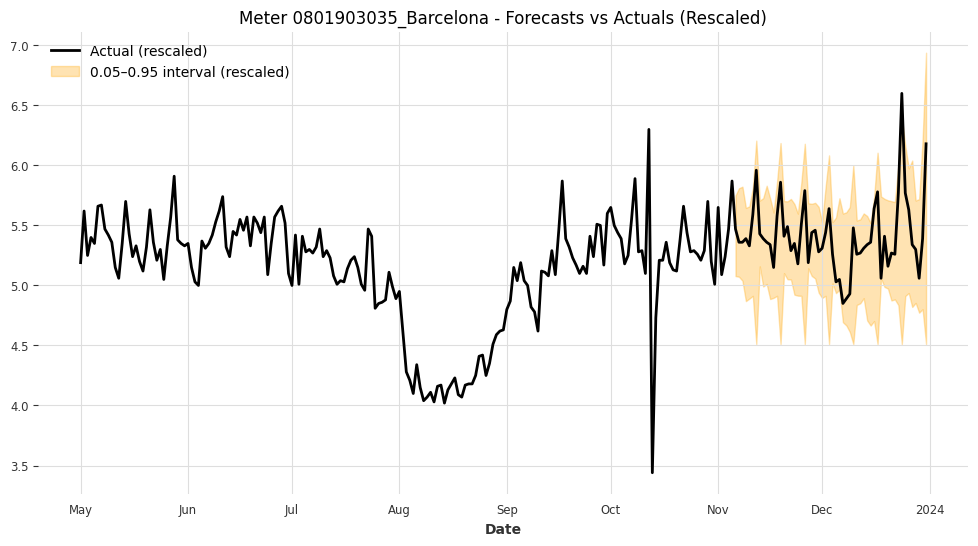

Meter 0801903035_Barcelona - Coverage: 0.9821, Mean Interval Width (rescaled): 0.9444



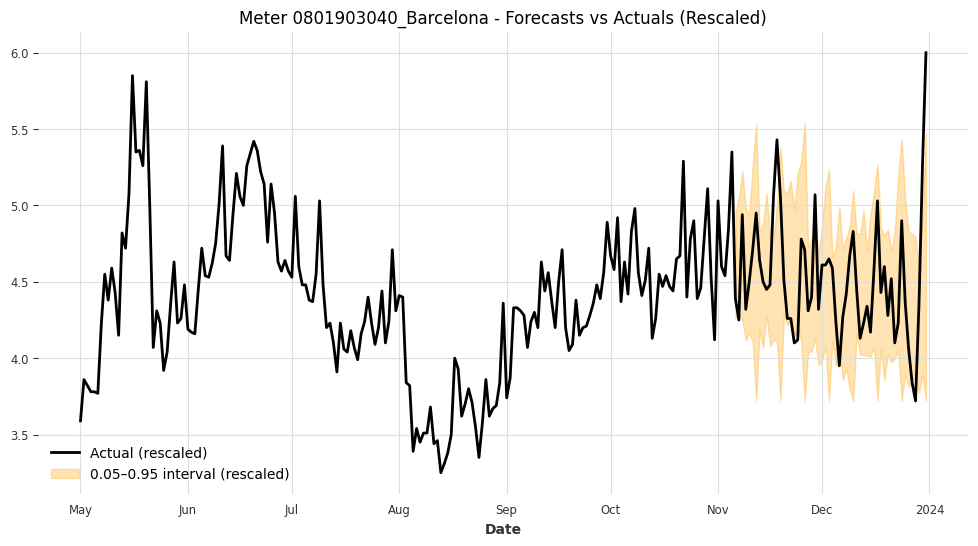

Meter 0801903040_Barcelona - Coverage: 0.8036, Mean Interval Width (rescaled): 0.9738



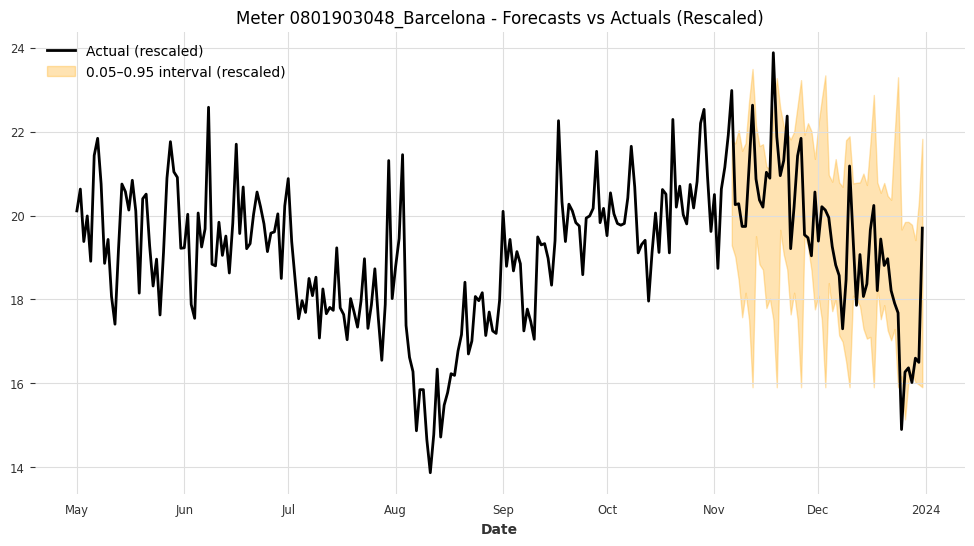

Meter 0801903048_Barcelona - Coverage: 0.8571, Mean Interval Width (rescaled): 4.0337



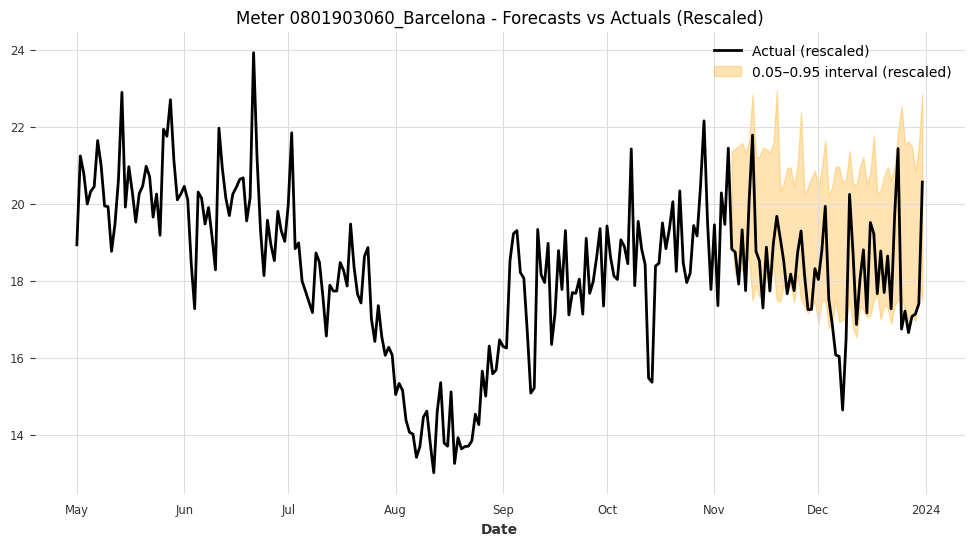

Meter 0801903060_Barcelona - Coverage: 0.6964, Mean Interval Width (rescaled): 3.6374



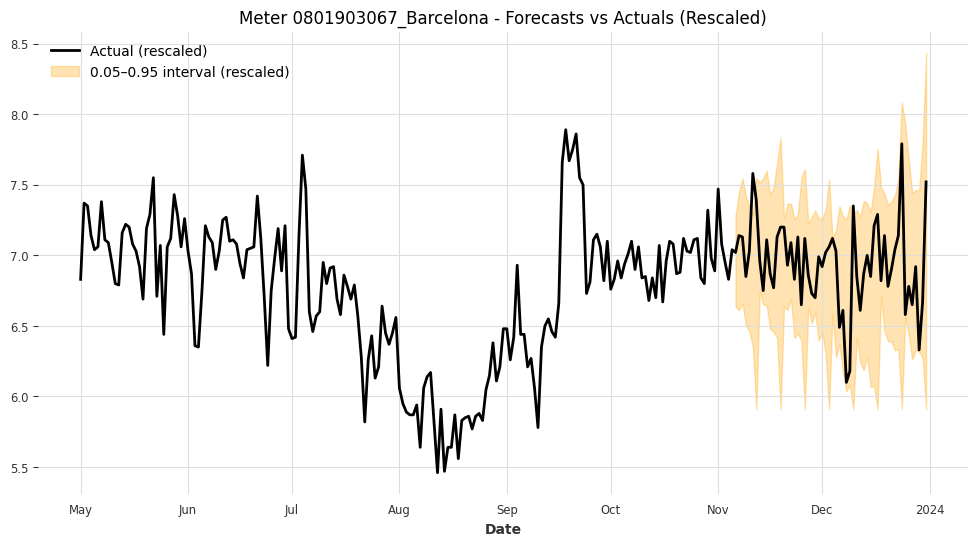

Meter 0801903067_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 1.1047



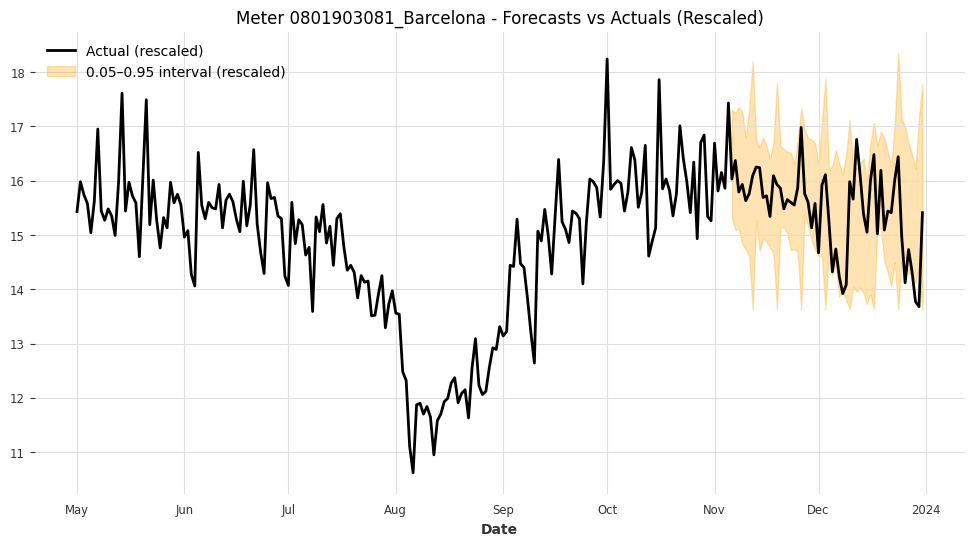

Meter 0801903081_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 2.3526



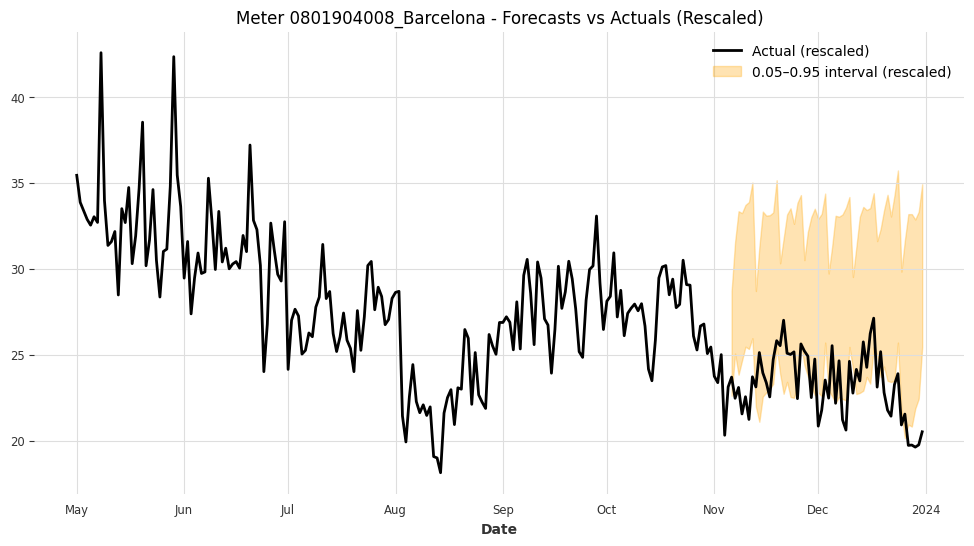

Meter 0801904008_Barcelona - Coverage: 0.4464, Mean Interval Width (rescaled): 9.4022



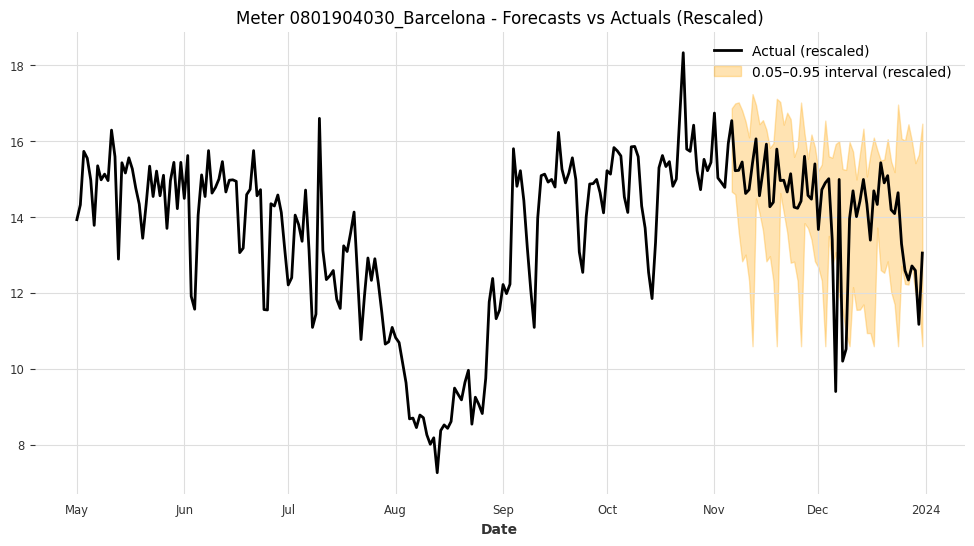

Meter 0801904030_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 3.6366



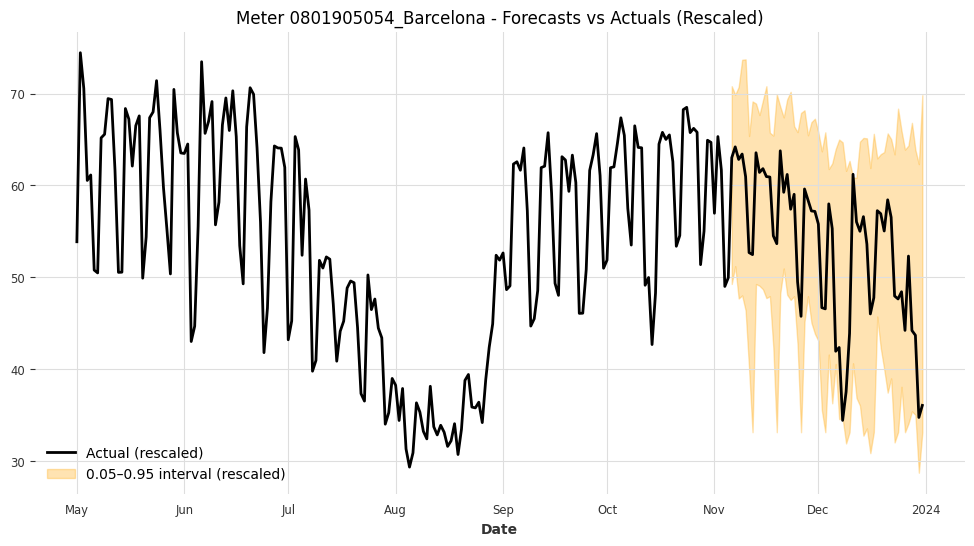

Meter 0801905054_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 25.9672



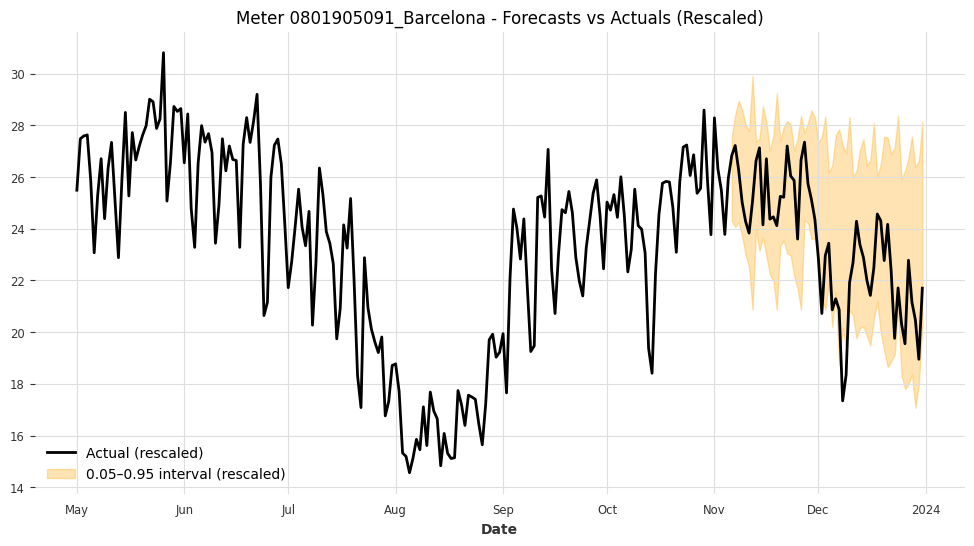

Meter 0801905091_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 6.2906



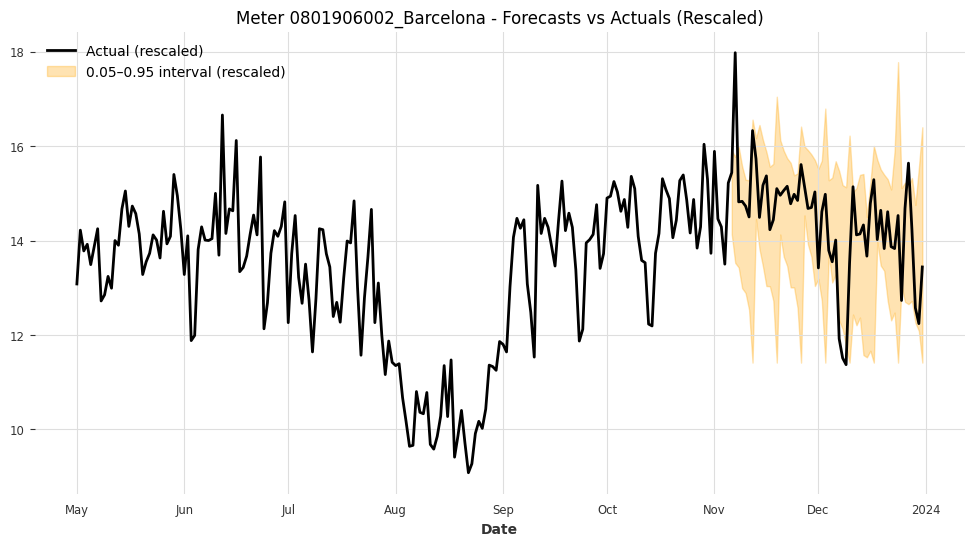

Meter 0801906002_Barcelona - Coverage: 0.8750, Mean Interval Width (rescaled): 2.9344



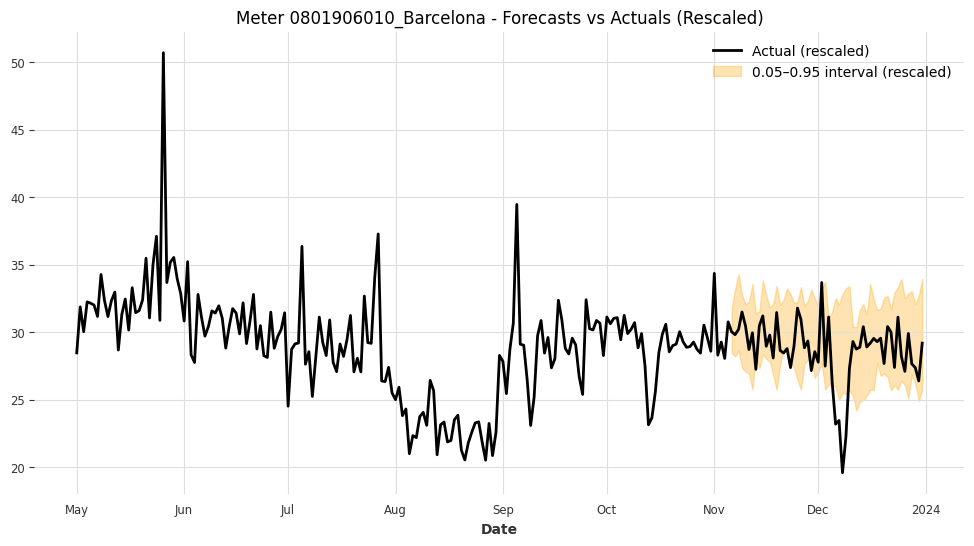

Meter 0801906010_Barcelona - Coverage: 0.8214, Mean Interval Width (rescaled): 5.8845



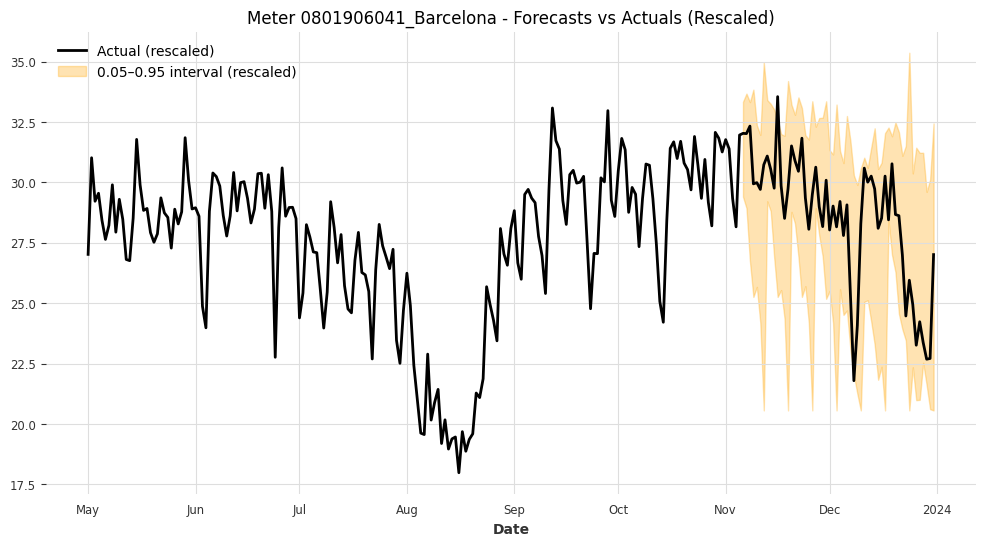

Meter 0801906041_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 7.7005



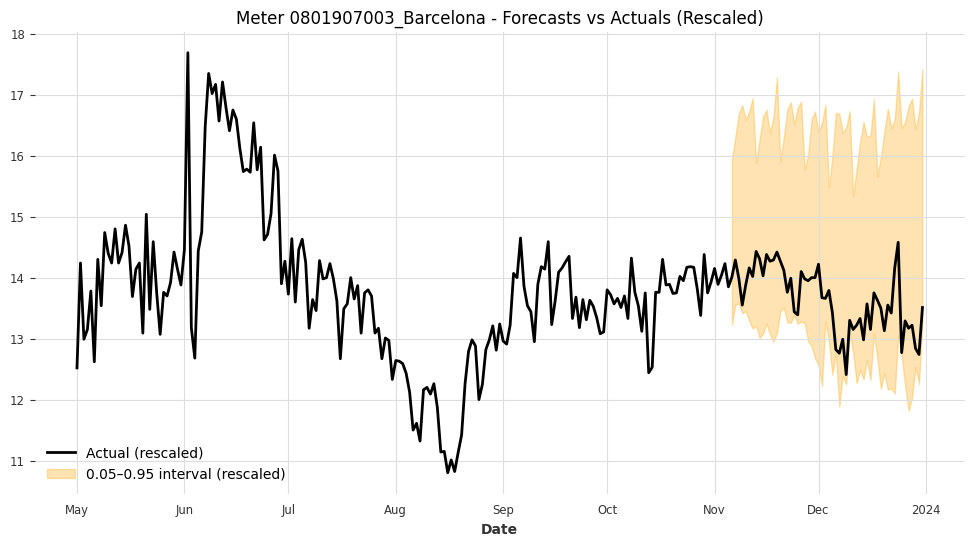

Meter 0801907003_Barcelona - Coverage: 1.0000, Mean Interval Width (rescaled): 3.6675



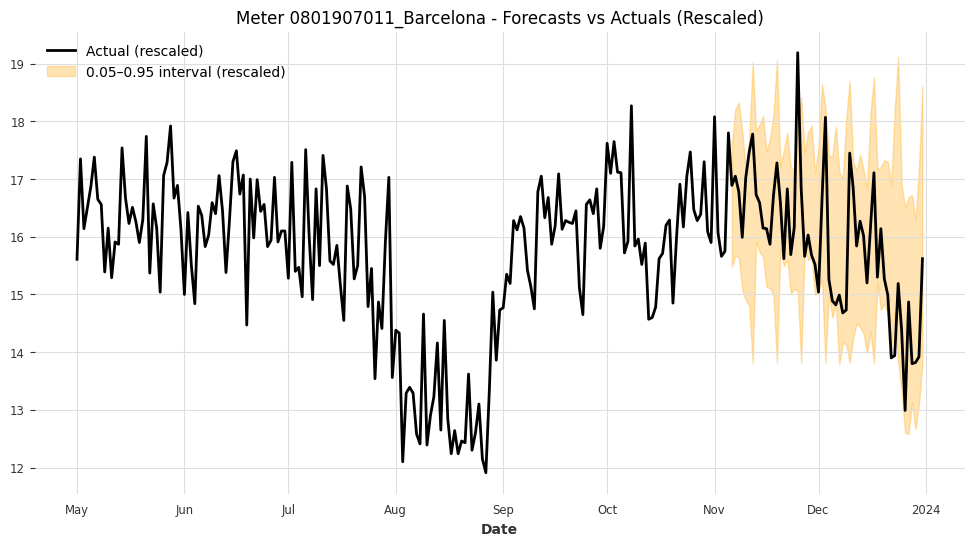

Meter 0801907011_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 3.0658



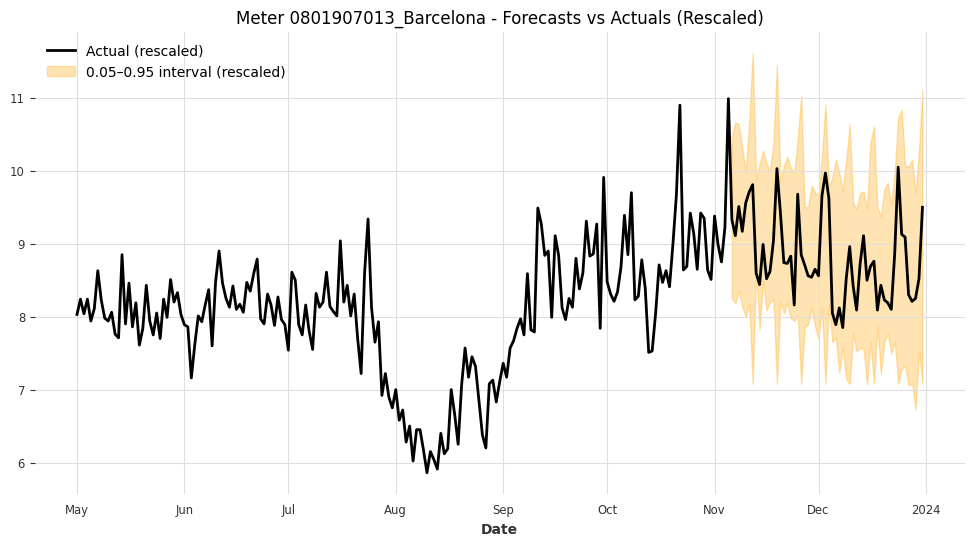

Meter 0801907013_Barcelona - Coverage: 0.9821, Mean Interval Width (rescaled): 2.4500



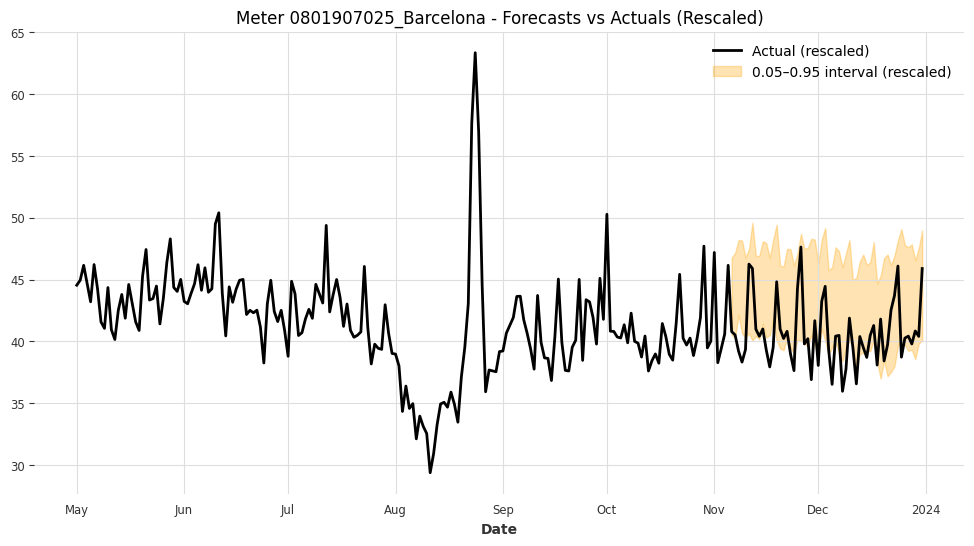

Meter 0801907025_Barcelona - Coverage: 0.6250, Mean Interval Width (rescaled): 7.6185



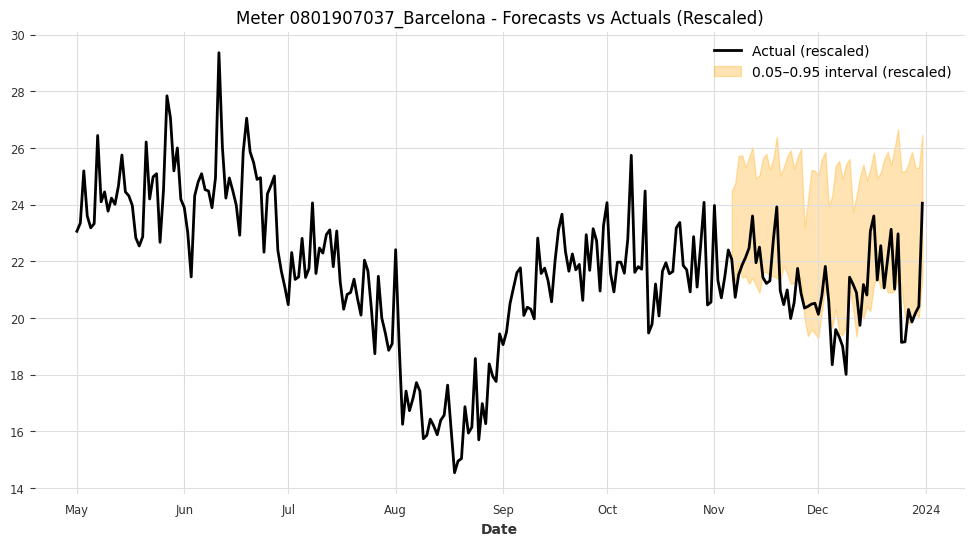

Meter 0801907037_Barcelona - Coverage: 0.5893, Mean Interval Width (rescaled): 4.5780



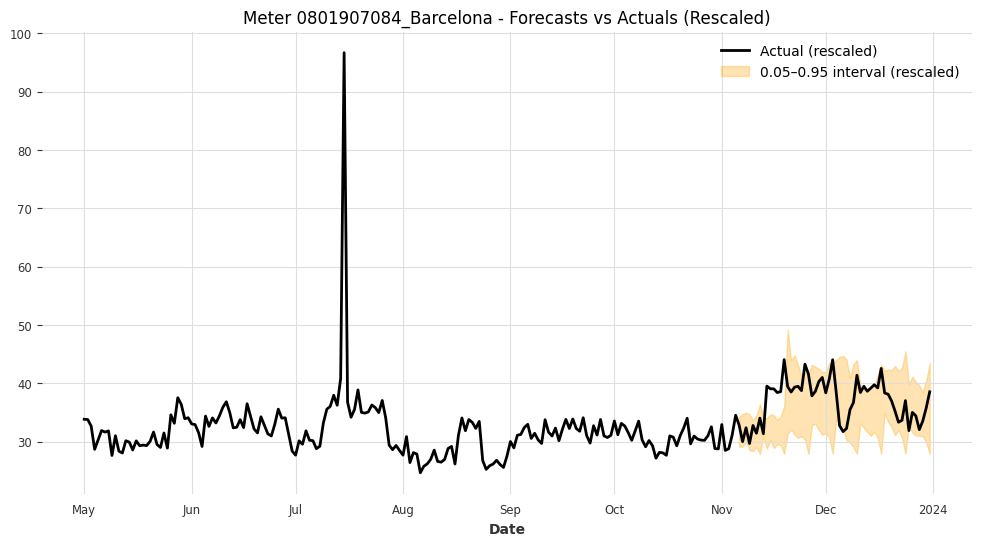

Meter 0801907084_Barcelona - Coverage: 0.7500, Mean Interval Width (rescaled): 9.7596



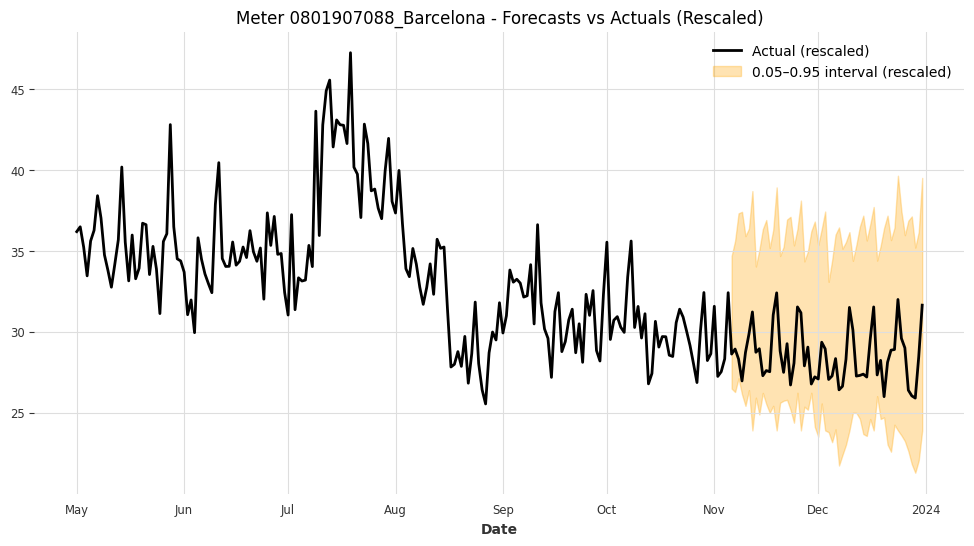

Meter 0801907088_Barcelona - Coverage: 1.0000, Mean Interval Width (rescaled): 11.7438



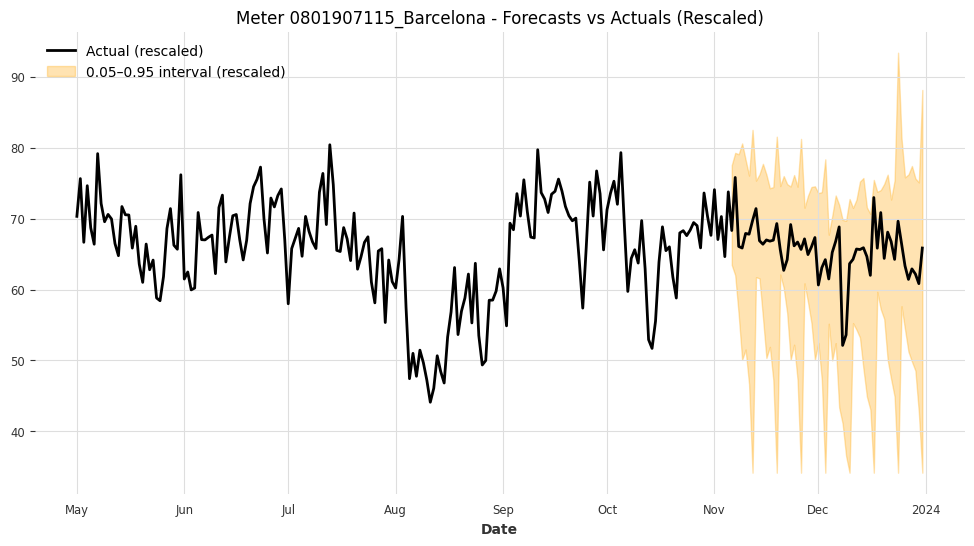

Meter 0801907115_Barcelona - Coverage: 1.0000, Mean Interval Width (rescaled): 25.9956



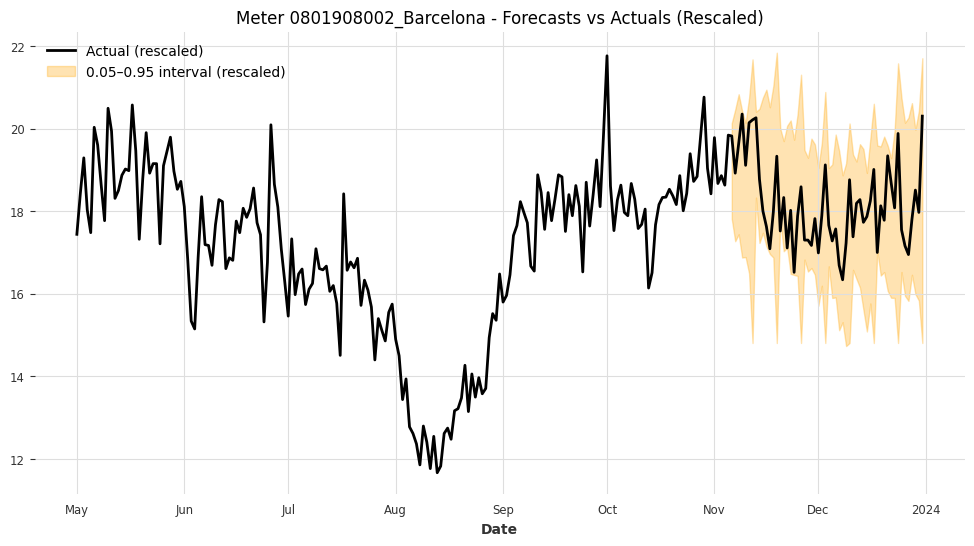

Meter 0801908002_Barcelona - Coverage: 0.9464, Mean Interval Width (rescaled): 3.8669



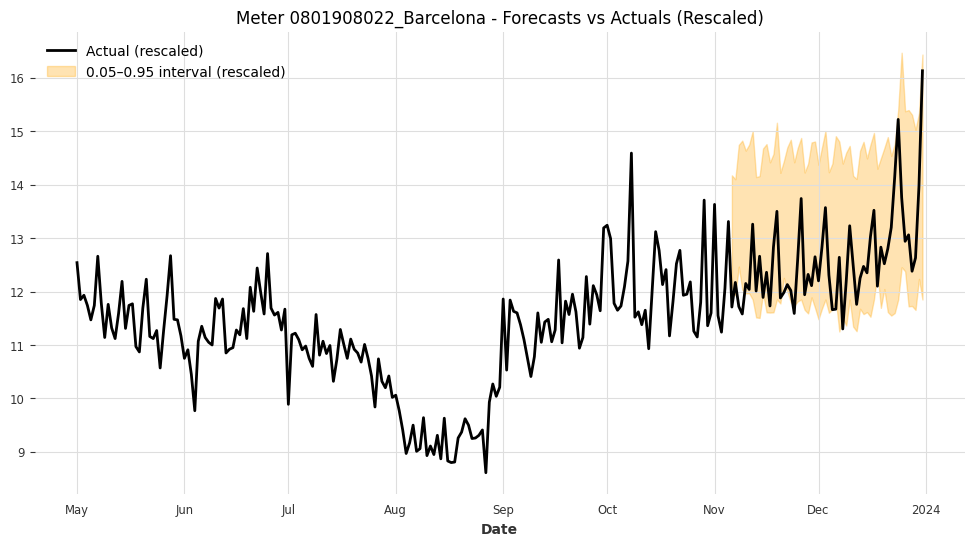

Meter 0801908022_Barcelona - Coverage: 0.8214, Mean Interval Width (rescaled): 2.9499



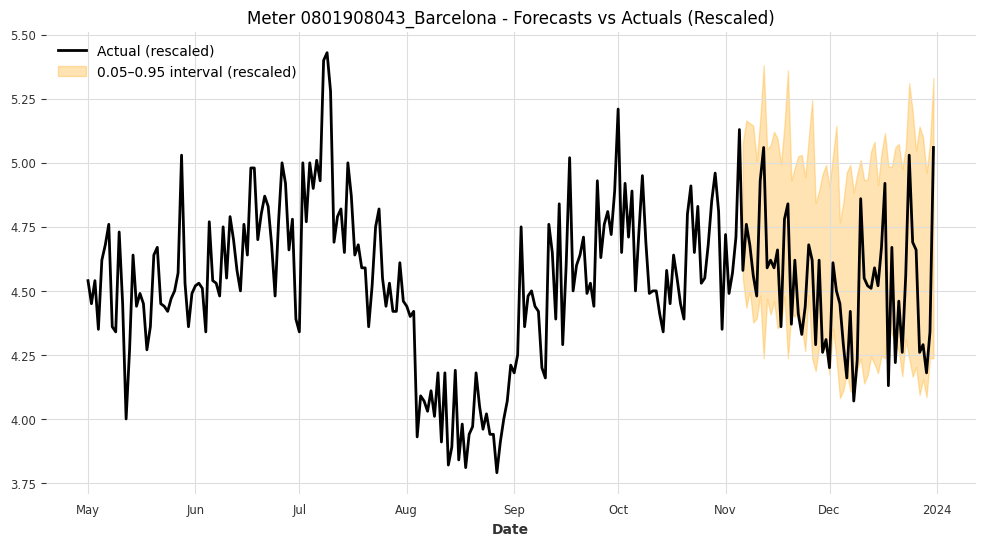

Meter 0801908043_Barcelona - Coverage: 0.8393, Mean Interval Width (rescaled): 0.7673



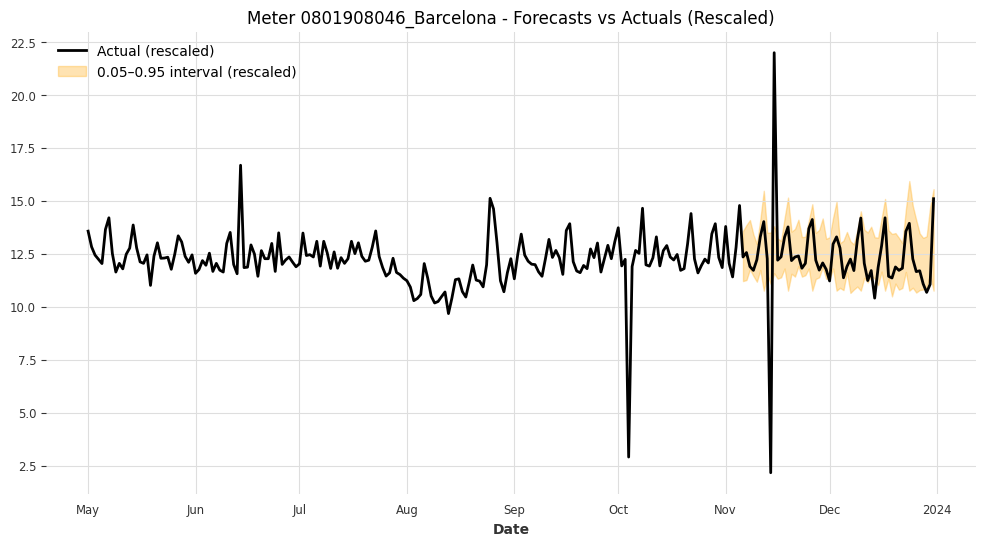

Meter 0801908046_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 2.6257



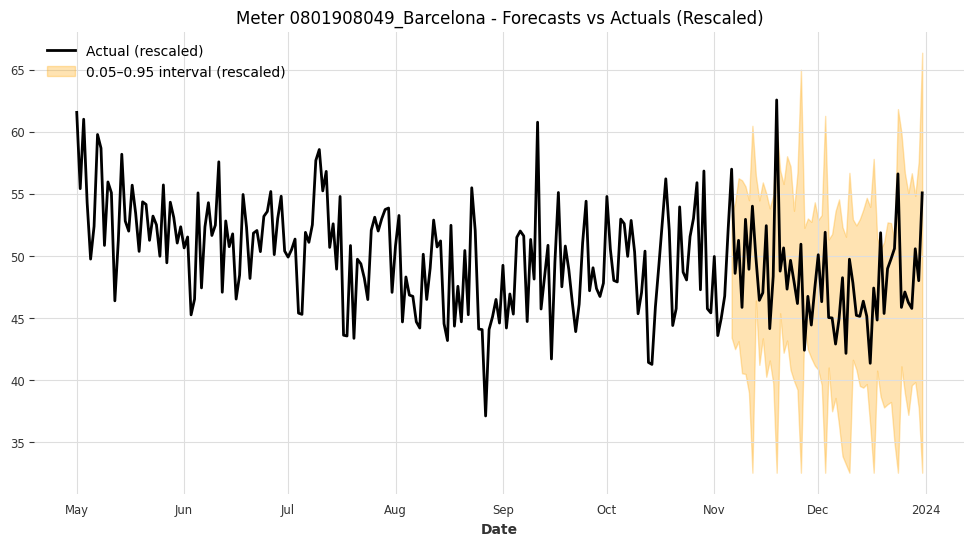

Meter 0801908049_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 16.2390



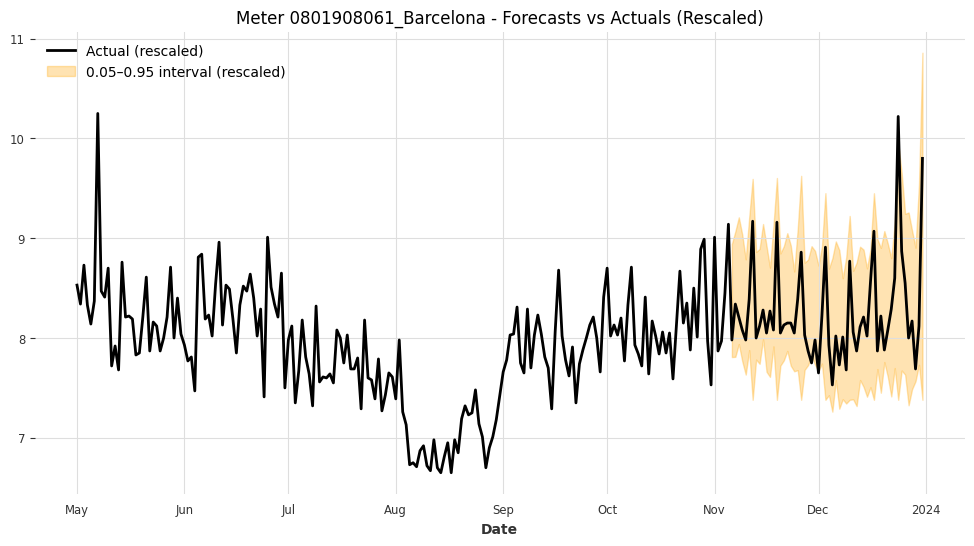

Meter 0801908061_Barcelona - Coverage: 0.9464, Mean Interval Width (rescaled): 1.4605



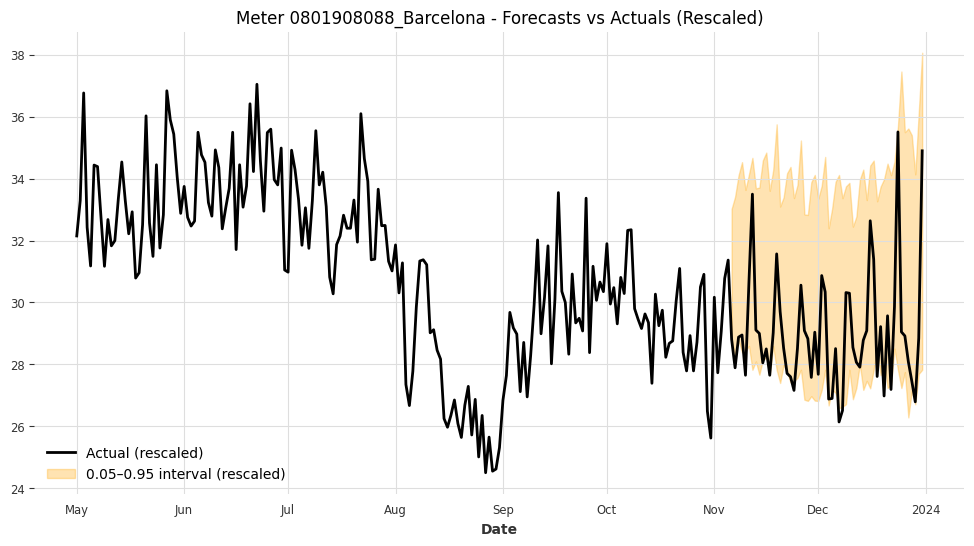

Meter 0801908088_Barcelona - Coverage: 0.7857, Mean Interval Width (rescaled): 6.5883



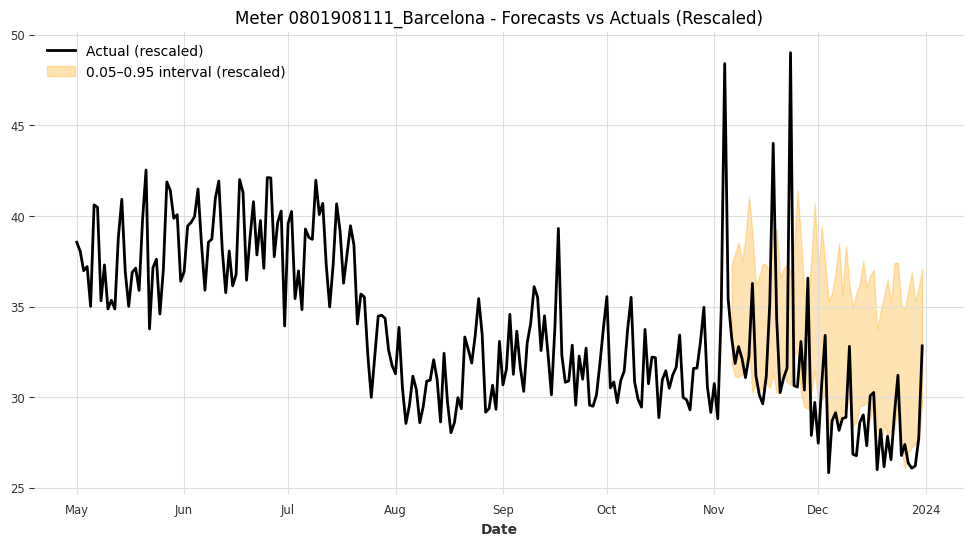

Meter 0801908111_Barcelona - Coverage: 0.4286, Mean Interval Width (rescaled): 7.3806



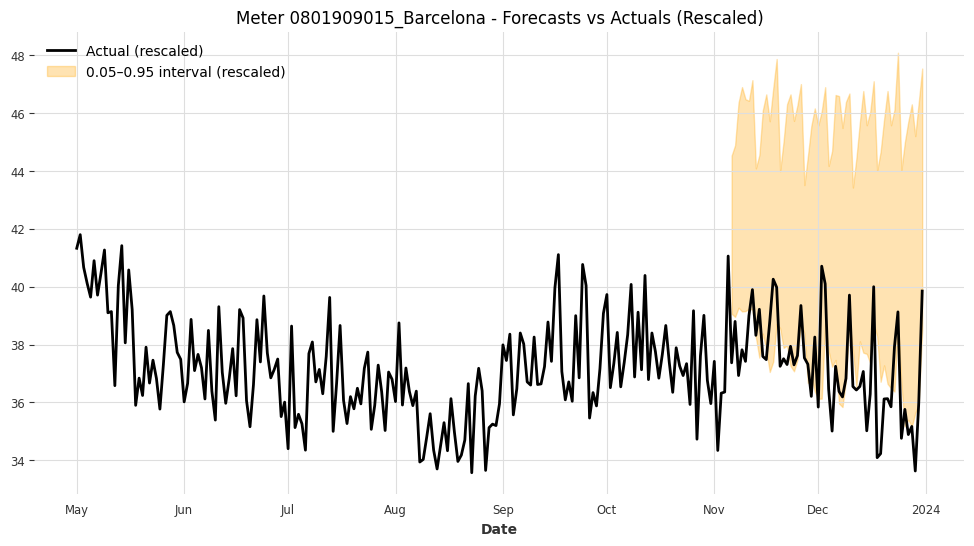

Meter 0801909015_Barcelona - Coverage: 0.4464, Mean Interval Width (rescaled): 8.2934



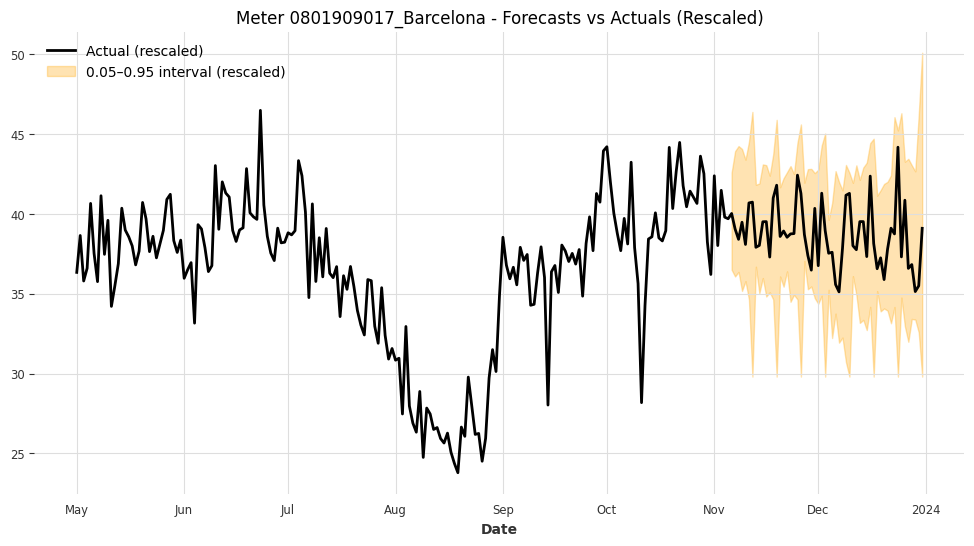

Meter 0801909017_Barcelona - Coverage: 1.0000, Mean Interval Width (rescaled): 9.4994



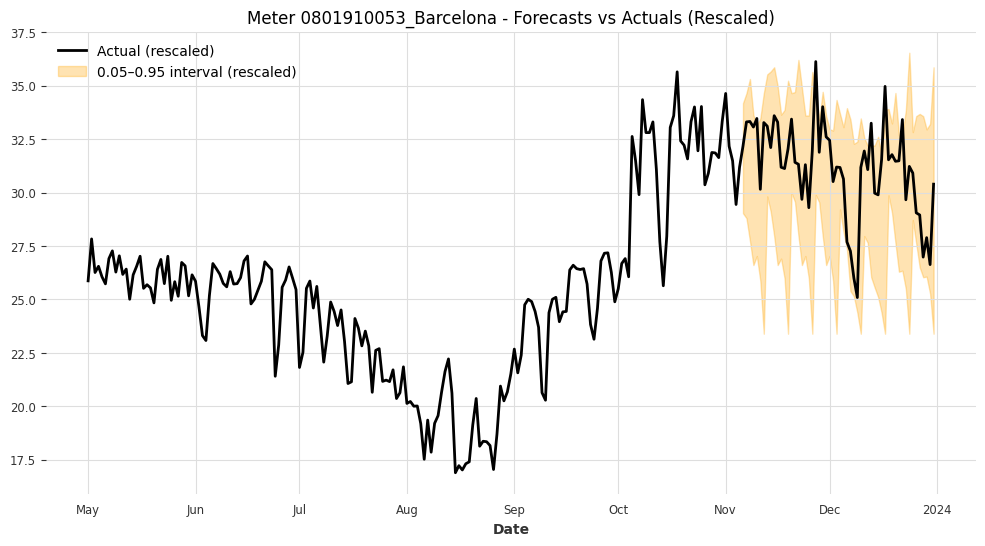

Meter 0801910053_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 7.1859



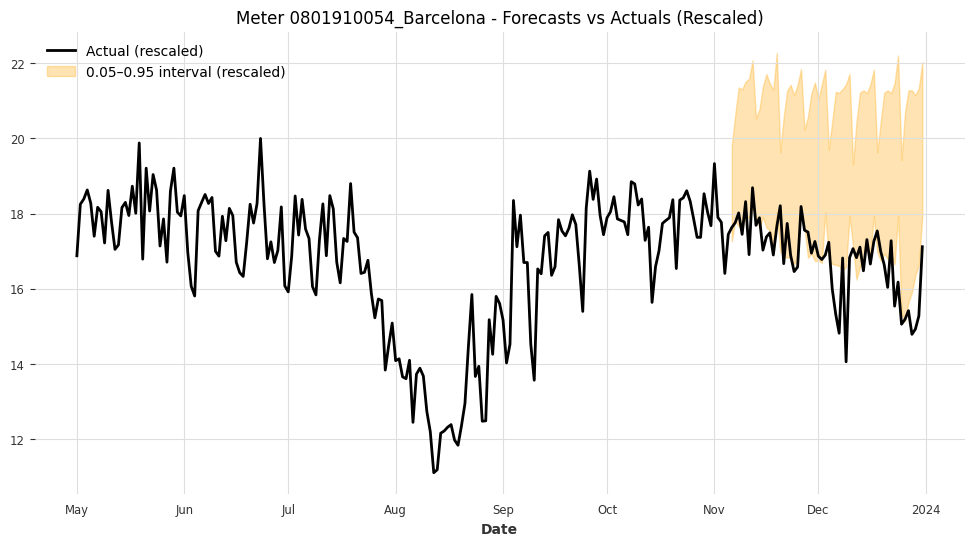

Meter 0801910054_Barcelona - Coverage: 0.4107, Mean Interval Width (rescaled): 4.0419



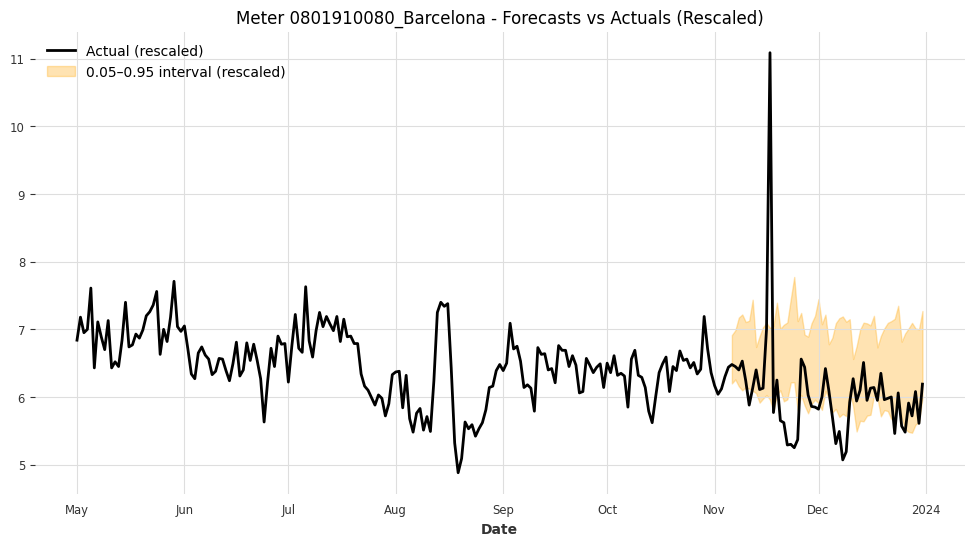

Meter 0801910080_Barcelona - Coverage: 0.5893, Mean Interval Width (rescaled): 1.1966



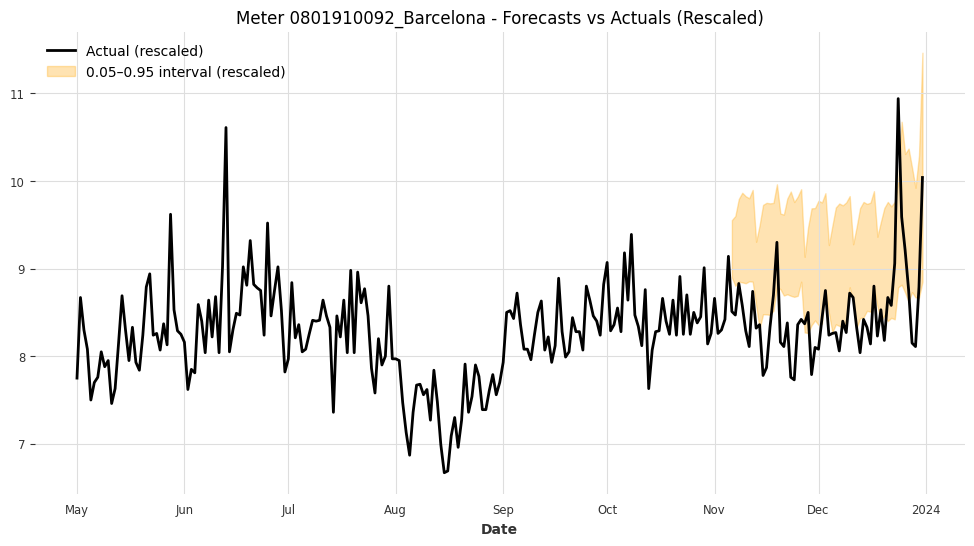

Meter 0801910092_Barcelona - Coverage: 0.3393, Mean Interval Width (rescaled): 1.2020



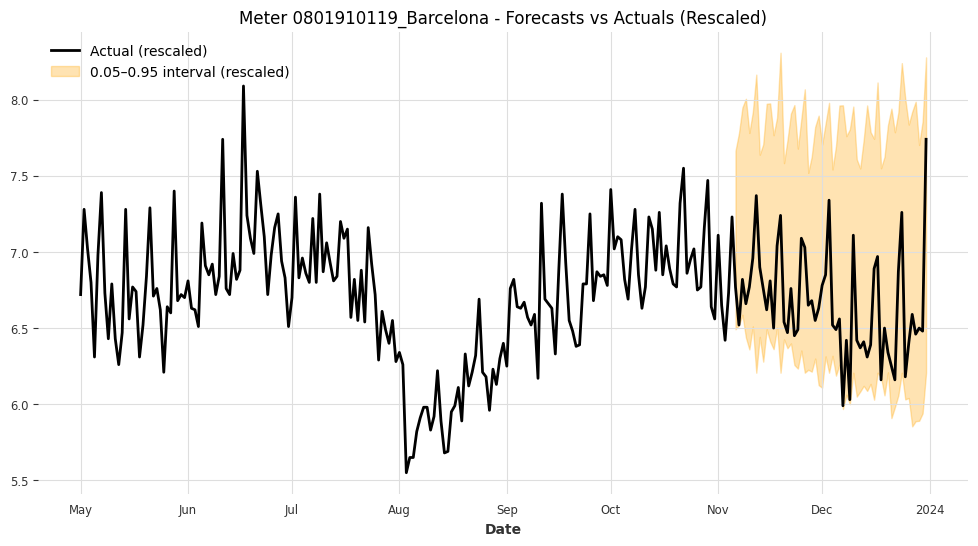

Meter 0801910119_Barcelona - Coverage: 0.9821, Mean Interval Width (rescaled): 1.6369



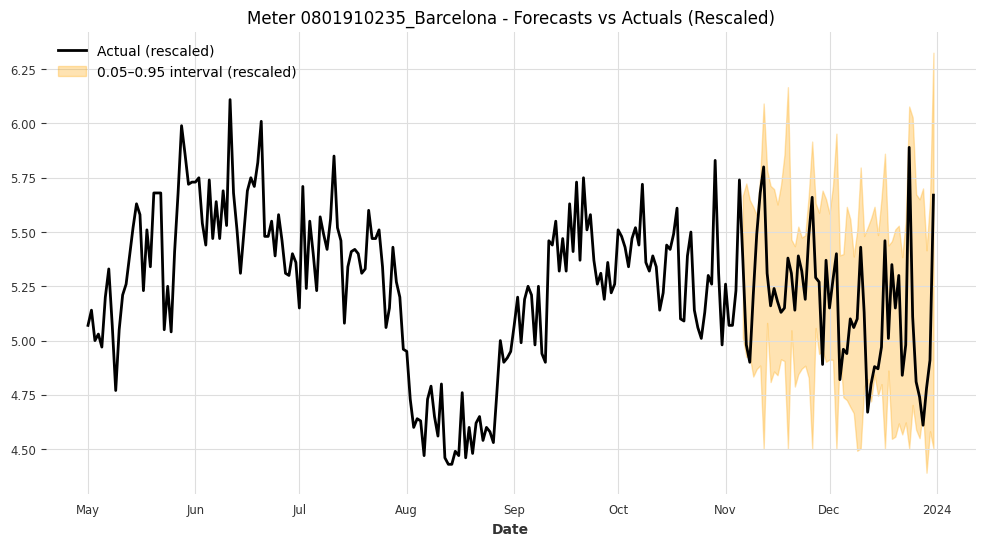

Meter 0801910235_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 0.9029



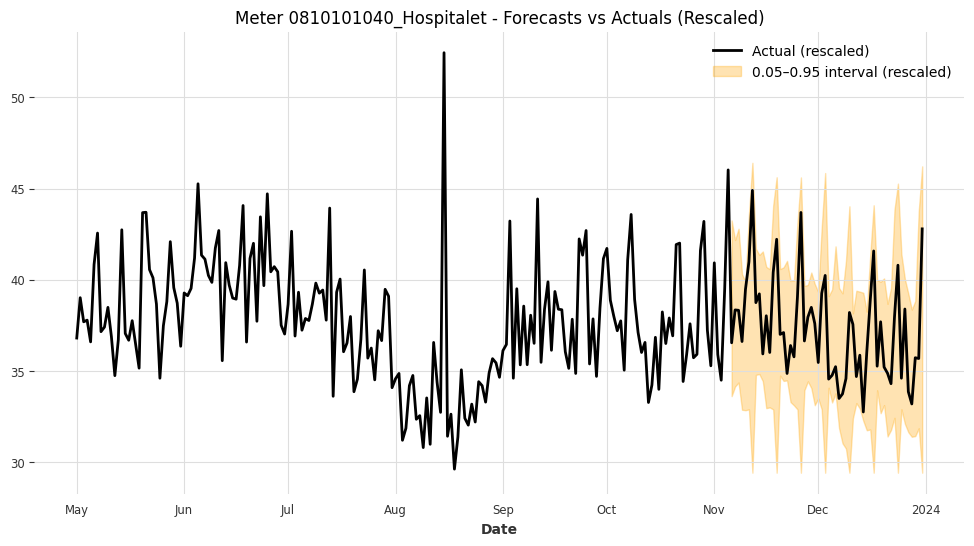

Meter 0810101040_Hospitalet - Coverage: 1.0000, Mean Interval Width (rescaled): 8.7787



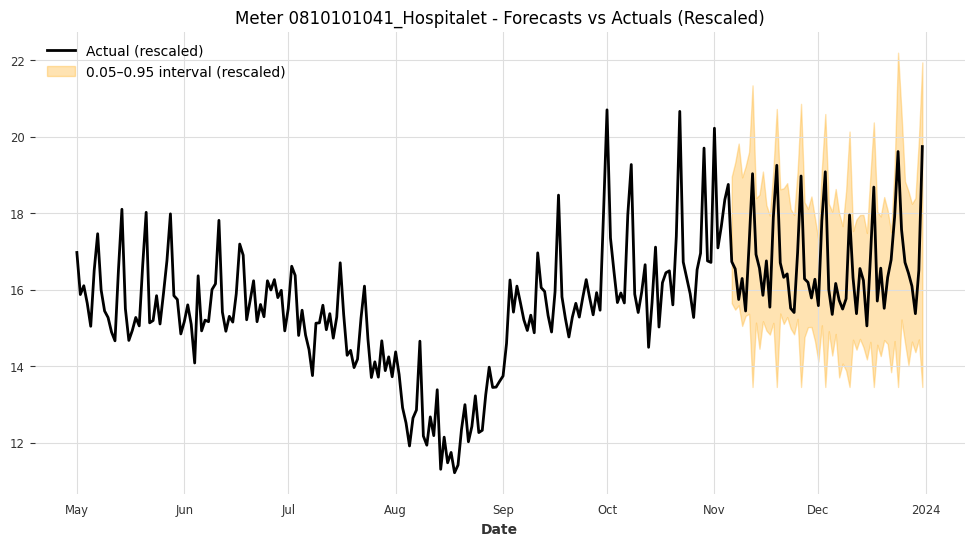

Meter 0810101041_Hospitalet - Coverage: 1.0000, Mean Interval Width (rescaled): 4.2866



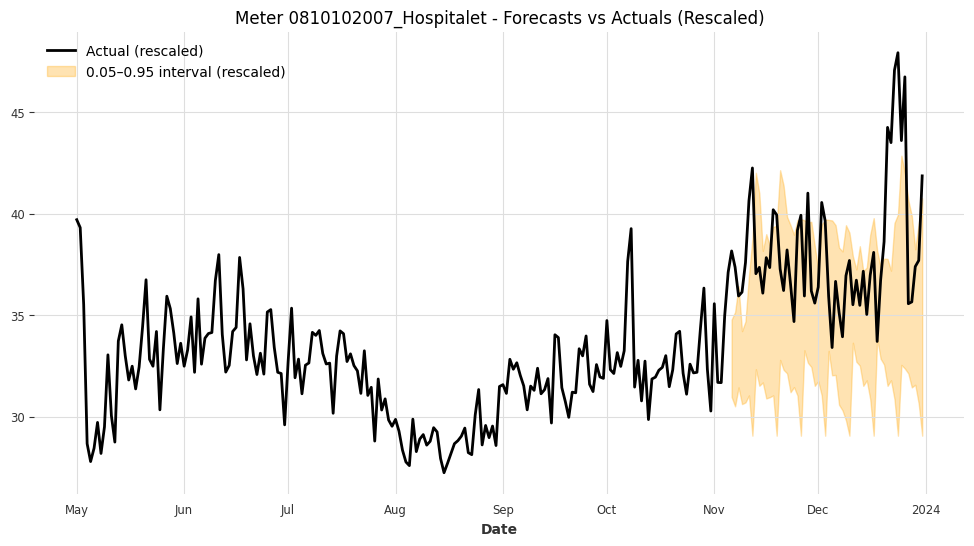

Meter 0810102007_Hospitalet - Coverage: 0.6429, Mean Interval Width (rescaled): 7.5096



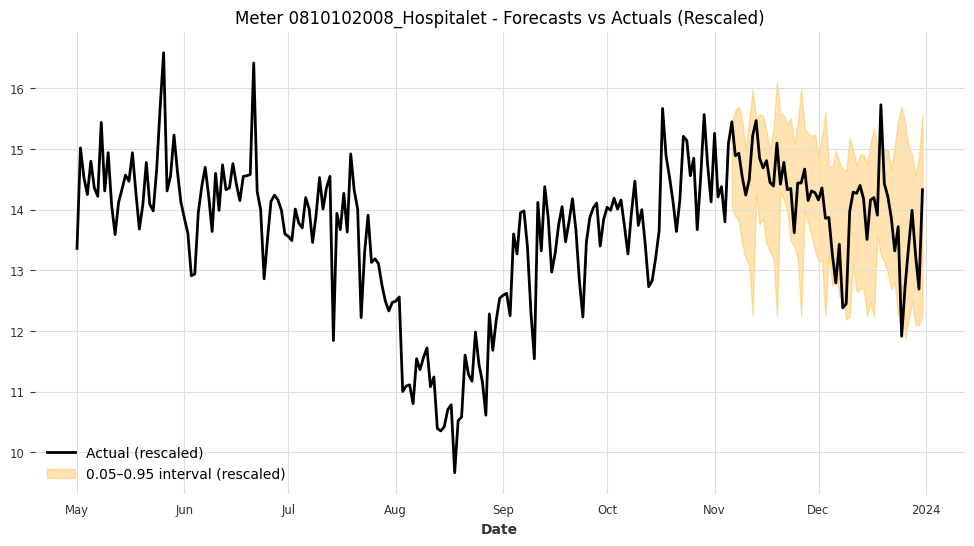

Meter 0810102008_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 2.1999



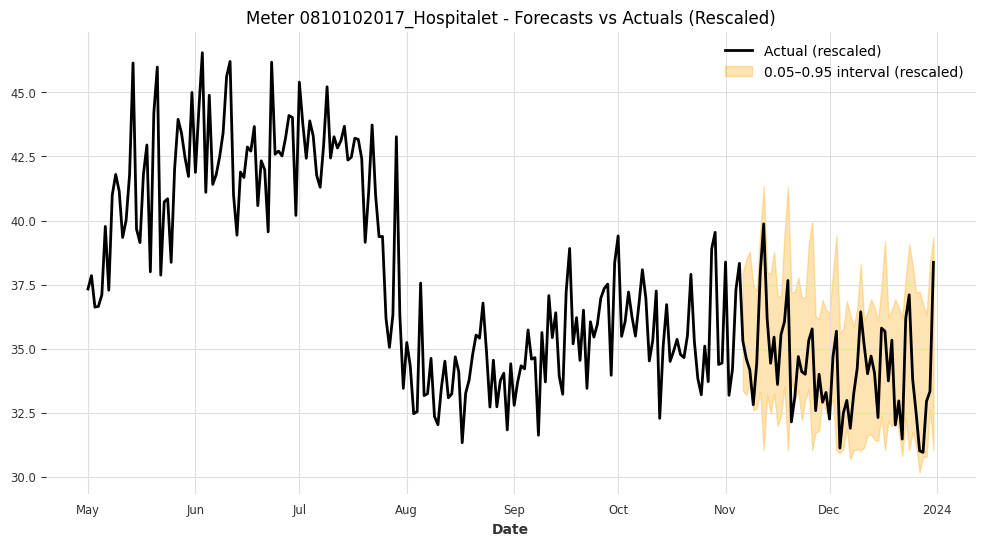

Meter 0810102017_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 5.5271



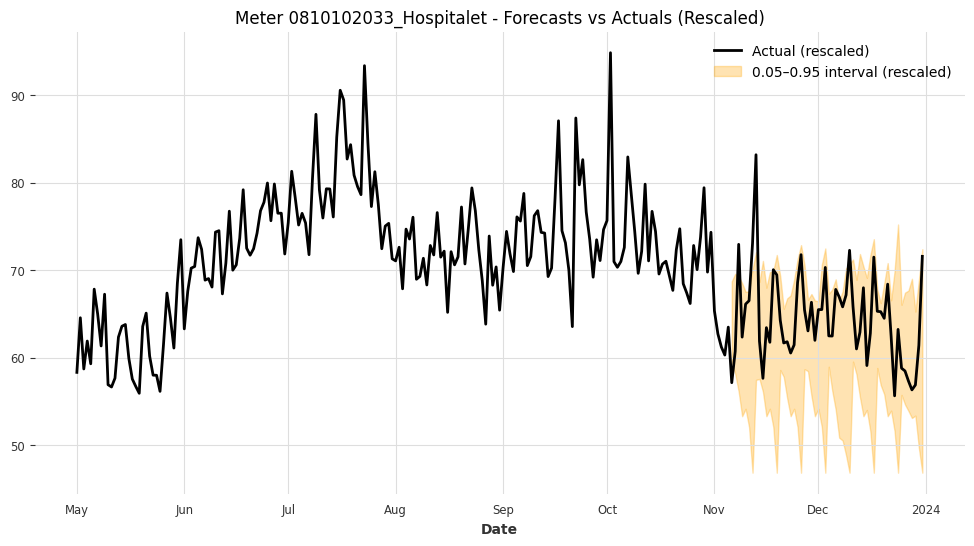

Meter 0810102033_Hospitalet - Coverage: 0.8750, Mean Interval Width (rescaled): 15.4871



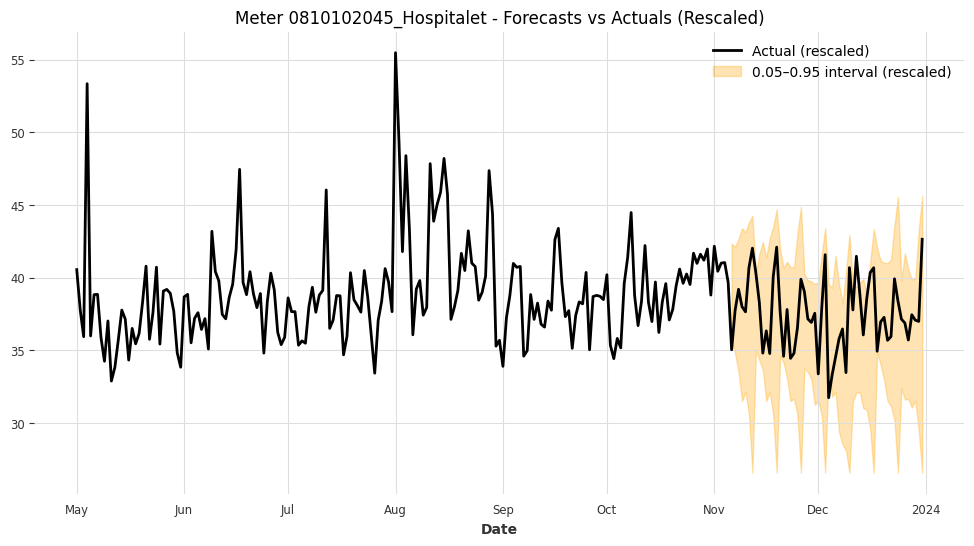

Meter 0810102045_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 10.2515



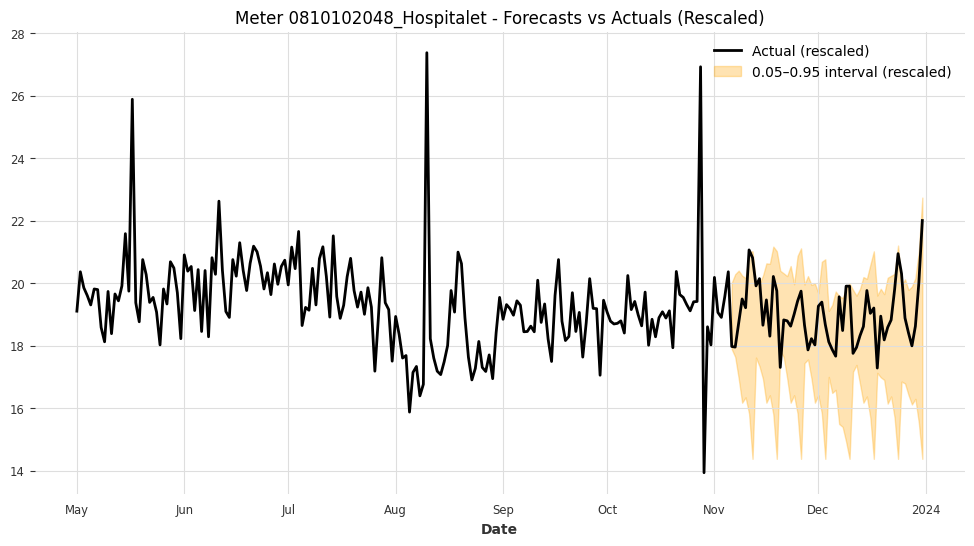

Meter 0810102048_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 4.0023



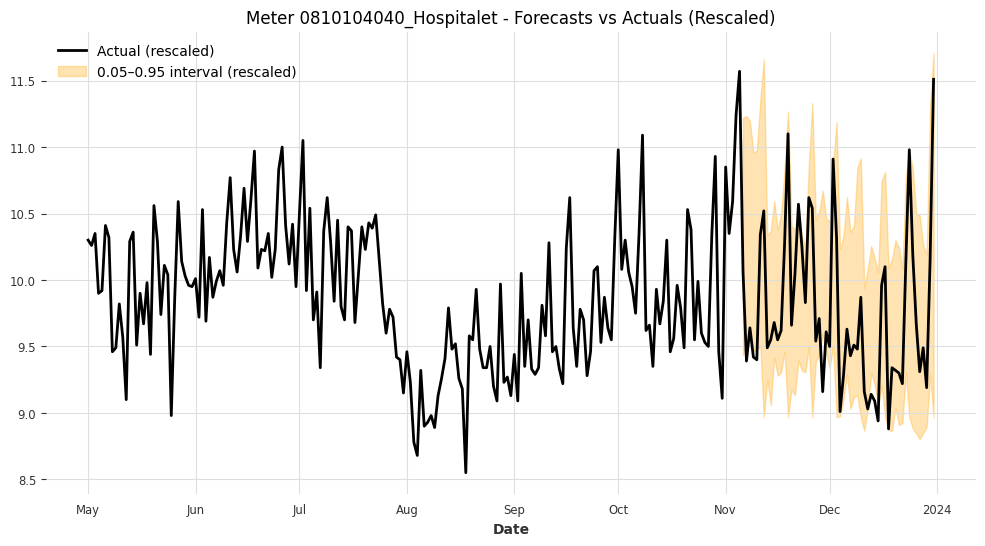

Meter 0810104040_Hospitalet - Coverage: 0.8214, Mean Interval Width (rescaled): 1.4545



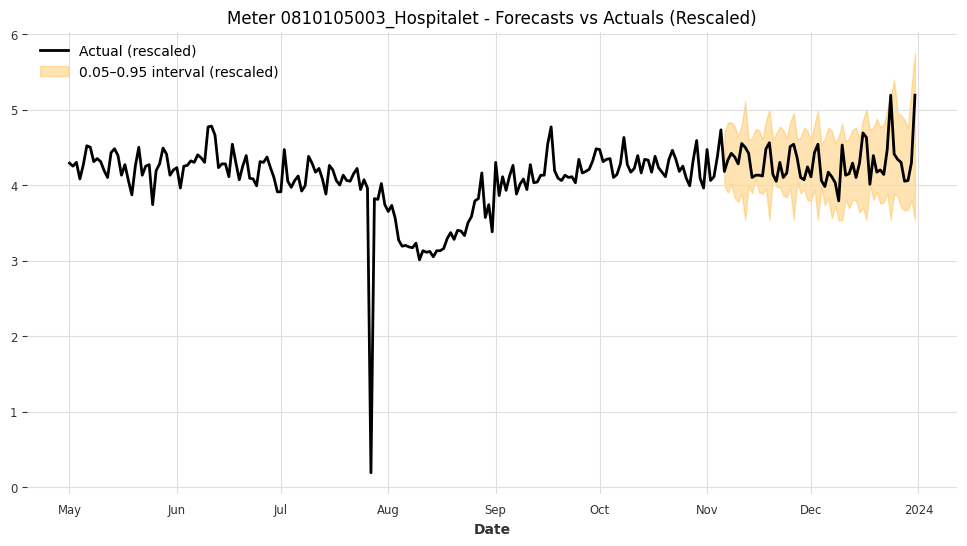

Meter 0810105003_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 0.9983



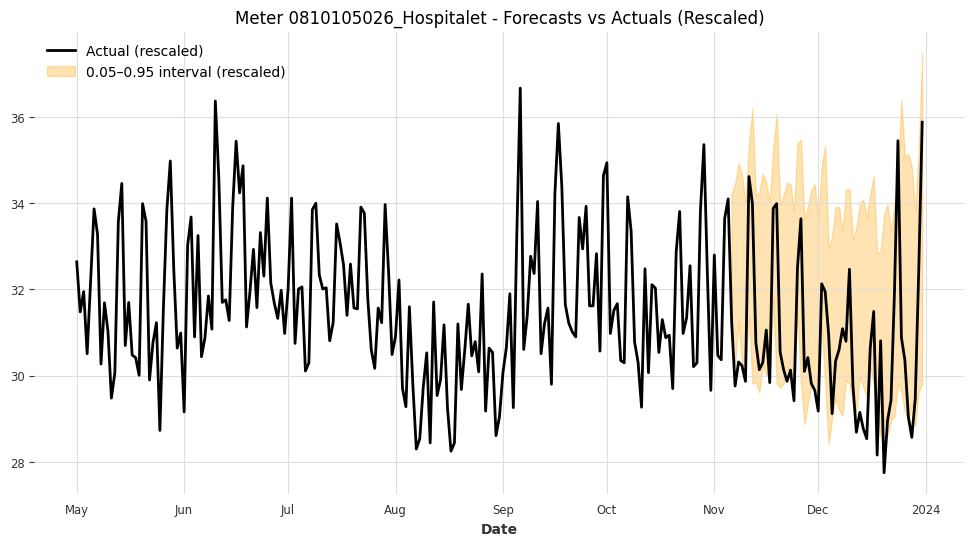

Meter 0810105026_Hospitalet - Coverage: 0.7143, Mean Interval Width (rescaled): 4.6372



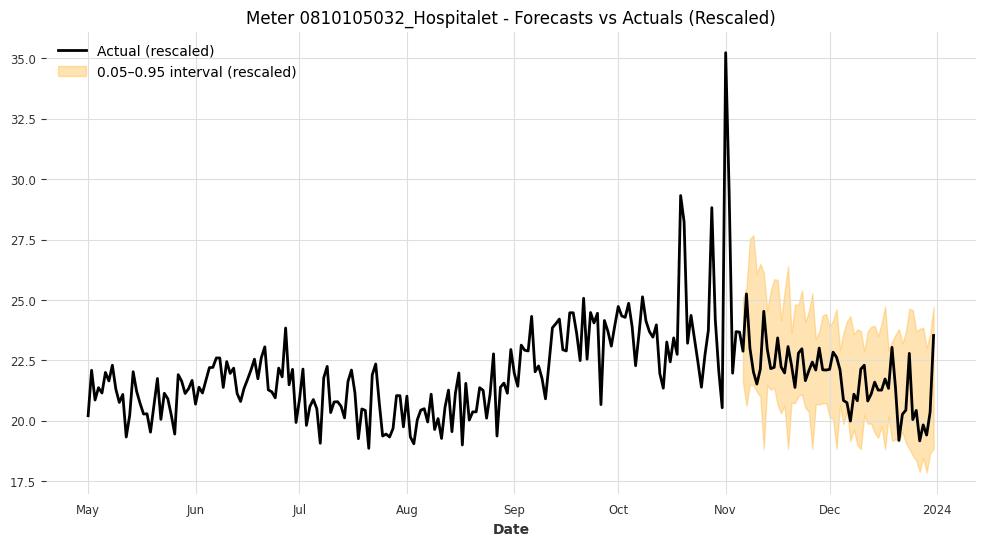

Meter 0810105032_Hospitalet - Coverage: 1.0000, Mean Interval Width (rescaled): 4.5248



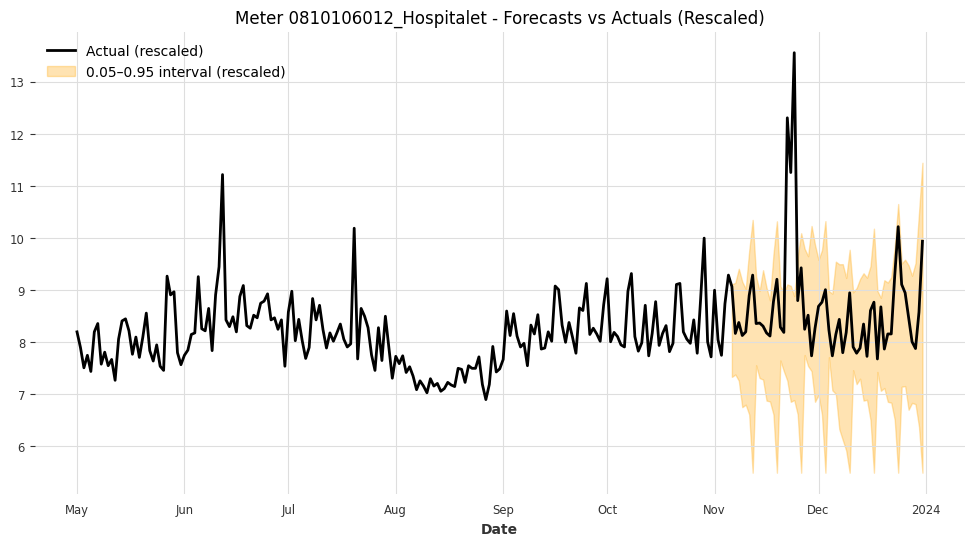

Meter 0810106012_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 2.7103



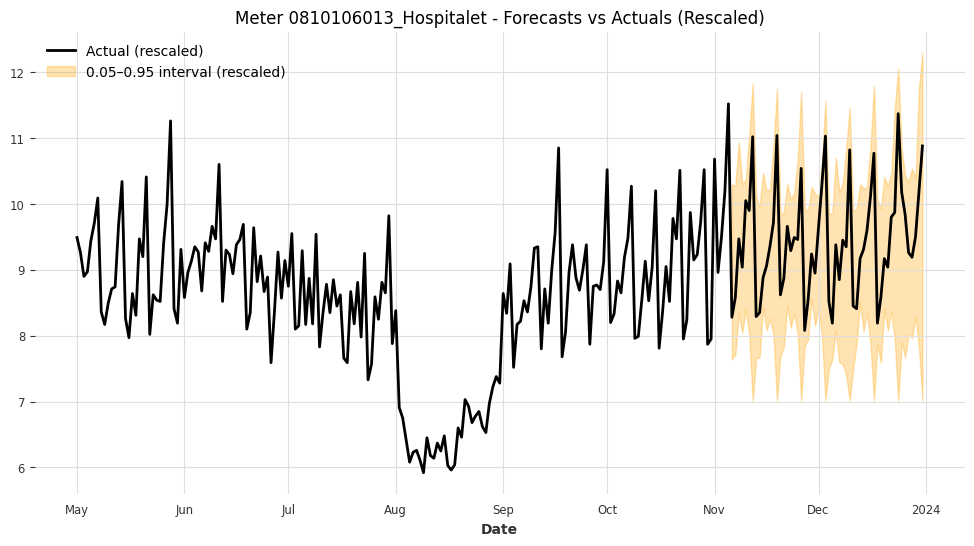

Meter 0810106013_Hospitalet - Coverage: 1.0000, Mean Interval Width (rescaled): 2.7124



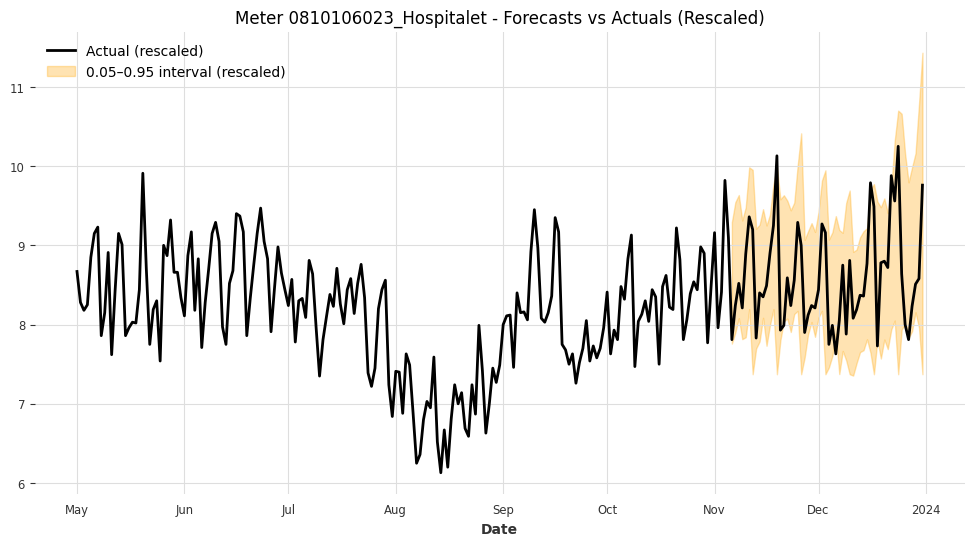

Meter 0810106023_Hospitalet - Coverage: 0.8571, Mean Interval Width (rescaled): 1.8518



In [ ]:
import matplotlib.pyplot as plt
from darts import concatenate  # We use this to merge forecast segments

for meter_id, hfcs in all_hfcs.items():
    # Get actual series (scaled)
    ts = scaled_calib_test_series[meter_id]

    # Get scaler and results
    scaler = scalers_test[meter_id]
    df_result = all_bt_results[meter_id]
    coverage = df_result["Coverage"].iloc[0]
    width_orig = df_result["Width"].iloc[0]

    # Start plot
    fig, ax = plt.subplots(figsize=(12, 6))

    # Plot actuals (rescaled)
    ts_orig = scaler.inverse_transform(ts)
    ts_orig.plot(ax=ax, label='Actual (rescaled)', lw=2)

    # Collect rescaled quantiles
    full_lower = []
    full_upper = []

    for forecast in hfcs:
        if ('Consumption per meter_q0.05' in forecast.components and
            'Consumption per meter_q0.95' in forecast.components):

            lower = forecast['Consumption per meter_q0.05']
            upper = forecast['Consumption per meter_q0.95']
            lower_orig = scaler.inverse_transform(lower)
            upper_orig = scaler.inverse_transform(upper)
            full_lower.append(lower_orig)
            full_upper.append(upper_orig)

    # Plot interval if available
    if full_lower and full_upper:
        combined_lower = concatenate(full_lower)
        combined_upper = concatenate(full_upper)

        ax.fill_between(
            combined_lower.time_index,
            combined_lower.values().flatten(),
            combined_upper.values().flatten(),
            color='orange',
            alpha=0.3,
            label='0.05–0.95 interval (rescaled)'
        )

    # Finalize plot
    ax.set_title(f"Meter {meter_id} - Forecasts vs Actuals (Rescaled)")
    ax.legend()
    plt.show()

    # Show metrics
    print(f"Meter {meter_id} - Coverage: {coverage:.4f}, Mean Interval Width (rescaled): {width_orig:.4f}\n")


In [ ]:
# Let's try with a improved version of the test set (more real time series)

In [ ]:
# Load model
model = LightGBMModel.load("/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/lightGBM/covariates/lightgbm_model_covariates.pkl")
# We load the test data
test_data = joblib.load('/content/drive/MyDrive/Colab Notebooks/TFG/data/01_datasets/train_test_reduced/scaled_test_reduced.pkl')
print(test_data.keys())

# Extract components
scaled_calib_test_series = test_data['calib_test']
scalers_test = test_data['scalers']           # the scalers to reescale the series later

# Reuse the same sorted meter IDs to align
meter_ids_test = sorted(scaled_calib_test_series.keys())

# Build aligned lists
test_series_scaled = [scaled_calib_test_series[meter_id] for meter_id in meter_ids_test]

print(f"Loaded {len(test_series_scaled)} time series for testing.")

dict_keys(['train', 'validation', 'calib_test', 'scalers'])
Loaded 60 time series for testing.


In [ ]:
# We build the future covariates for the test set
future_covariates_test = []

for test_ts in test_series_scaled:
    test_cov = concatenate([
        datetime_attribute_timeseries(test_ts, "day_of_week", one_hot=True),
        datetime_attribute_timeseries(test_ts, "month", one_hot=True),
        is_weekend_timeseries.slice_intersect(test_ts),
        holiday_timeseries.slice_intersect(test_ts),
        day_of_year_timeseries.slice_intersect(test_ts)
    ], axis=1)

    future_covariates_test.append(test_cov)


In [ ]:
import pandas as pd

# Constants
start_date = pd.Timestamp("2023-11-6")
quantiles = [0.05, 0.5, 0.95]
pred_kwargs={"predict_likelihood_parameters": True, "verbose": True}
q_interval = [(0.05, 0.95)]
q_range = [0.9]

# Prepare to collect results
all_hfcs = {}
all_bt_results = {}

# We loop over each time series (one per meter)
for meter_id, ts, fcov in zip(meter_ids_test, test_series_scaled, future_covariates_test):

    # Historical forecasts
    hfcs = model.historical_forecasts(
        series=ts,
        future_covariates=fcov,
        forecast_horizon=7,
        start=start_date,
        last_points_only=False,
        stride=7,
        retrain=False,
        **pred_kwargs,
    )

    scaler = scalers_test[meter_id]
    widths = []

    for forecast in hfcs:
        q05 = forecast["Consumption per meter_q0.05"]
        q95 = forecast["Consumption per meter_q0.95"]
        q05_orig = scaler.inverse_transform(q05)
        q95_orig = scaler.inverse_transform(q95)
        width = (q95_orig - q05_orig).values()
        widths.append(width)

    mean_width = np.mean([np.mean(w) for w in widths])


    # We backtest (evaluate) the generated predictions
    bt = model.backtest(
        series=ts,
        future_covariates=fcov,
        historical_forecasts=hfcs,
        last_points_only=False,
        metric=[metrics.mic, metrics.miw],
        metric_kwargs={"q_interval": q_interval},
        retrain=False,
    )
    df_results = pd.DataFrame({"Interval": q_range, "Coverage": bt[0], "Width": mean_width})

    # Store results
    all_hfcs[meter_id] = hfcs
    all_bt_results[meter_id] = df_results

# We combine results across meters
combined_results = pd.concat(all_bt_results.values(), keys=all_bt_results.keys())
combined_results.reset_index(level=1, drop=True, inplace=True)


historical forecasts: 100%|██████████| 1/1 [00:00<00:00, 24.05it/s]


In [ ]:
mean_coverage = combined_results["Coverage"].mean()
mean_width = combined_results["Width"].mean()

print(f"Mean Coverage: {mean_coverage:.4f}")
print(f"Mean Width: {mean_width:.4f}")

Mean Coverage: 0.9089
Mean Width: 4.9474


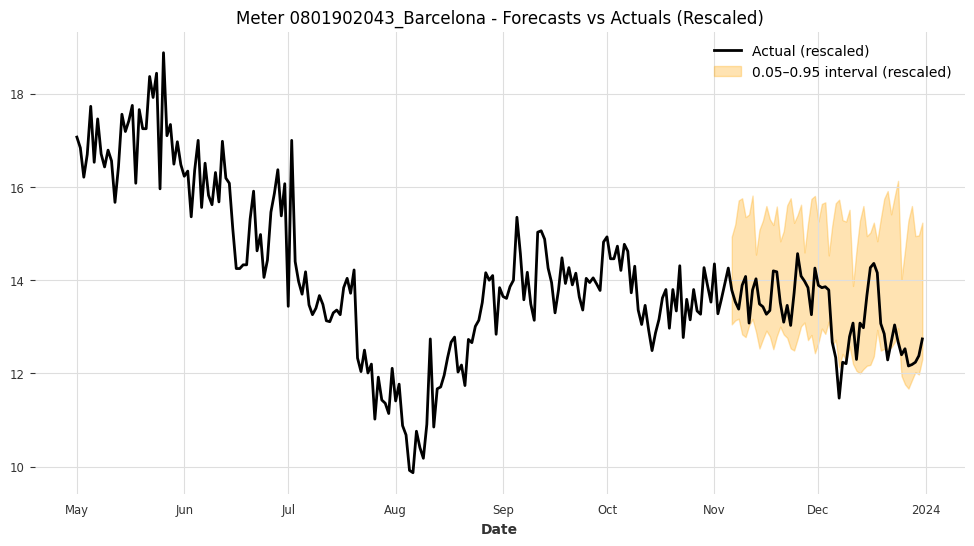

Meter 0801902043_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 2.7019



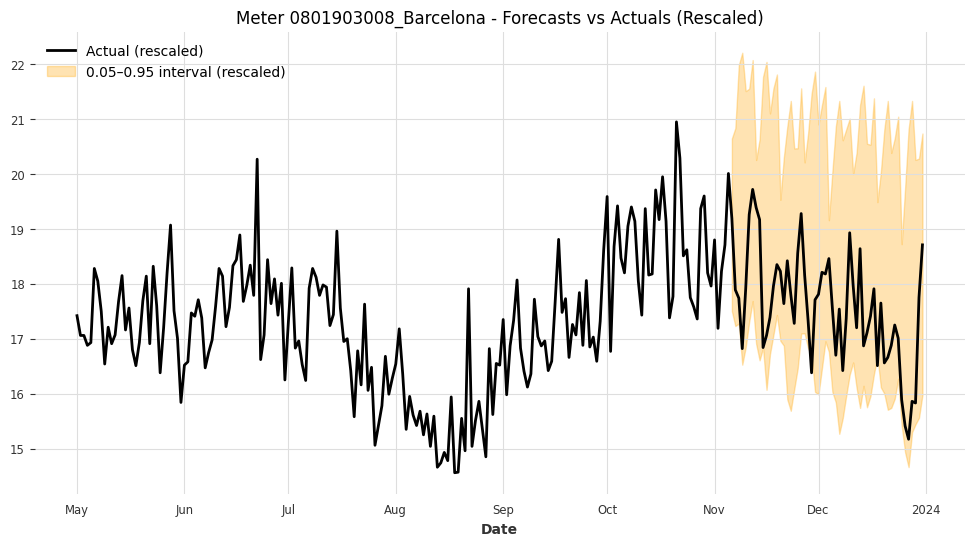

Meter 0801903008_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 4.5441



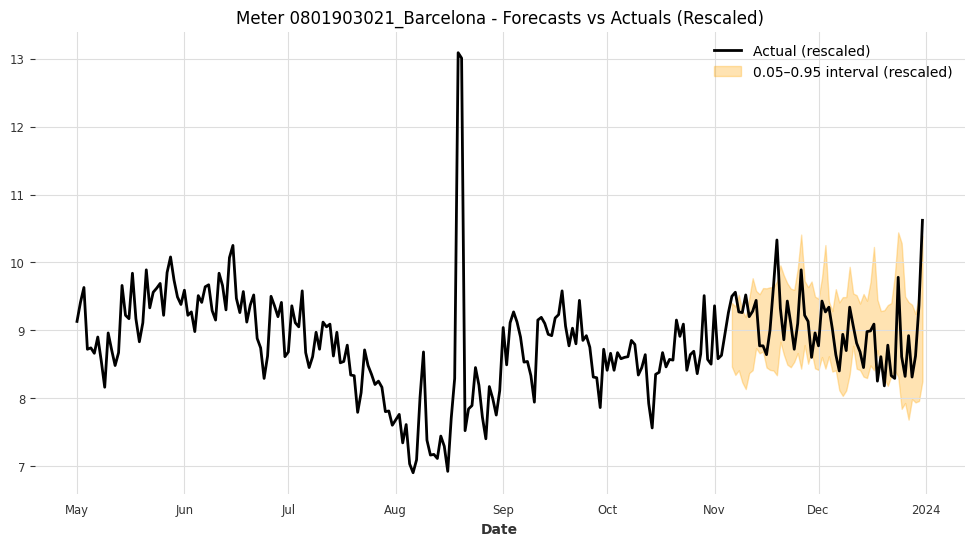

Meter 0801903021_Barcelona - Coverage: 0.8214, Mean Interval Width (rescaled): 1.2454



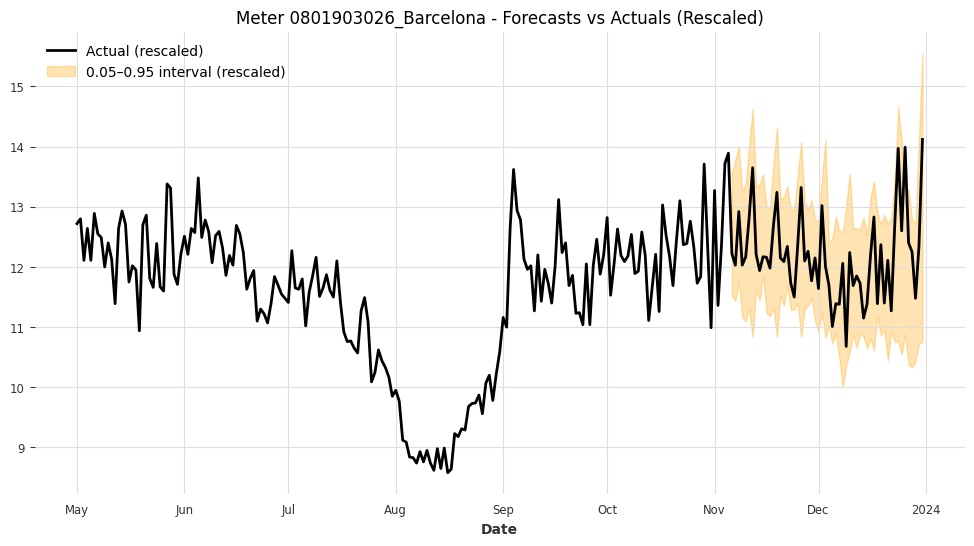

Meter 0801903026_Barcelona - Coverage: 0.9821, Mean Interval Width (rescaled): 2.2901



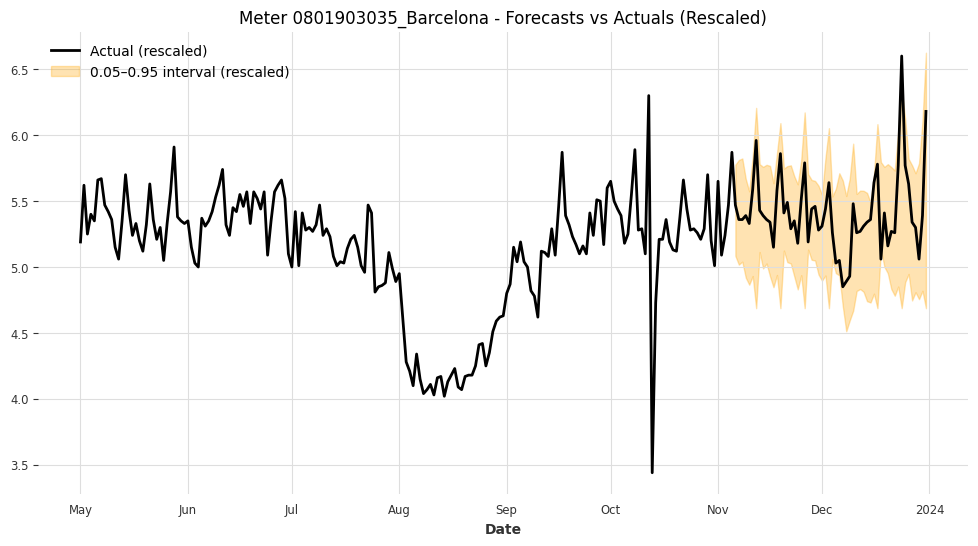

Meter 0801903035_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 0.9149



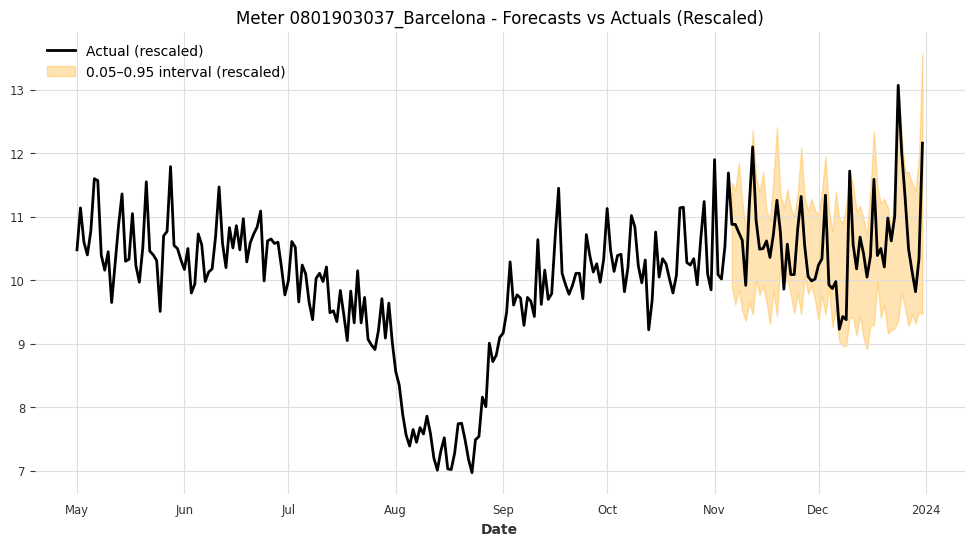

Meter 0801903037_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 1.9280



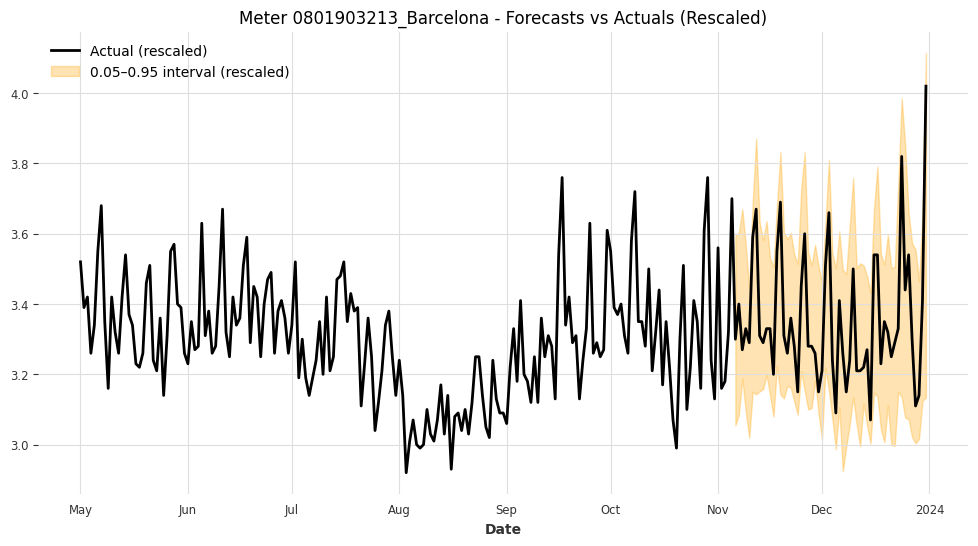

Meter 0801903213_Barcelona - Coverage: 1.0000, Mean Interval Width (rescaled): 0.5190



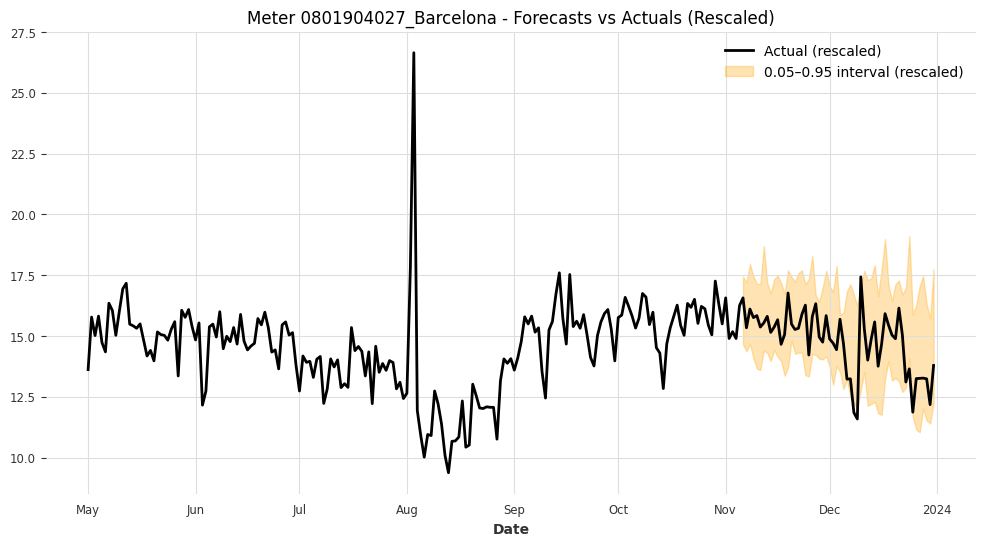

Meter 0801904027_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 3.9102



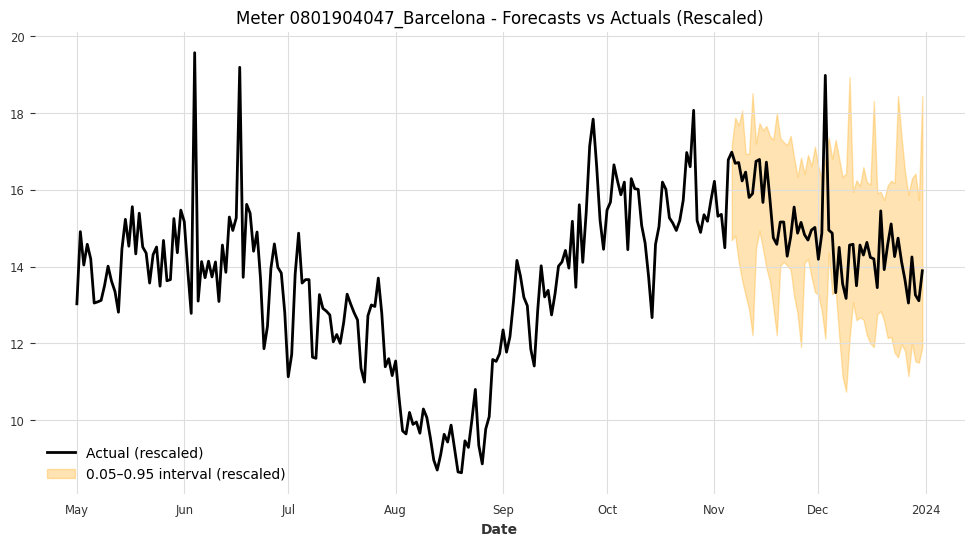

Meter 0801904047_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 4.0506



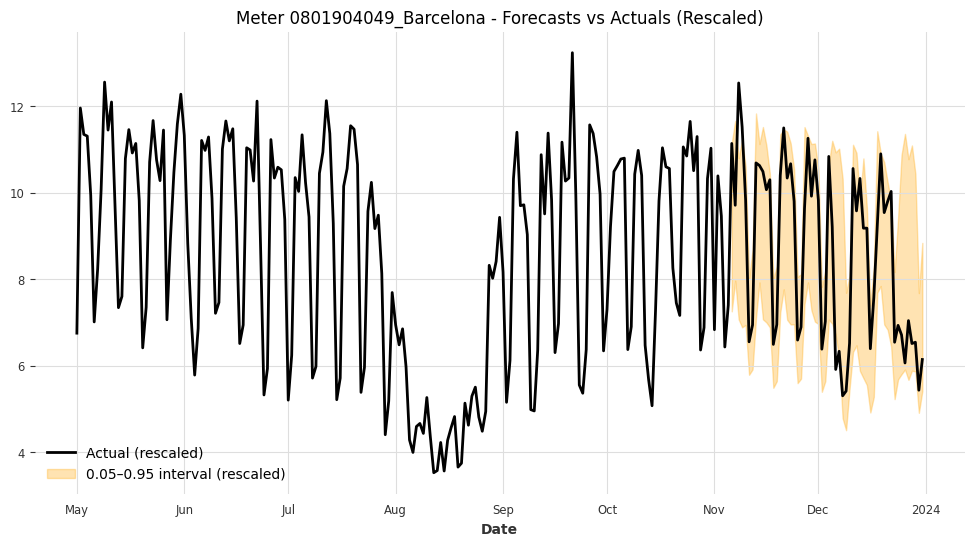

Meter 0801904049_Barcelona - Coverage: 0.8750, Mean Interval Width (rescaled): 3.7518



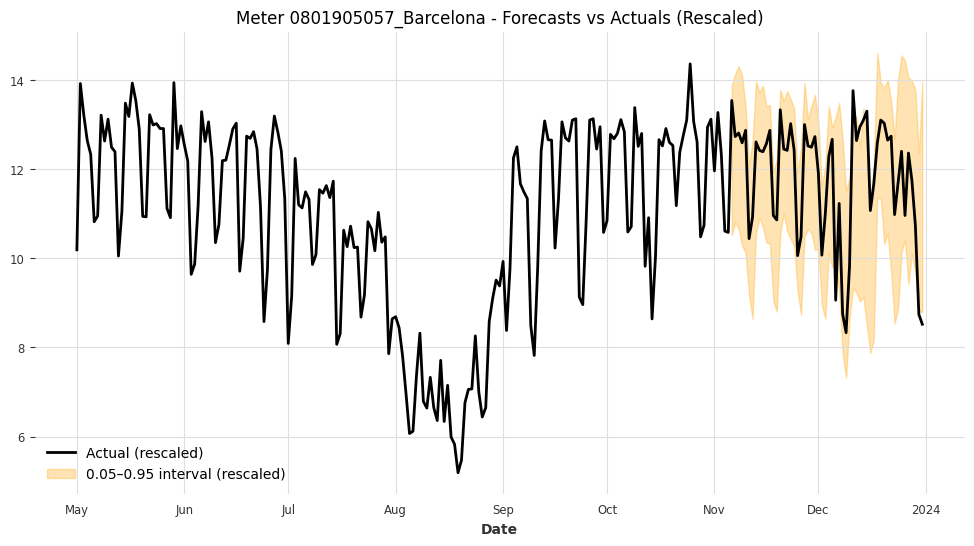

Meter 0801905057_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 3.5271



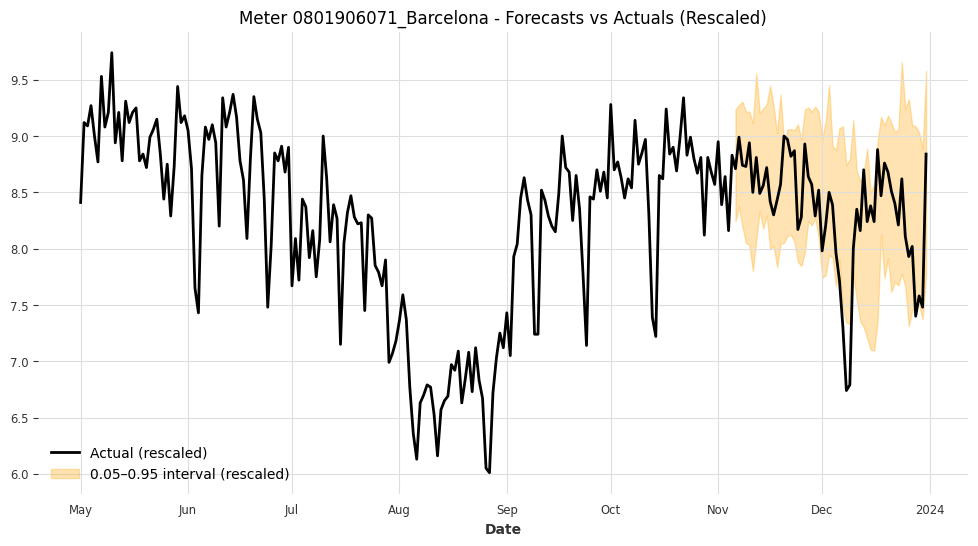

Meter 0801906071_Barcelona - Coverage: 0.8750, Mean Interval Width (rescaled): 1.2946



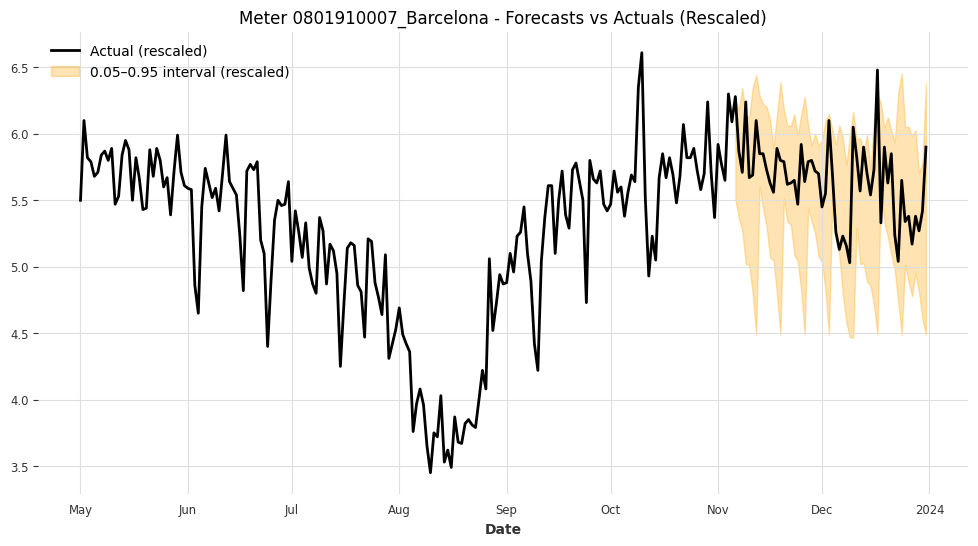

Meter 0801910007_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 1.0940



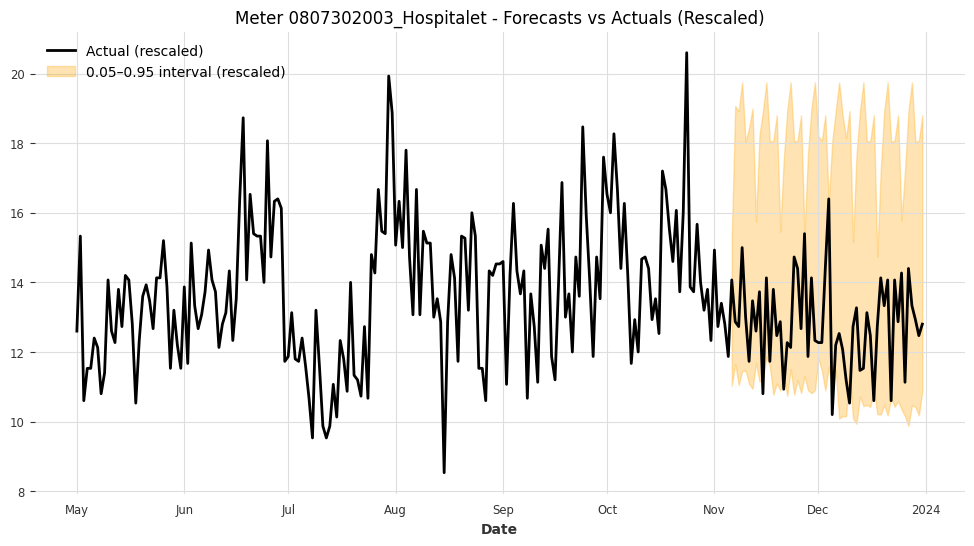

Meter 0807302003_Hospitalet - Coverage: 0.8571, Mean Interval Width (rescaled): 7.3180



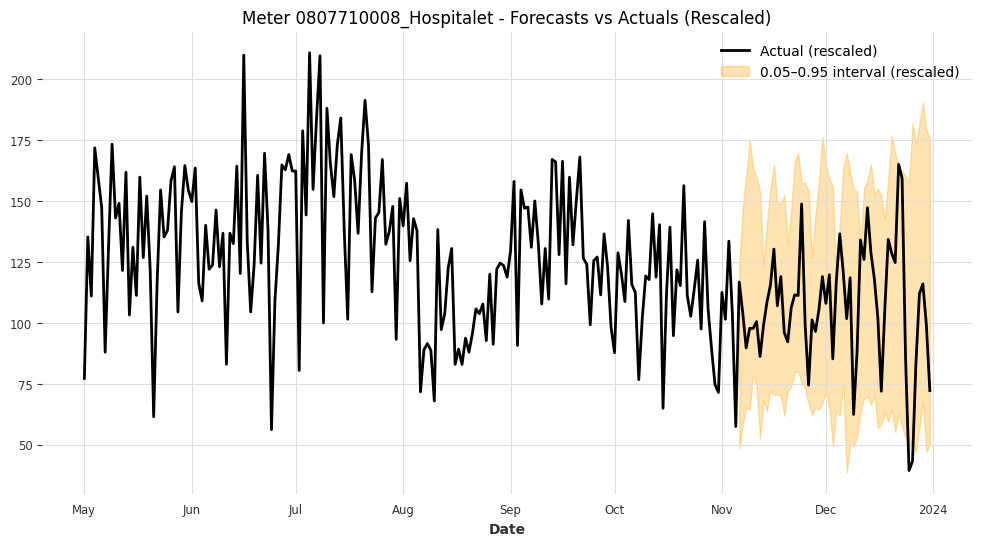

Meter 0807710008_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 94.2517



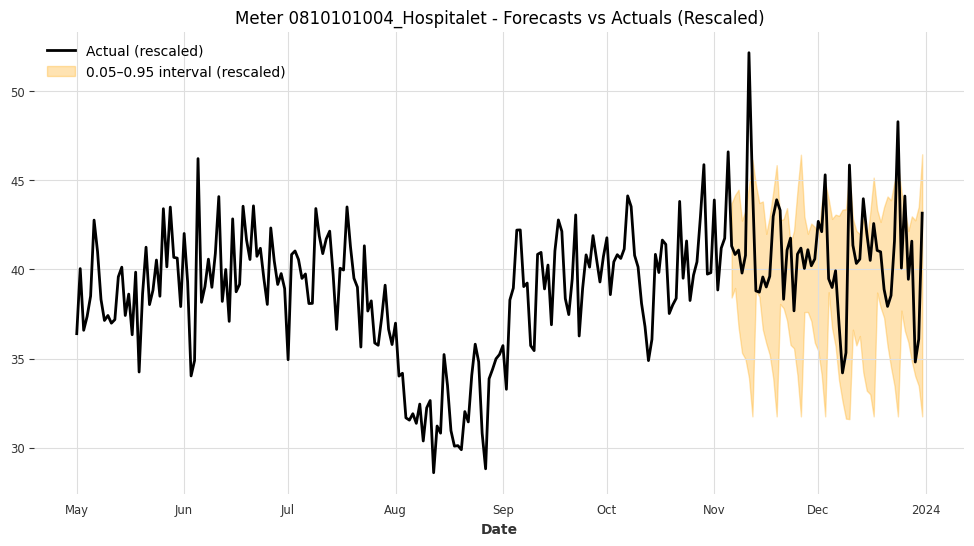

Meter 0810101004_Hospitalet - Coverage: 0.8036, Mean Interval Width (rescaled): 8.2774



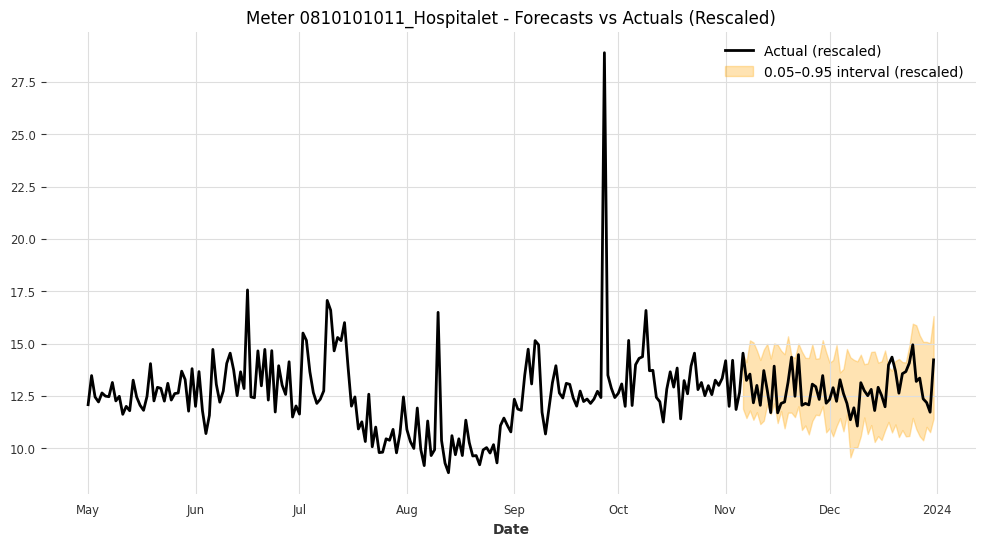

Meter 0810101011_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 3.4900



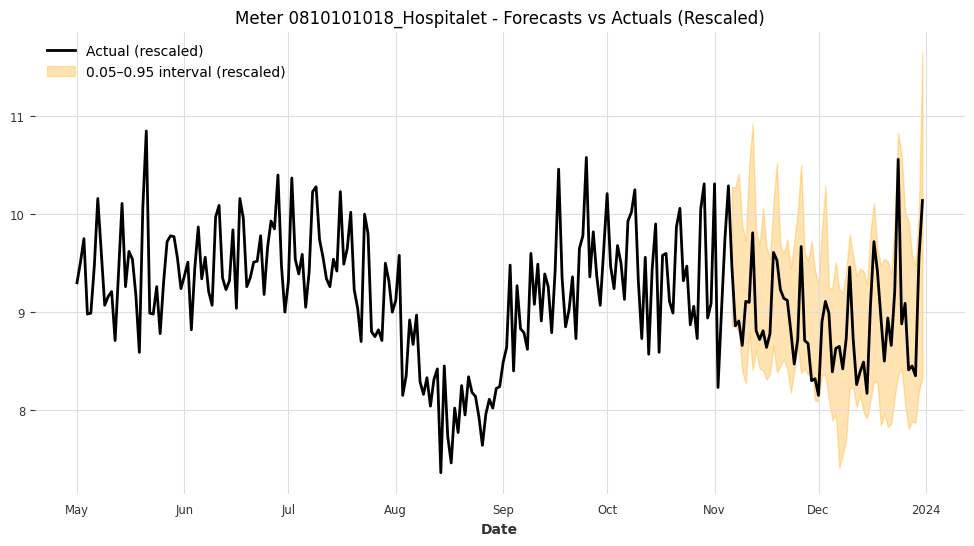

Meter 0810101018_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 1.5910



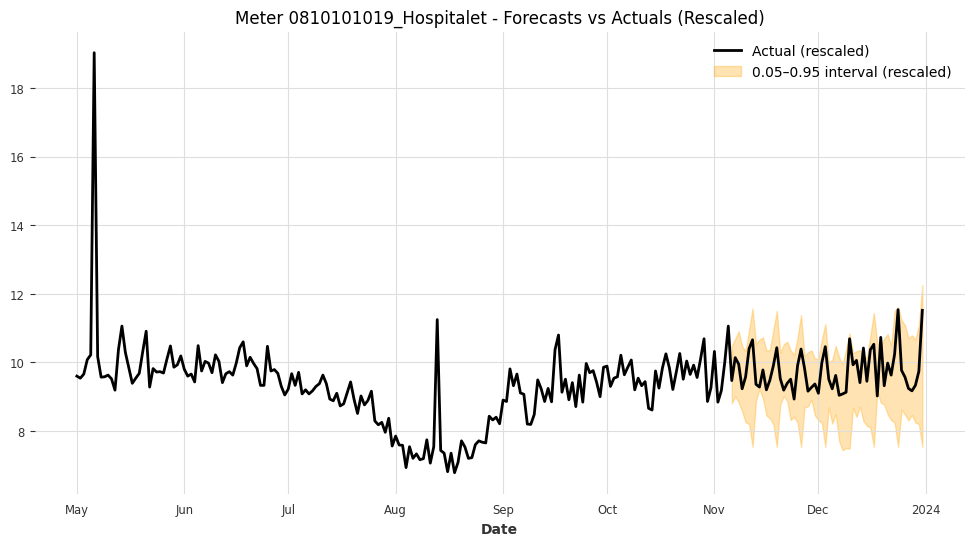

Meter 0810101019_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 2.3110



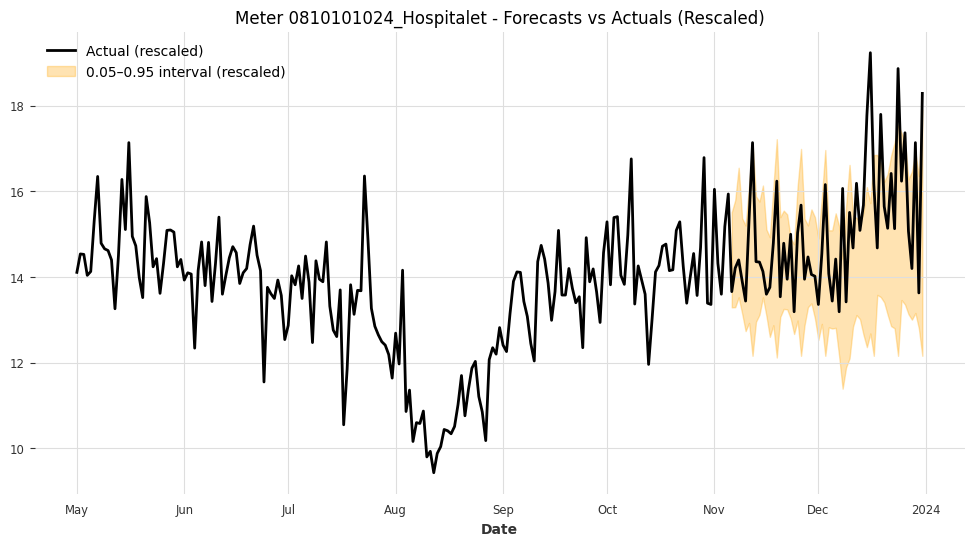

Meter 0810101024_Hospitalet - Coverage: 0.7857, Mean Interval Width (rescaled): 3.1405



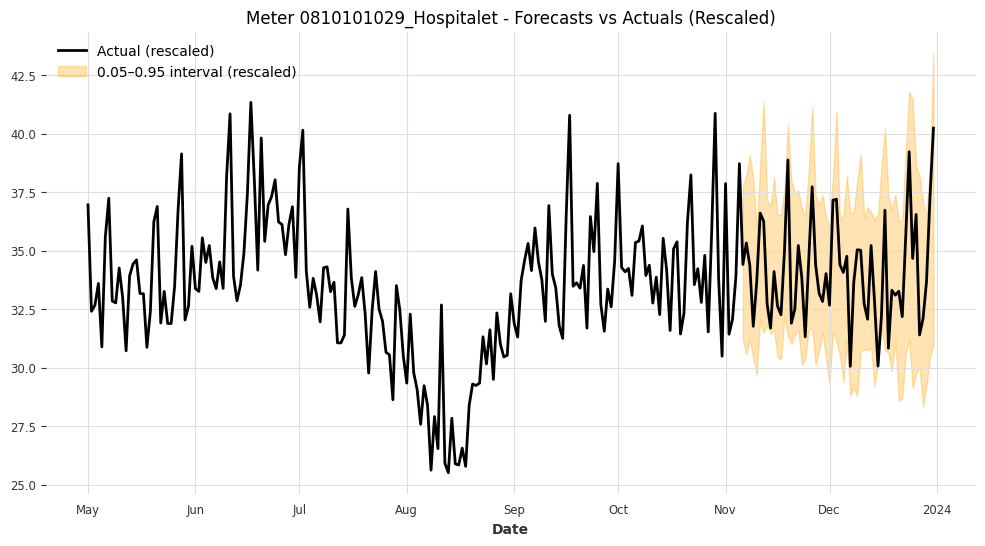

Meter 0810101029_Hospitalet - Coverage: 0.9821, Mean Interval Width (rescaled): 7.3917



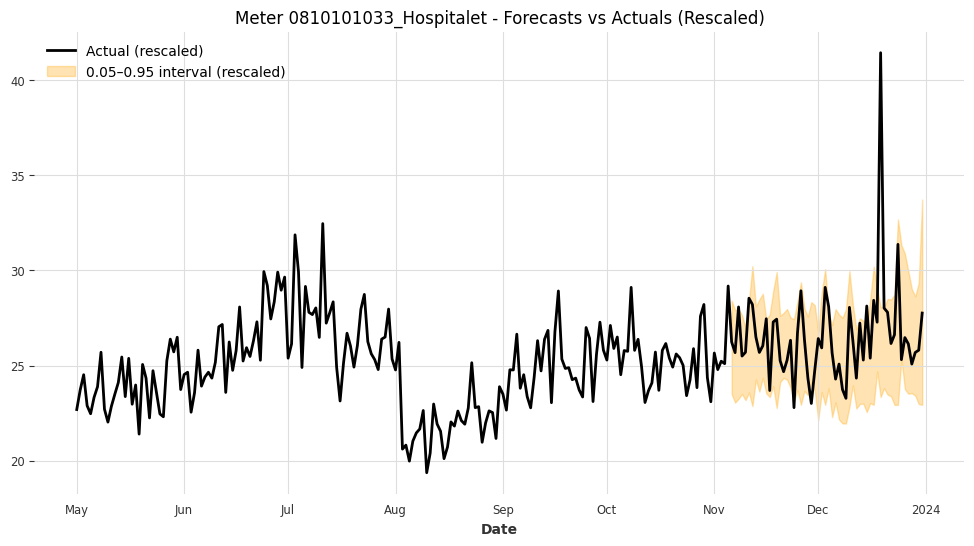

Meter 0810101033_Hospitalet - Coverage: 0.8393, Mean Interval Width (rescaled): 5.1891



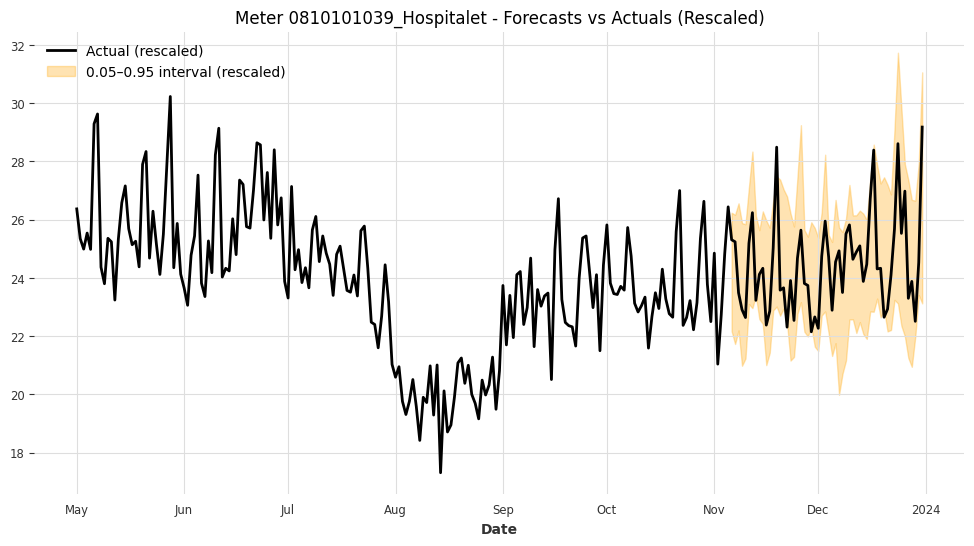

Meter 0810101039_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 4.6808



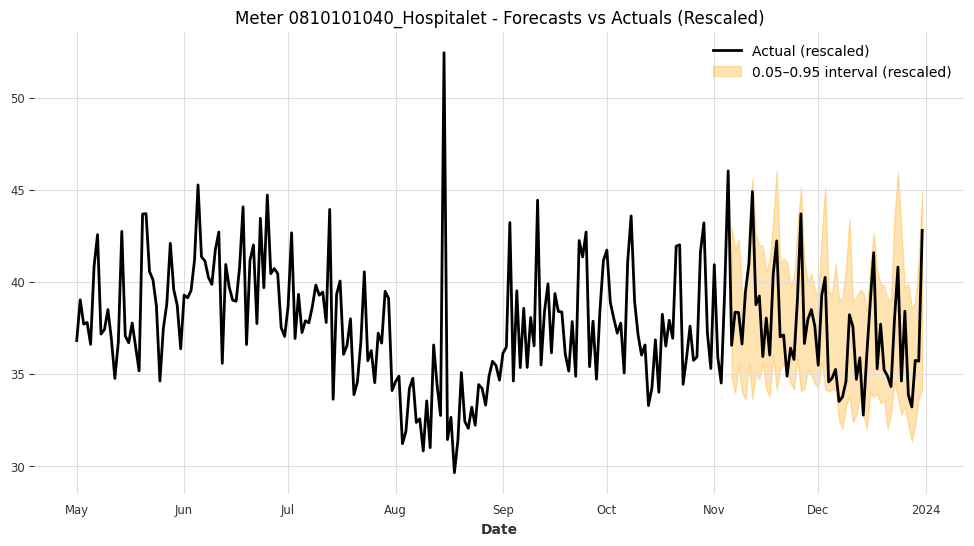

Meter 0810101040_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 7.2479



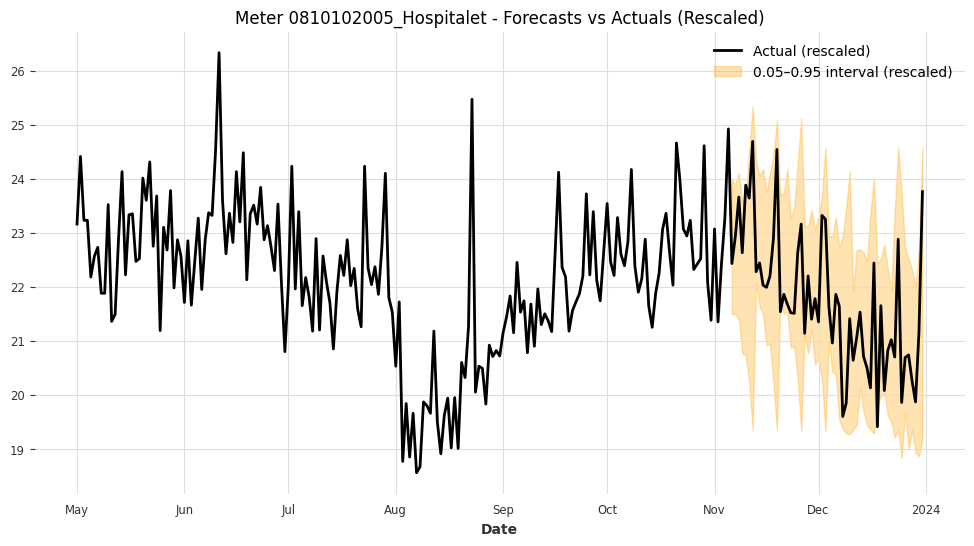

Meter 0810102005_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 3.2911



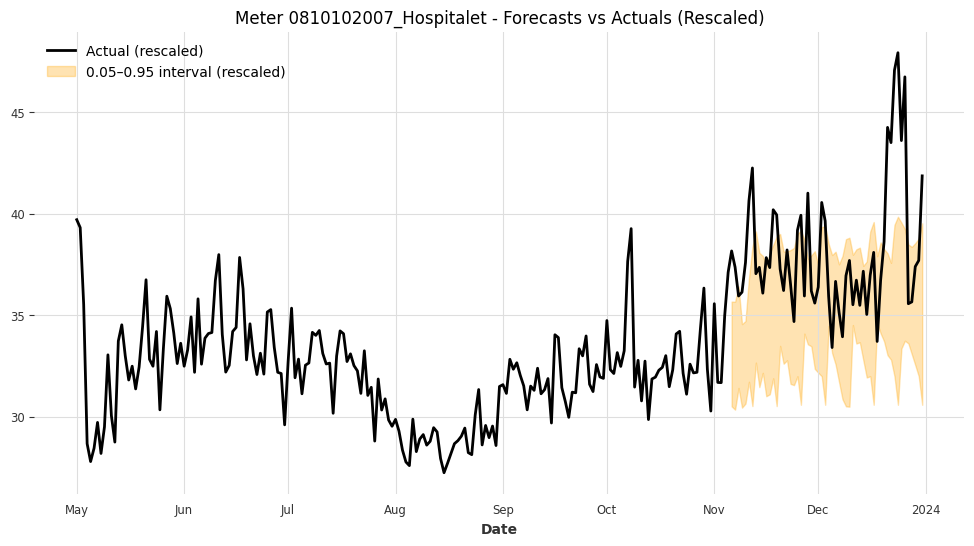

Meter 0810102007_Hospitalet - Coverage: 0.5714, Mean Interval Width (rescaled): 5.9860



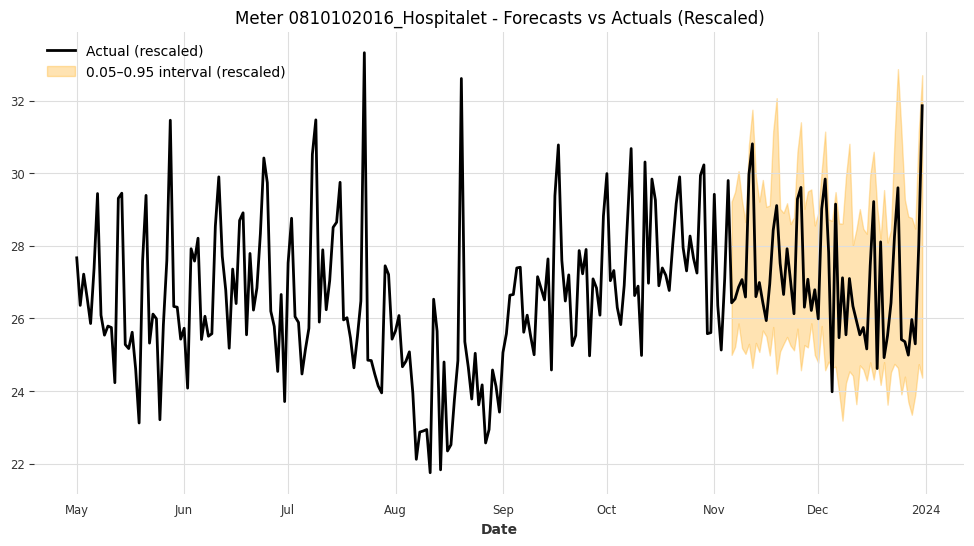

Meter 0810102016_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 4.8444



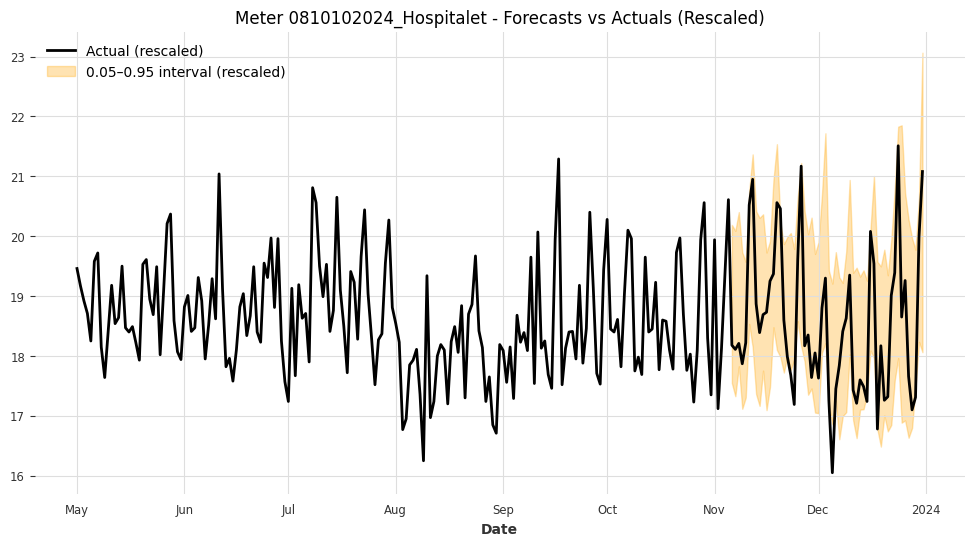

Meter 0810102024_Hospitalet - Coverage: 0.8750, Mean Interval Width (rescaled): 2.7558



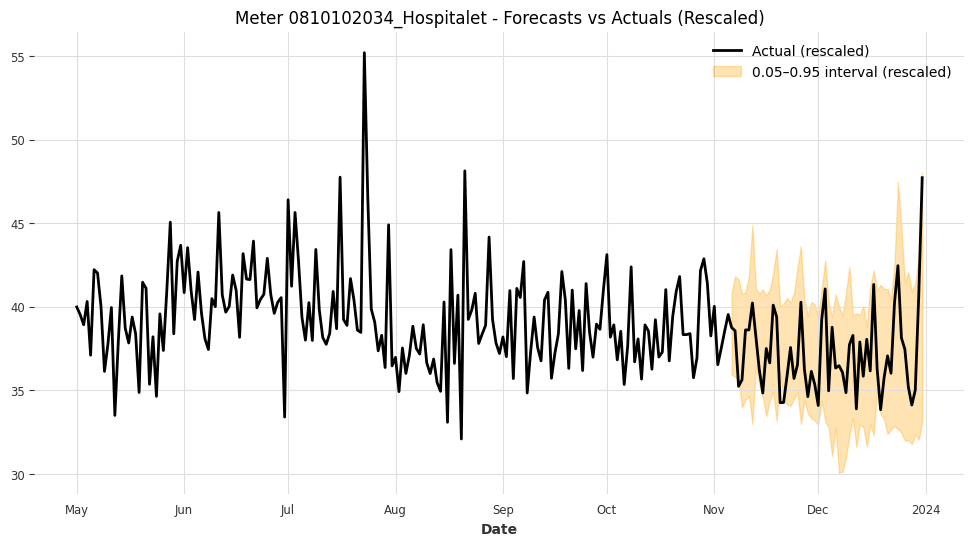

Meter 0810102034_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 7.9721



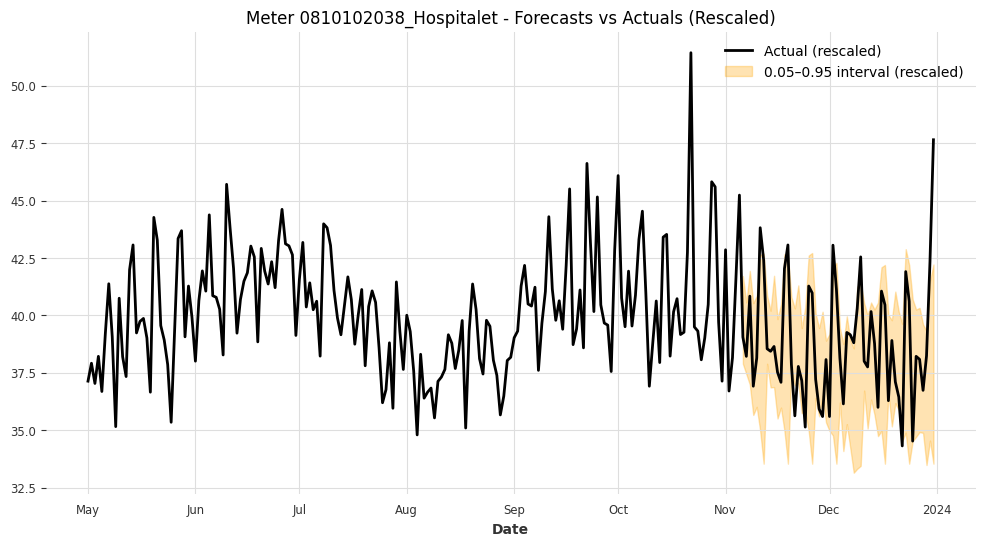

Meter 0810102038_Hospitalet - Coverage: 0.7679, Mean Interval Width (rescaled): 5.4638



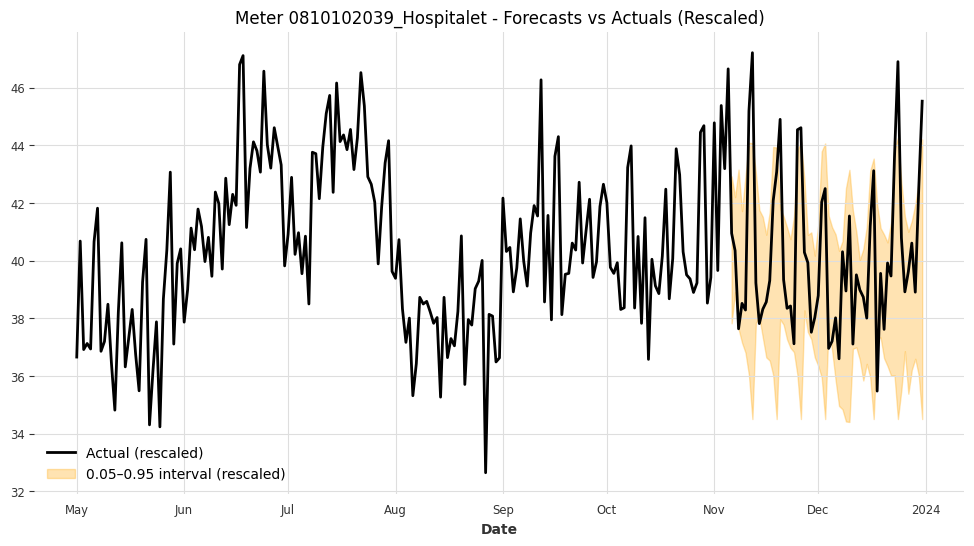

Meter 0810102039_Hospitalet - Coverage: 0.8214, Mean Interval Width (rescaled): 5.7117



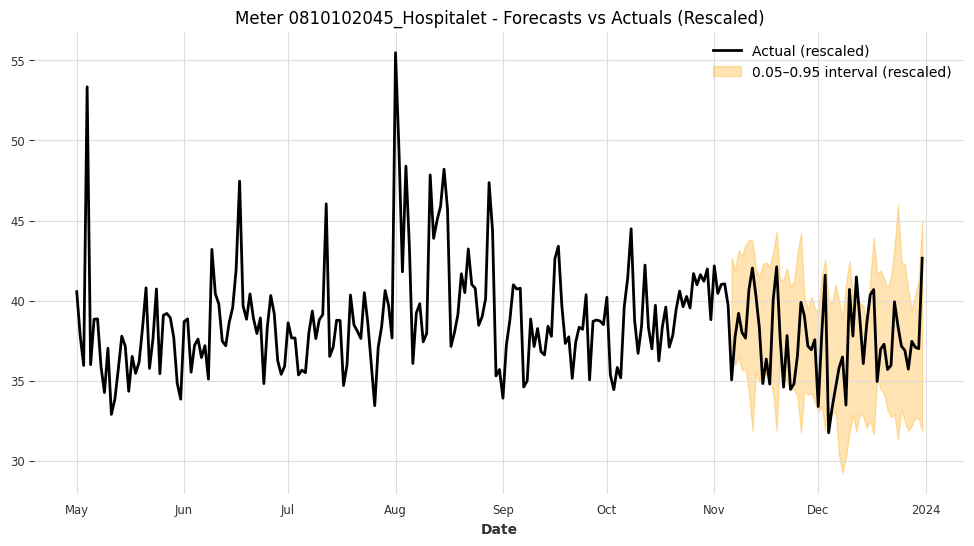

Meter 0810102045_Hospitalet - Coverage: 0.8393, Mean Interval Width (rescaled): 8.0884



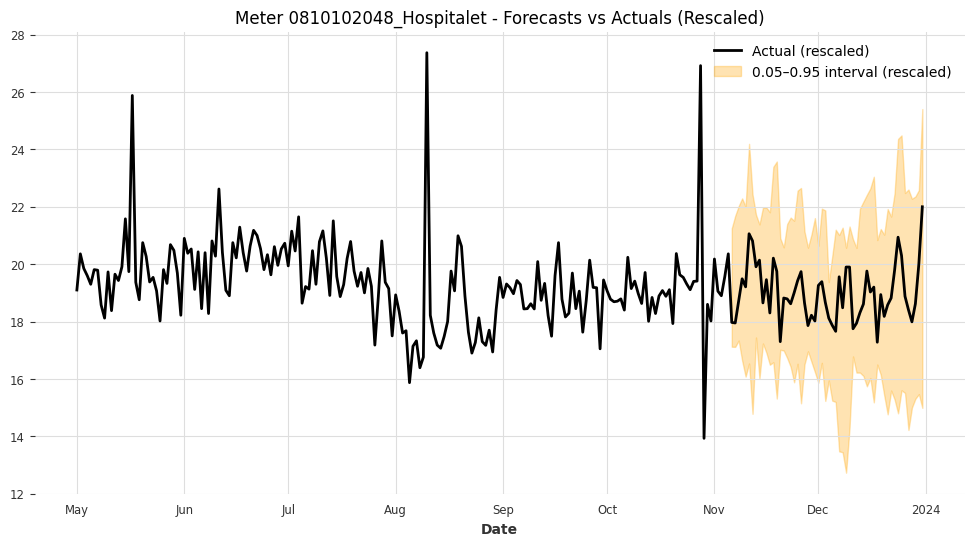

Meter 0810102048_Hospitalet - Coverage: 1.0000, Mean Interval Width (rescaled): 6.0457



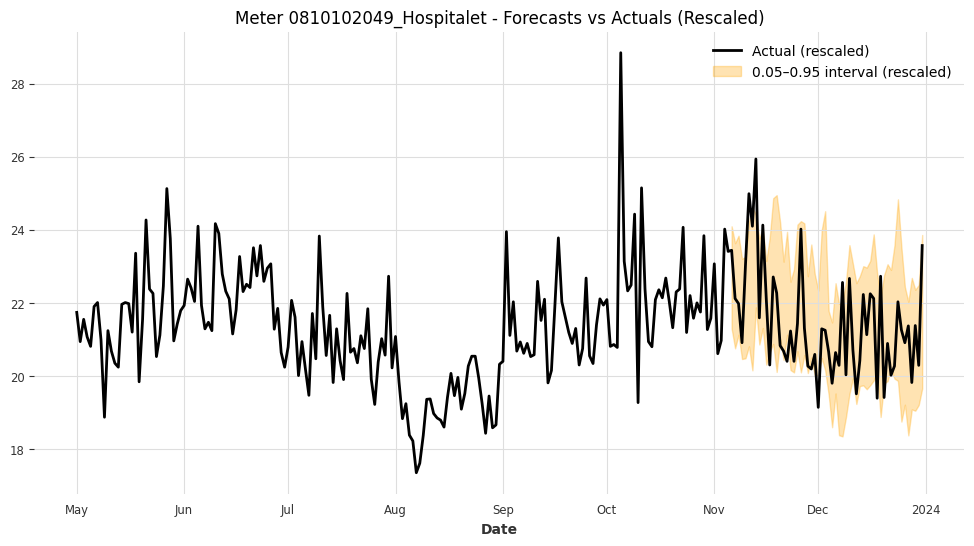

Meter 0810102049_Hospitalet - Coverage: 0.7679, Mean Interval Width (rescaled): 3.3006



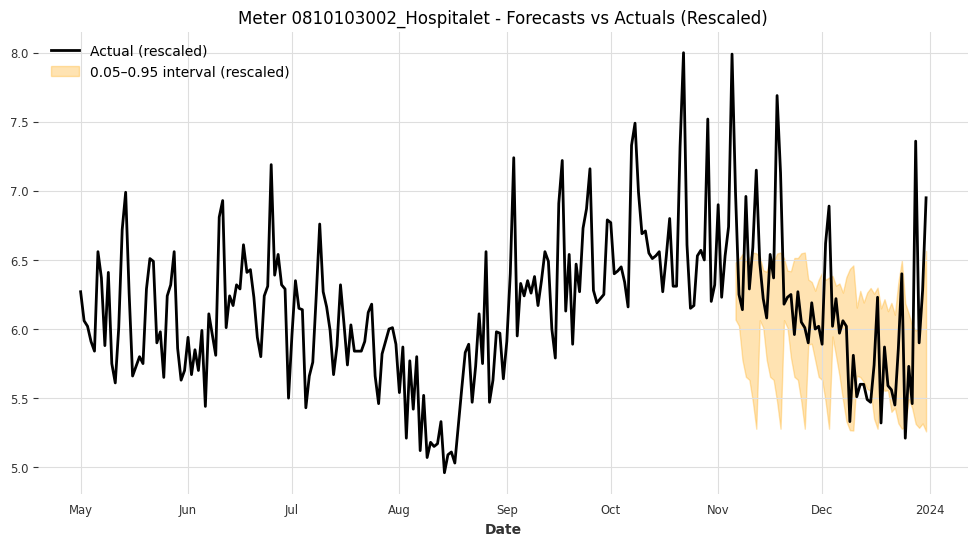

Meter 0810103002_Hospitalet - Coverage: 0.6607, Mean Interval Width (rescaled): 0.7825



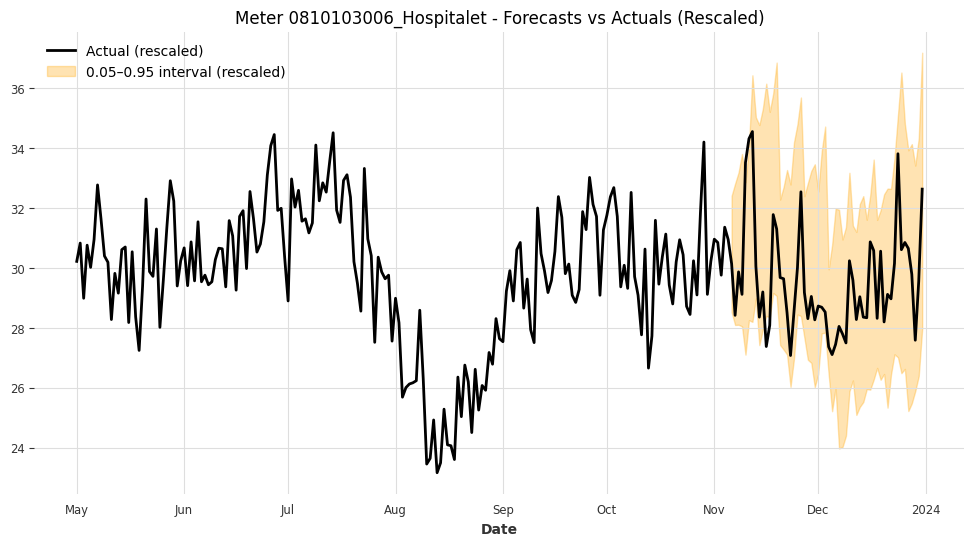

Meter 0810103006_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 6.6052



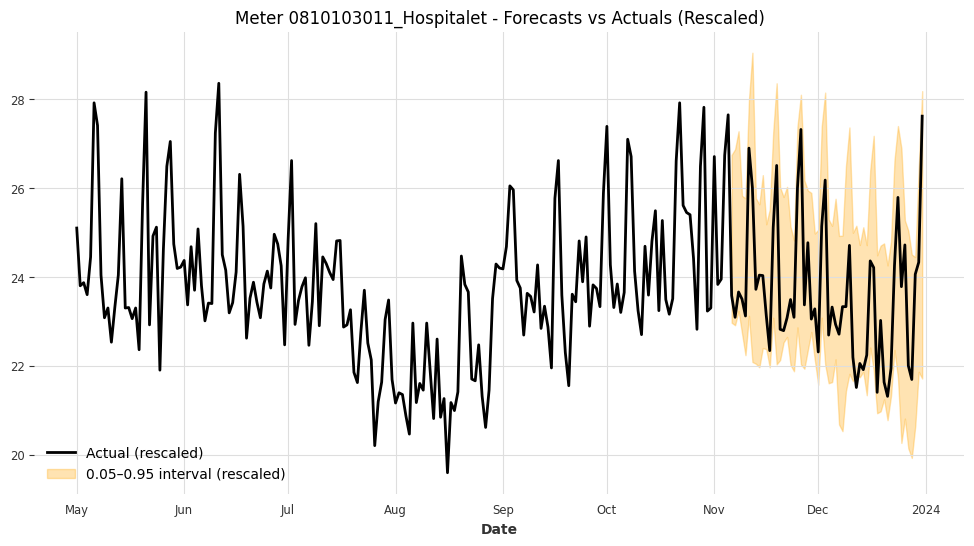

Meter 0810103011_Hospitalet - Coverage: 0.9821, Mean Interval Width (rescaled): 4.1450



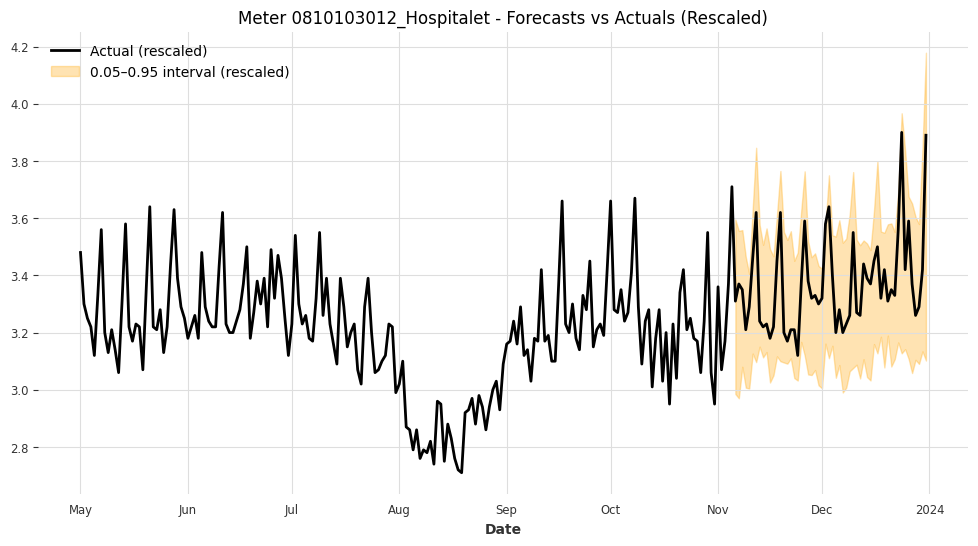

Meter 0810103012_Hospitalet - Coverage: 0.9821, Mean Interval Width (rescaled): 0.5134



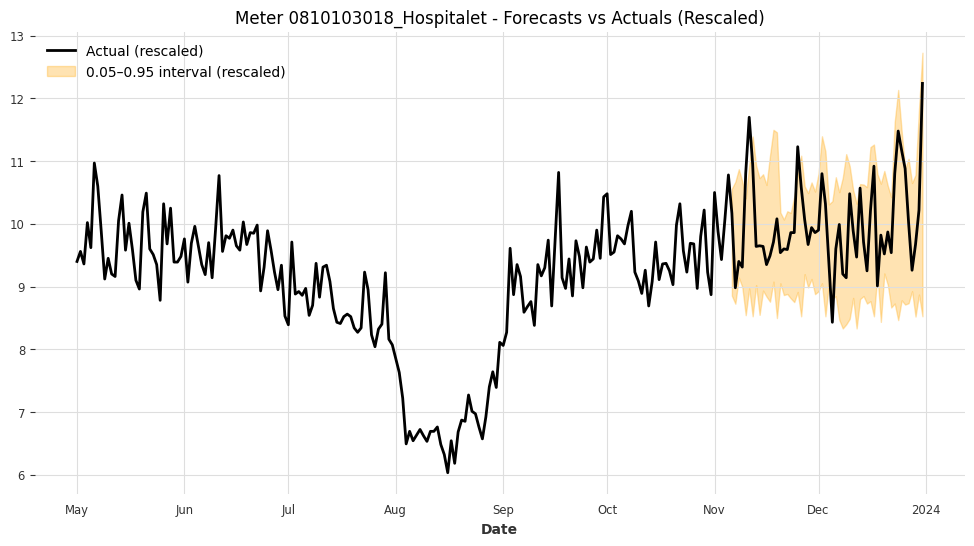

Meter 0810103018_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 2.0641



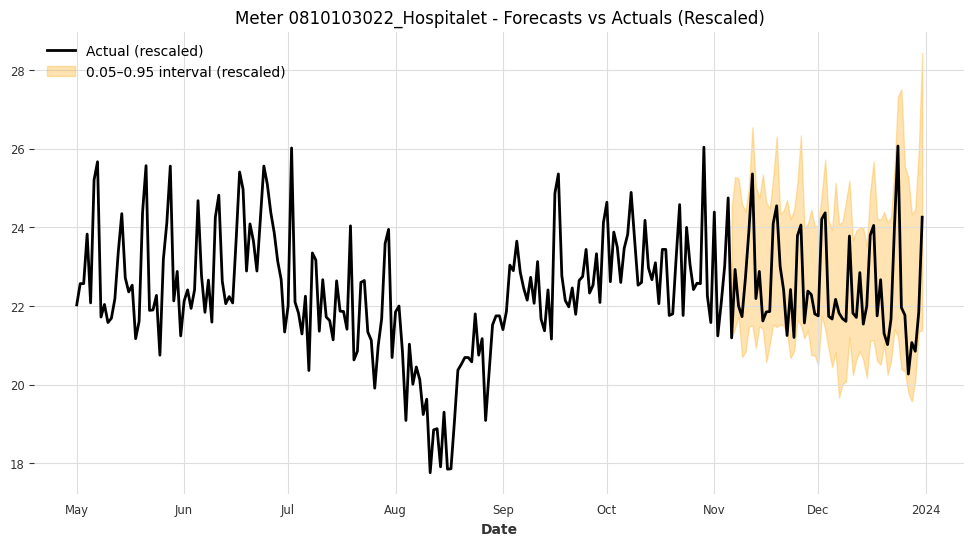

Meter 0810103022_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 3.9675



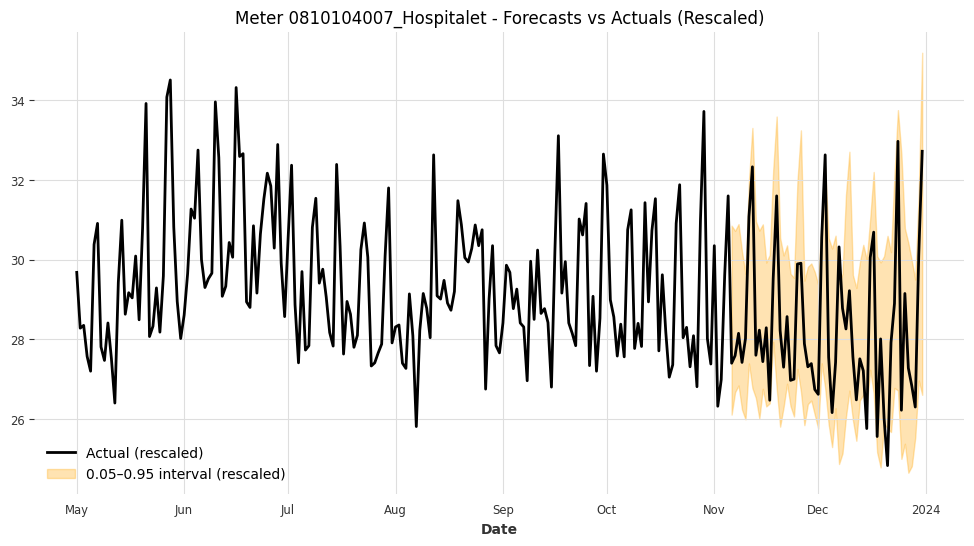

Meter 0810104007_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 4.6419



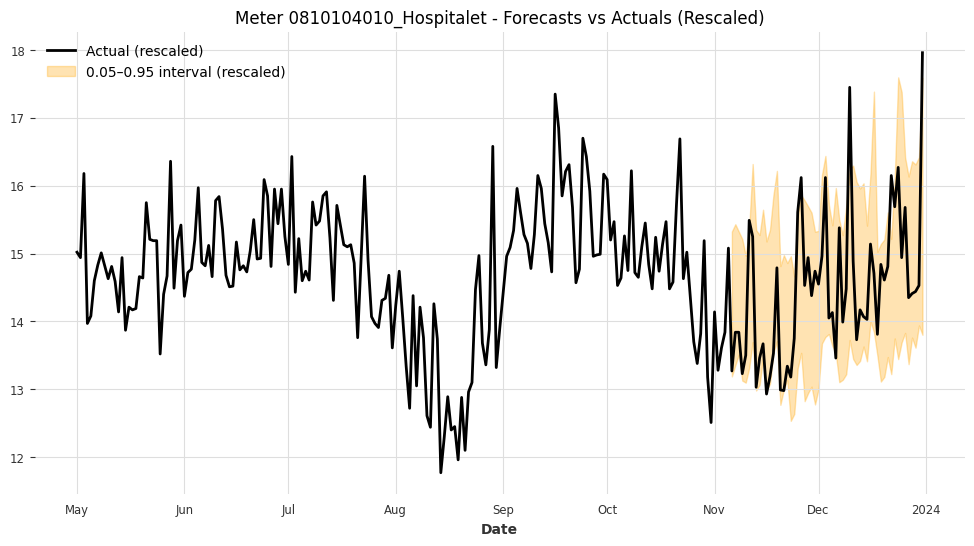

Meter 0810104010_Hospitalet - Coverage: 0.8214, Mean Interval Width (rescaled): 2.4022



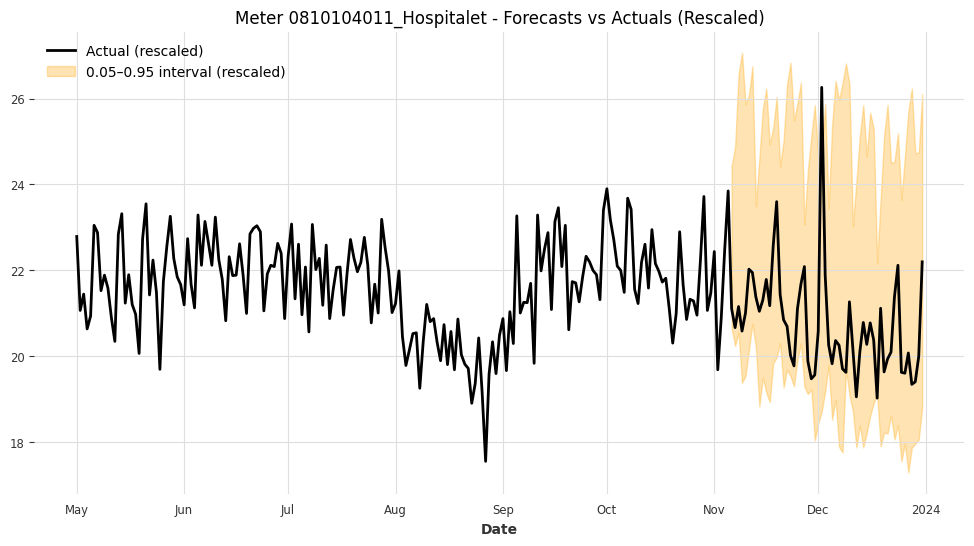

Meter 0810104011_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 6.2568



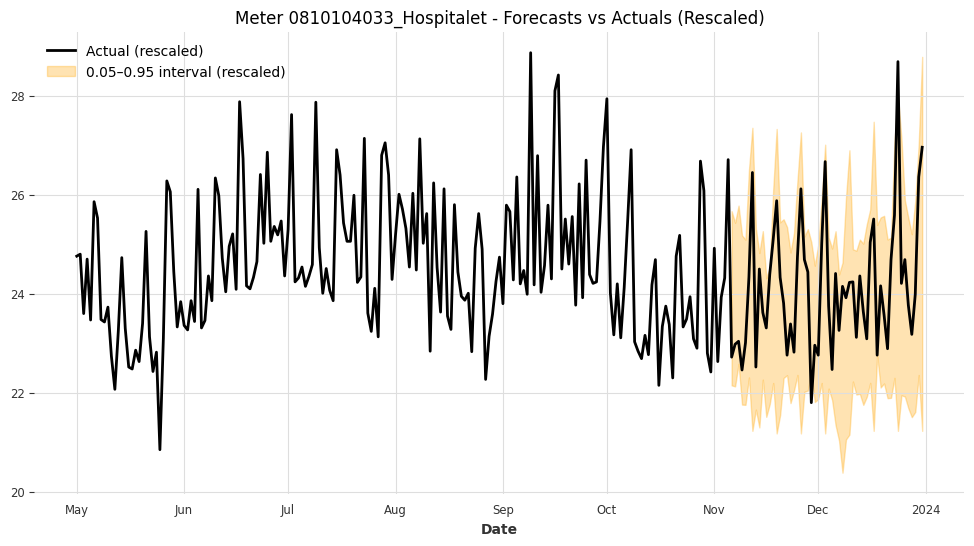

Meter 0810104033_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 3.8871



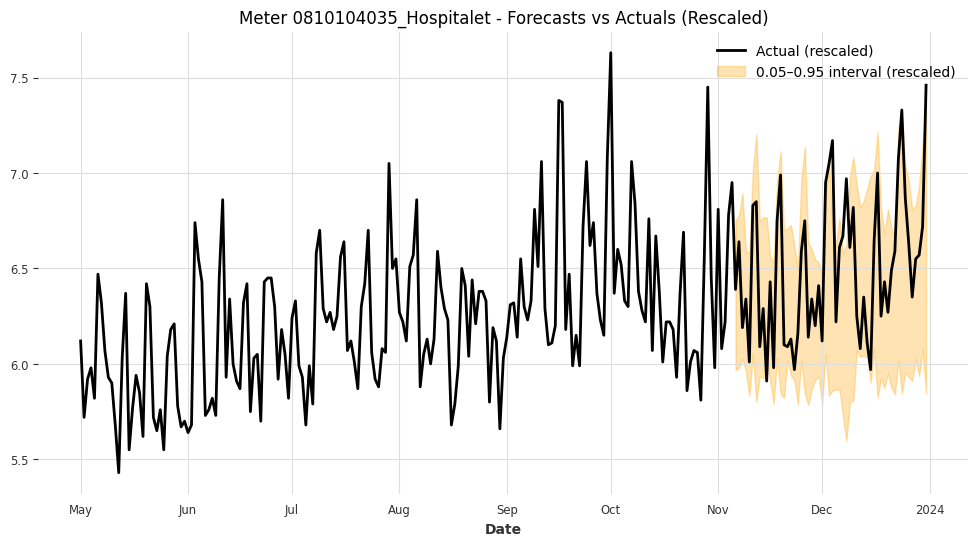

Meter 0810104035_Hospitalet - Coverage: 0.8750, Mean Interval Width (rescaled): 0.9223



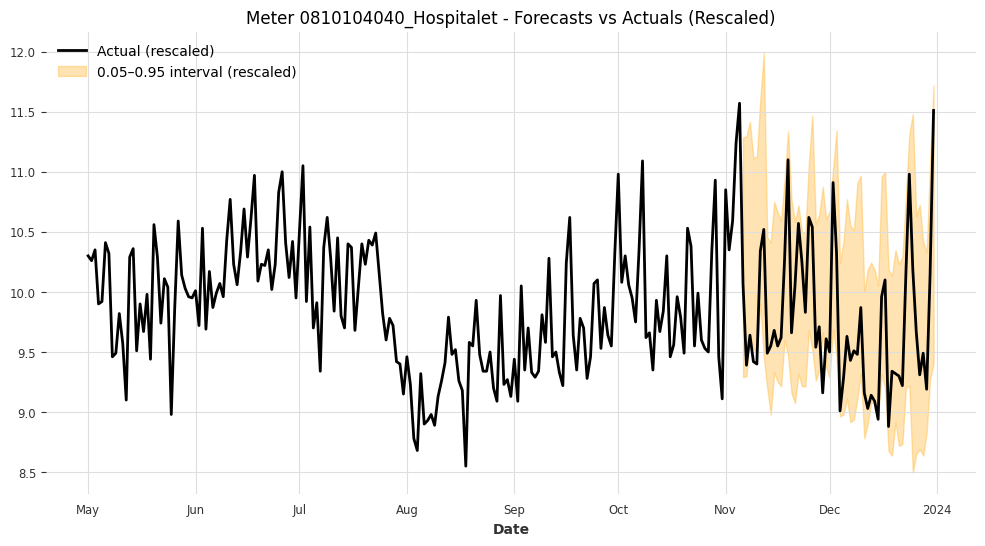

Meter 0810104040_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 1.5955



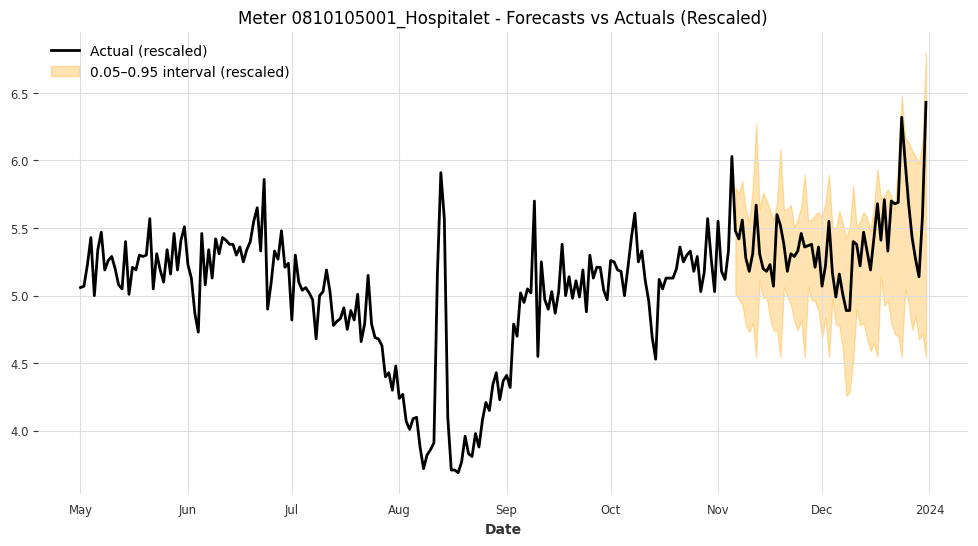

Meter 0810105001_Hospitalet - Coverage: 0.9821, Mean Interval Width (rescaled): 0.9714



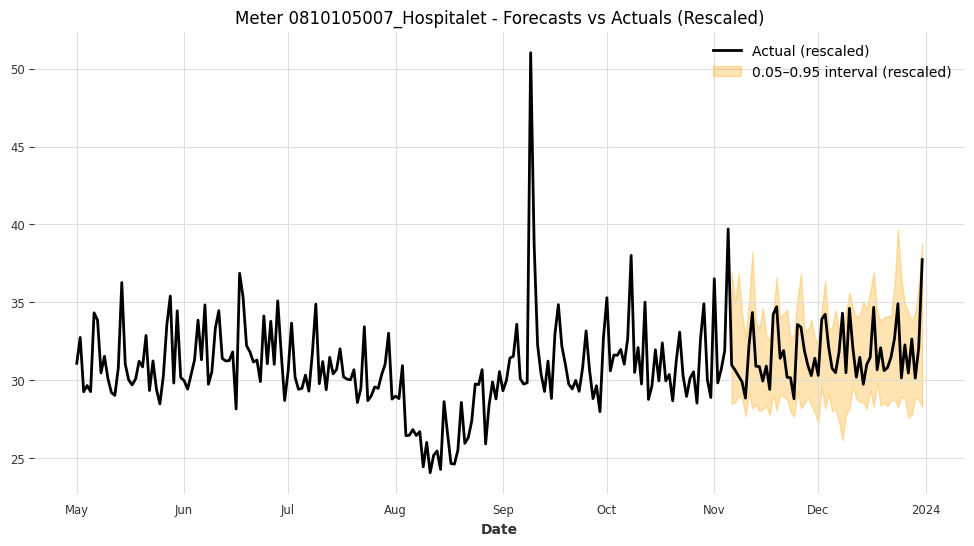

Meter 0810105007_Hospitalet - Coverage: 0.9821, Mean Interval Width (rescaled): 6.2455



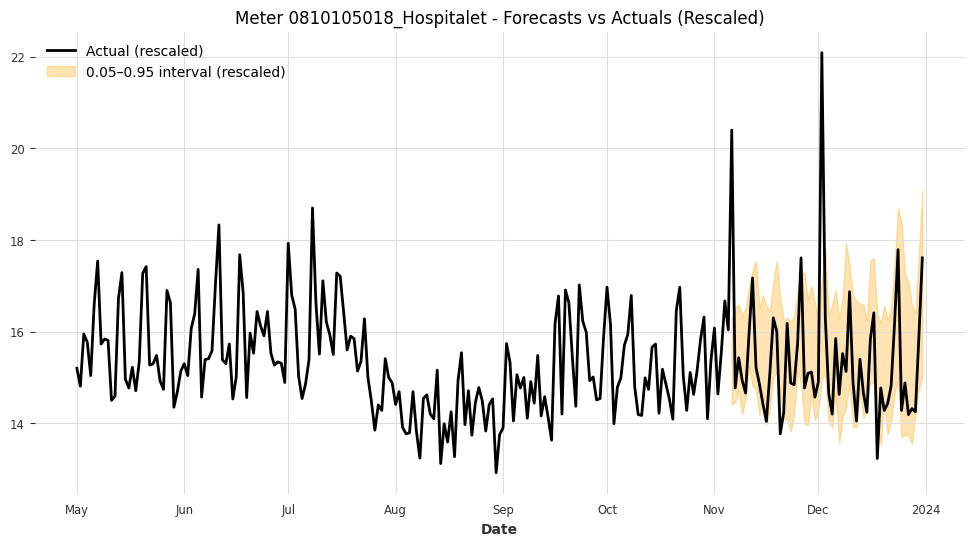

Meter 0810105018_Hospitalet - Coverage: 0.8571, Mean Interval Width (rescaled): 2.5378



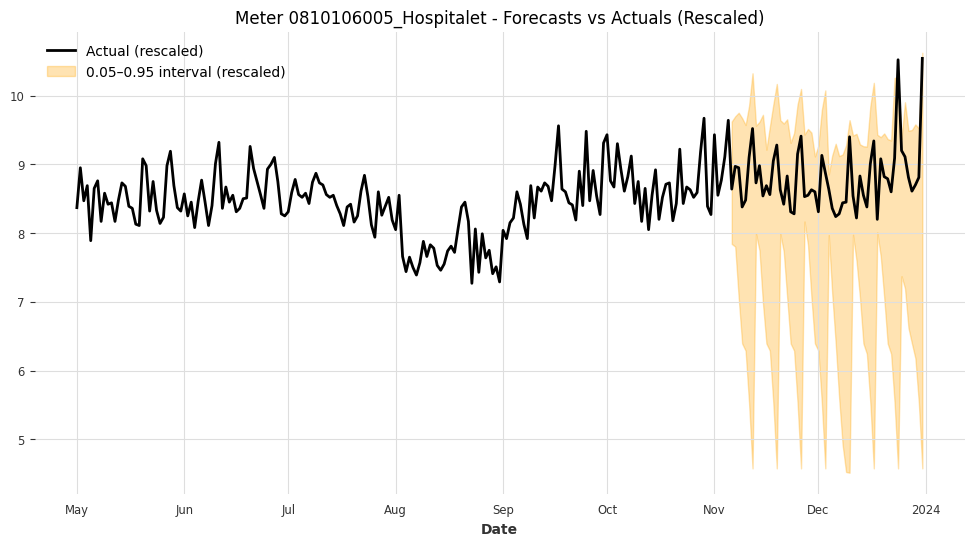

Meter 0810106005_Hospitalet - Coverage: 0.9821, Mean Interval Width (rescaled): 3.1934



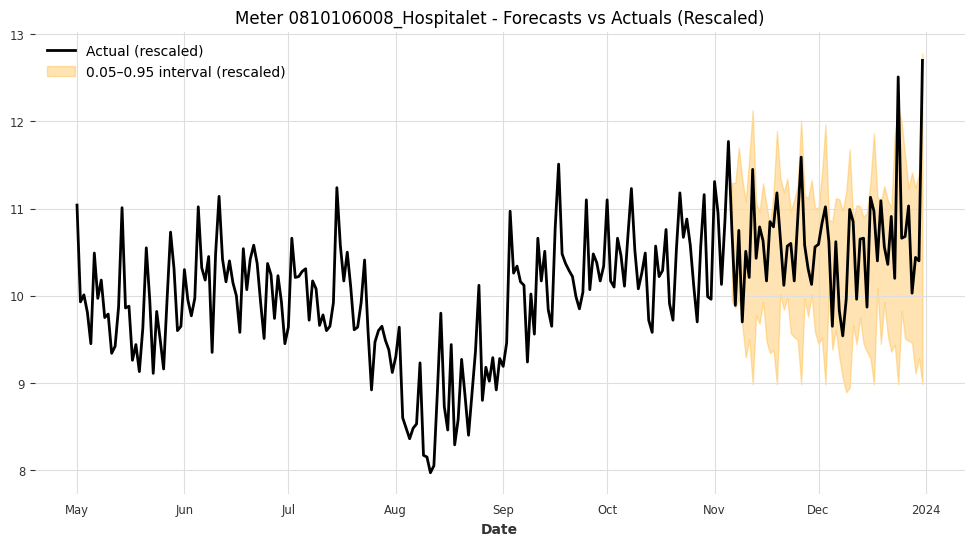

Meter 0810106008_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 1.8184



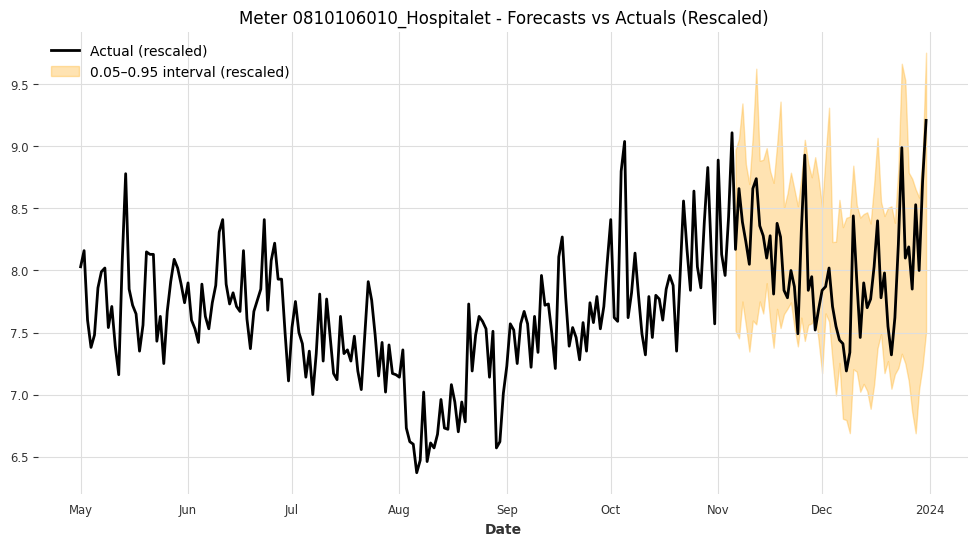

Meter 0810106010_Hospitalet - Coverage: 0.9821, Mean Interval Width (rescaled): 1.4480



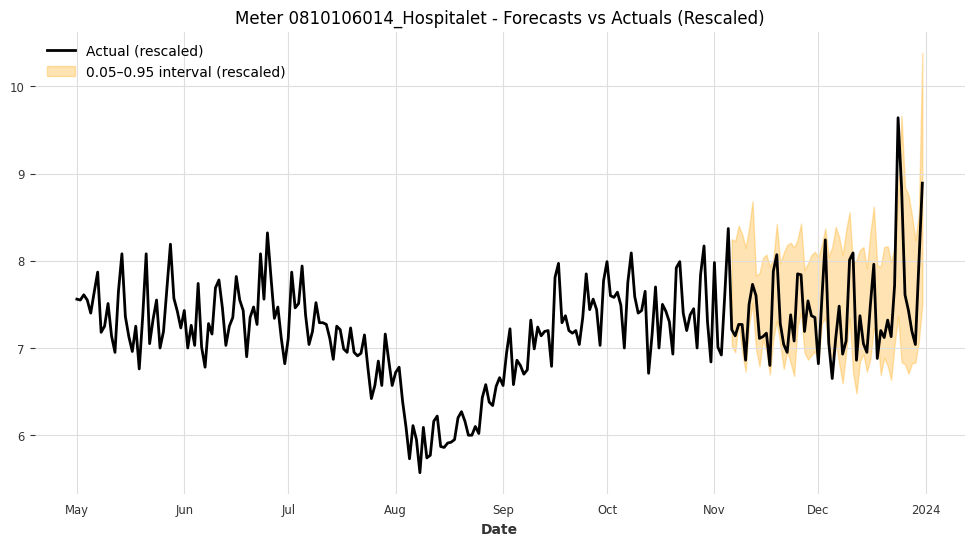

Meter 0810106014_Hospitalet - Coverage: 0.8750, Mean Interval Width (rescaled): 1.3052



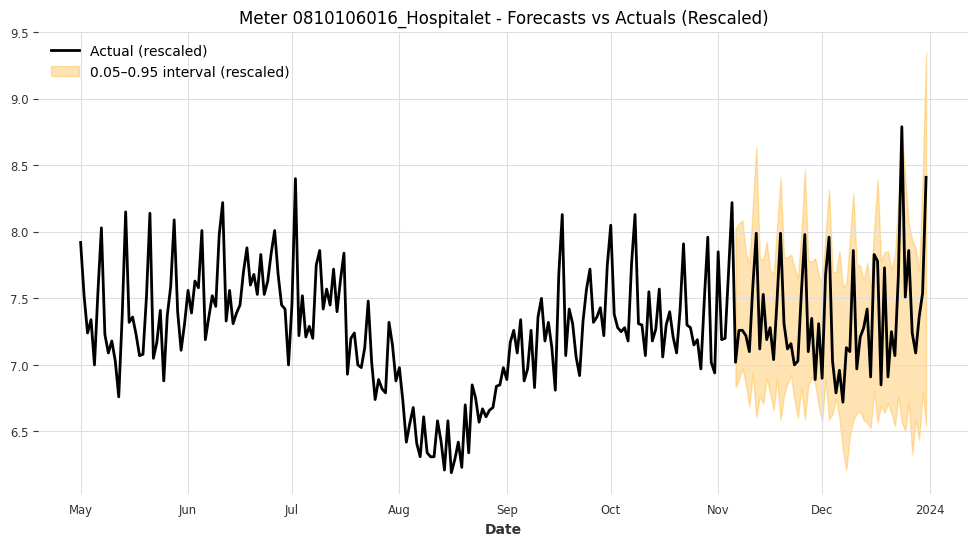

Meter 0810106016_Hospitalet - Coverage: 0.9821, Mean Interval Width (rescaled): 1.2749



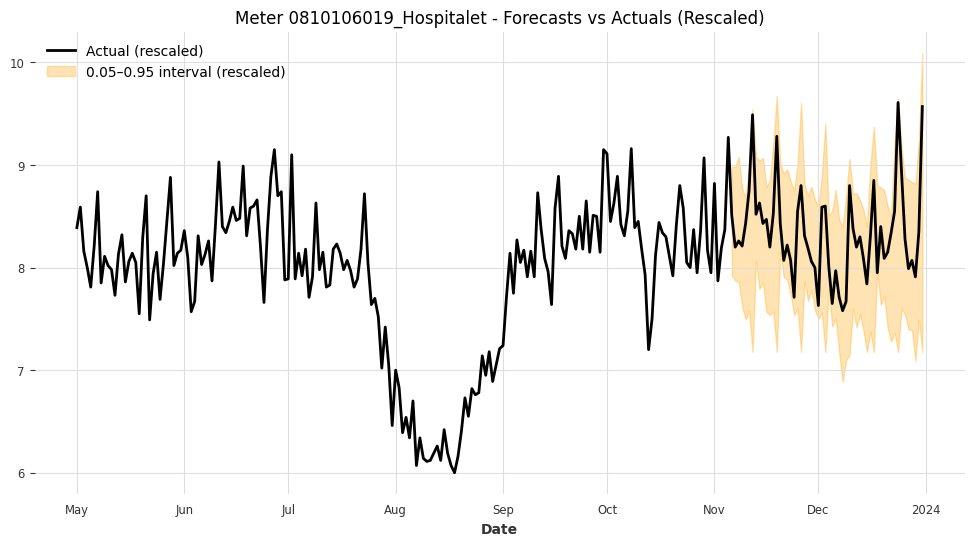

Meter 0810106019_Hospitalet - Coverage: 0.9821, Mean Interval Width (rescaled): 1.4038



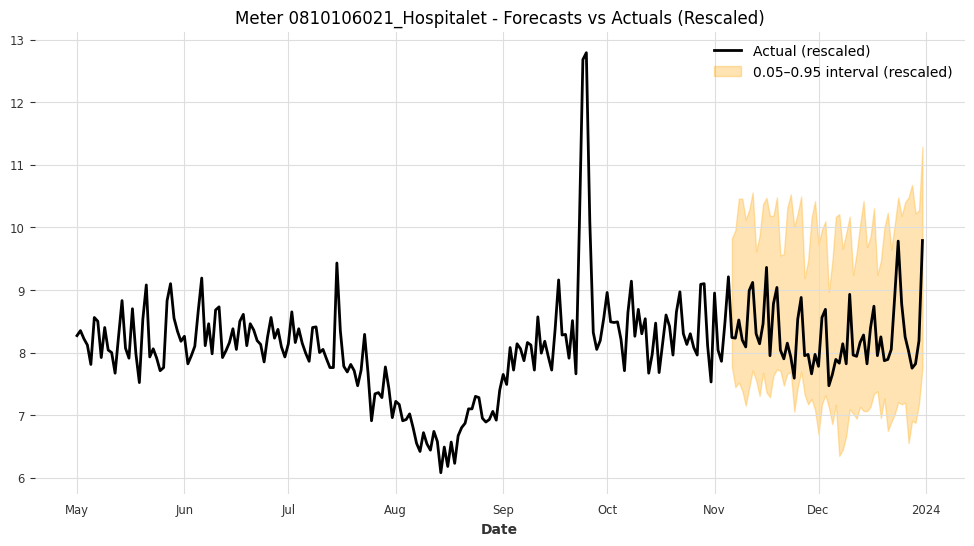

Meter 0810106021_Hospitalet - Coverage: 1.0000, Mean Interval Width (rescaled): 2.8317



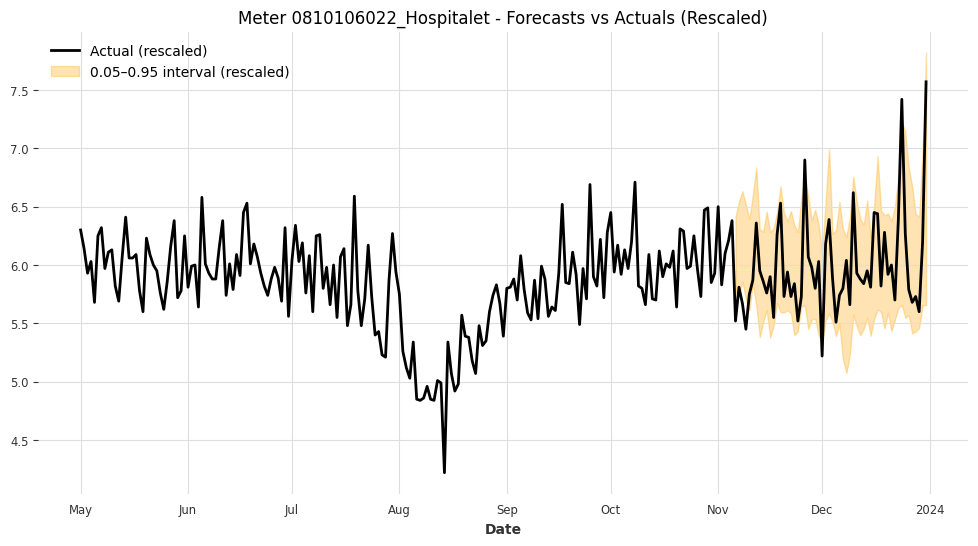

Meter 0810106022_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 1.0105



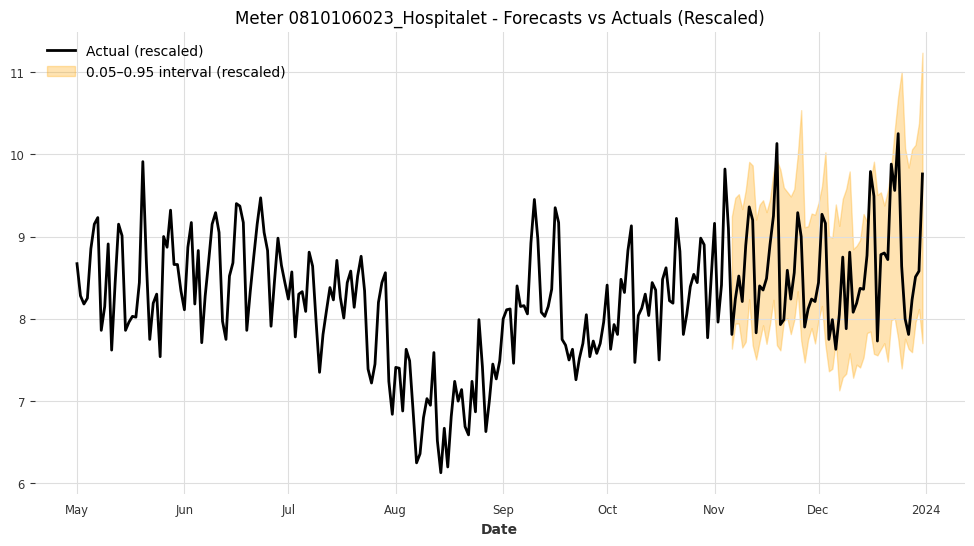

Meter 0810106023_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 1.9050



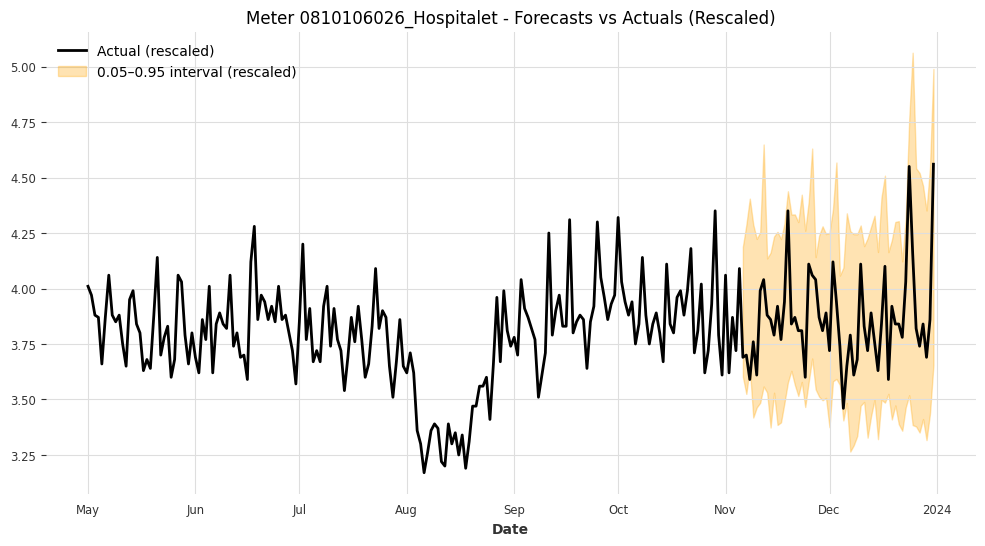

Meter 0810106026_Hospitalet - Coverage: 0.9821, Mean Interval Width (rescaled): 0.8663



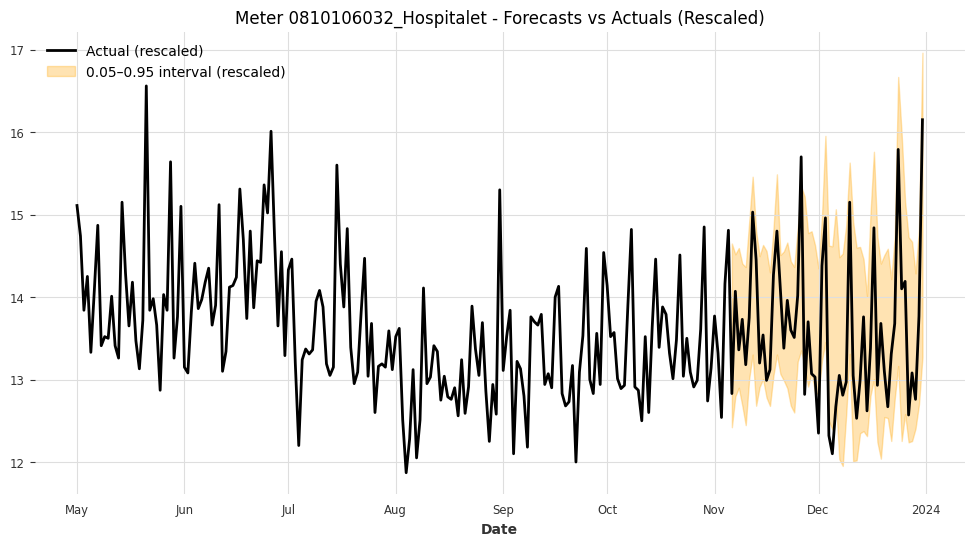

Meter 0810106032_Hospitalet - Coverage: 0.8750, Mean Interval Width (rescaled): 2.1257



In [ ]:
import matplotlib.pyplot as plt
from darts import concatenate  # We use this to merge forecast segments

for meter_id, hfcs in all_hfcs.items():
    # Get actual series (scaled)
    ts = scaled_calib_test_series[meter_id]

    # Get scaler and results
    scaler = scalers_test[meter_id]
    df_result = all_bt_results[meter_id]
    coverage = df_result["Coverage"].iloc[0]
    width_orig = df_result["Width"].iloc[0]

    # Start plot
    fig, ax = plt.subplots(figsize=(12, 6))

    # Plot actuals (rescaled)
    ts_orig = scaler.inverse_transform(ts)
    ts_orig.plot(ax=ax, label='Actual (rescaled)', lw=2)

    # Collect rescaled quantiles
    full_lower = []
    full_upper = []

    for forecast in hfcs:
        if ('Consumption per meter_q0.05' in forecast.components and
            'Consumption per meter_q0.95' in forecast.components):

            lower = forecast['Consumption per meter_q0.05']
            upper = forecast['Consumption per meter_q0.95']
            lower_orig = scaler.inverse_transform(lower)
            upper_orig = scaler.inverse_transform(upper)
            full_lower.append(lower_orig)
            full_upper.append(upper_orig)

    # Plot interval if available
    if full_lower and full_upper:
        combined_lower = concatenate(full_lower)
        combined_upper = concatenate(full_upper)

        ax.fill_between(
            combined_lower.time_index,
            combined_lower.values().flatten(),
            combined_upper.values().flatten(),
            color='orange',
            alpha=0.3,
            label='0.05–0.95 interval (rescaled)'
        )

    # Finalize plot
    ax.set_title(f"Meter {meter_id} - Forecasts vs Actuals (Rescaled)")
    ax.legend()
    plt.show()

    # Show metrics
    print(f"Meter {meter_id} - Coverage: {coverage:.4f}, Mean Interval Width (rescaled): {width_orig:.4f}\n")
